# Summary
This is a general summary.
1. Assess the general characteristics of the dataset


*   [How many records do we have? How many variables?](#shape)
*   [What are the variable names? Are they meaningful?](#columns)
*   [What type is each variable](#schema)
*   [How many unique values does each variable have?](#unique)
*   [What value occurs most frequently, and how often does it occur?](#frequent)
*   [Are there missing observations (vertically and horrizontally)? If so, how frequently does this occur?](#na)
** [Num of Missing values by columns](#na_col)
** [Num of Missing values by rows](#na_row)
** [Decision on droping missing values](#na_drop)
<br/>
2. Examine descriptive statistics for each variable<br/>
For categorical variables, answer the main questions like:
* [How many distinct values or “levels” does the variable exhibit](#dist_cat)
* [How often does each of these levels occur in the dataset?](#cat_level)
* [How does the behavior of another variable X vary over the levels of C?](#behavior)<br/>
<br/>
For numerical variable, answer the main questions like:
* [What is the mean, median, standard deviation?](#numsummary)
* [Does the data follow the normal distribution?](#normality)
** [Shapiro-Wilk Test](#shapiro)

3. Where possible—certainly for any variable of particular interest—examine exploratory
visualizations and identify anomalies
* [Box plot](#boxplot)
* [Num of Outliers](#outliers)
* [Bar charts](#barchart)
4. Look at the relations between key variables using the ideas of visualization and statistical tests
* [Correlation Matrix](#corr)
* [Point Plots](#pointplot)
* [Continues Variables Normalization](#norm)
** [Log Transformation Method](#log_trans)
** [L2 Normalization](#l2)
** [BoxCox method](#boxcox)
** [Min-Max Method](#minmax)
<br/>
* Statistical Tests
** [Continuous Variables](#contvar)
** [Ordinal Variables](#ordinal)
** [Binary Variables](#binary)
** [Summary Table](#summary)

# Packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import chi2_contingency
from scipy.stats import ttest_ind
from scipy.stats import boxcox
import statsmodels.api as sm
from sklearn.preprocessing import MinMaxScaler

In [2]:
# prompt: mount google drive

# from google.colab import drive
# drive.mount('/content/drive')


### Setting

In [3]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Data Set

### Load dataset

In [4]:
df = pd.read_csv("/content/filtered_data.csv")
df_schema = pd.read_csv('/content/schema.csv')

### Data Exploration

<a name='shape'>There are 18,883 records and 70 variables in the dataset.<a>

In [5]:
# number of records and variables
df.shape

(18883, 70)

#### Schema

<a name='columns'> All columns' name, category, data type are listed below:

In [6]:
# variable names
df.columns

Index(['Hospital Mortality', 'Age', 'Gender', 'Uncomplicated Hypertension',
       'Complicated Hypertension', 'Uncomplicated Diabetes',
       'Complicated Diabetes', 'Malignancy', 'Hematologic Disease',
       'Metastasis', 'Peripheral Vascular Disease', 'Hypothyroidism',
       'Chronic Heart Failure', 'Stroke', 'Liver Disease', 'SAPS II', 'SOFA',
       'OASIS', 'Sepsis', 'Any Organ Failure', 'Severe Respiratory Failure',
       'Severe Coagulation Failure', 'Severe Liver Failure',
       'Severe Cardiovascular Failure',
       'Severe Central Nervous System Failure', 'Severe Renal Failure',
       'Respiratory Dysfunction', 'Cardiovascular Dysfunction',
       'Renal Dysfunction', 'Hematologic Dysfunction', 'Metabolic Dysfunction',
       'Neurologic Dysfunction', 'Max Heart Rate', 'Min Heart Rate',
       'Mean Heart Rate', 'Max MAP', 'Min MAP', 'Mean MAP',
       'Max Systolic Pressure', 'Min Systolic Pressure',
       'Mean Systolic Pressure', 'Max Diastolic Pressure',
       '

<a name='schema'> Type of each variable <a>

In [7]:
#Check the data types if correct
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18883 entries, 0 to 18882
Data columns (total 70 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Hospital Mortality                     18883 non-null  int64  
 1   Age                                    18883 non-null  int64  
 2   Gender                                 18883 non-null  object 
 3   Uncomplicated Hypertension             18883 non-null  int64  
 4   Complicated Hypertension               18883 non-null  int64  
 5   Uncomplicated Diabetes                 18883 non-null  int64  
 6   Complicated Diabetes                   18883 non-null  int64  
 7   Malignancy                             18883 non-null  int64  
 8   Hematologic Disease                    18883 non-null  int64  
 9   Metastasis                             18883 non-null  int64  
 10  Peripheral Vascular Disease            18883 non-null  int64  
 11  Hy

In [8]:
df_schema.set_index('variable_name', inplace=True)
df_schema

,category,variable_type
variable_name,,
Hospital Mortality,Target,binary
Age,Demographic,continuous
Gender,Demographic,binary
Uncomplicated Hypertension,Medical history,binary
Complicated Hypertension,Medical history,binary
Uncomplicated Diabetes,Medical history,binary
Complicated Diabetes,Medical history,binary
Malignancy,Medical history,binary
Hematologic Disease,Medical history,binary


###### Schema Visualizations

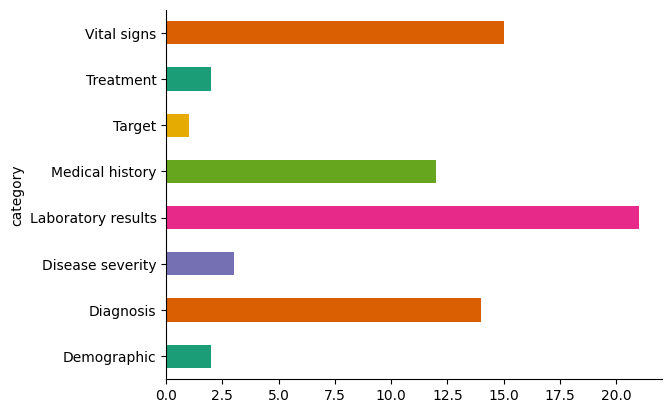

In [9]:
df_schema.groupby('category').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)


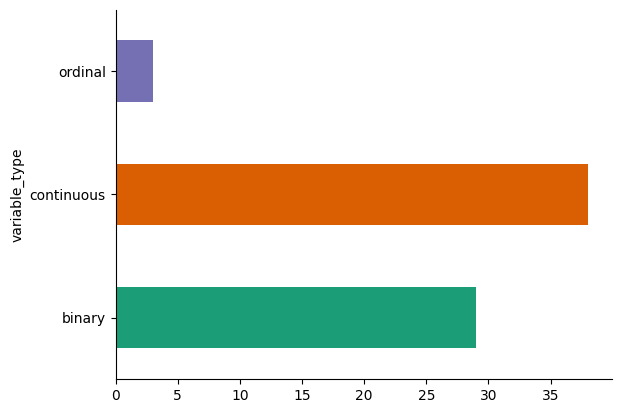

In [10]:
df_schema.groupby('variable_type').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

#### Unique Values

<a name='unique'>The number of unique values per variable are shown below<a>

In [11]:
# number of unique values per variable
df.nunique()

Hospital Mortality                           2
Age                                         72
Gender                                       2
Uncomplicated Hypertension                   2
Complicated Hypertension                     2
Uncomplicated Diabetes                       2
Complicated Diabetes                         2
Malignancy                                   2
Hematologic Disease                          2
Metastasis                                   2
Peripheral Vascular Disease                  2
Hypothyroidism                               2
Chronic Heart Failure                        2
Stroke                                       2
Liver Disease                                2
SAPS II                                    107
SOFA                                        23
OASIS                                       64
Sepsis                                       2
Any Organ Failure                            2
Severe Respiratory Failure                   2
Severe Coagul

#### Most frequent value <a name='frequent'>

Most Frequently occuring value per variable

In [12]:
# most frequently occuring value and the count
most_frequent_values = {}
for column in df.columns:
    most_common = df[column].value_counts().idxmax()
    count = df[column].value_counts().max()
    most_frequent_values[column] = {'value': most_common, 'count': count}

# DataFrame from the dictionary
result_df = pd.DataFrame(most_frequent_values).T

print(result_df)

                                           value   count
Hospital Mortality                             0   15866
Age                                           77     504
Gender                                         M   11457
Uncomplicated Hypertension                     0   10123
Complicated Hypertension                       0   17418
Uncomplicated Diabetes                         0   14980
Complicated Diabetes                           0   17924
Malignancy                                     0   16871
Hematologic Disease                            0   16070
Metastasis                                     0   18055
Peripheral Vascular Disease                    0   17244
Hypothyroidism                                 0   17307
Chronic Heart Failure                          0   14348
Stroke                                         0   17825
Liver Disease                                  0   17085
SAPS II                                       34     692
SOFA                           

### Data set Motification

#### Find missing values <a name='na'>

##### Num of missing values by columns <a name='na_col'>

In [13]:
# missing values column-wise
na_count = df.isnull().sum() # total count
na_pct = (na_count/len(df))*100 # percentage

na_df = pd.DataFrame({'Count': na_count.values,
                      'Percentage (%)': na_pct}).reset_index().rename(columns = {'index': 'Feature'})

na_df.sort_values(by='Percentage (%)', ascending=False)

,Feature,Count,Percentage (%)
49,Mean Lactate,5101,27.013716
48,Min Lactate,5101,27.013716
47,Max Lactate,5101,27.013716
50,Max pH,1173,6.211937
51,Min pH,1173,6.211937
52,Mean pH,1173,6.211937
44,Max Temperature,687,3.638193
45,Min Temperature,687,3.638193
46,Mean Temperature,687,3.638193
68,Ventilation Duration (h),497,2.631997


##### Num of missing values by rows <a name='na_row'>

In [14]:
temp_df = df.copy()
# Calculate missing values by row
missing_values_by_row = df.isnull().sum(axis=1)

# Add the missing values count to the original DataFrame
temp_df["MissingValuesCount"] = missing_values_by_row

total_rows = len(temp_df)
temp_df["MissingValuesPercentage"] = (temp_df["MissingValuesCount"] / total_rows) * 100

# Sort the DataFrame by the "MissingValuesCount" column in descending order
df_sorted = temp_df.sort_values(by="MissingValuesPercentage", ascending=False)

# Print the sorted DataFrame
print(df_sorted[['MissingValuesCount','MissingValuesPercentage']].head(100))

       MissingValuesCount  MissingValuesPercentage
6766                   36                 0.190648
11565                  36                 0.190648
960                    36                 0.190648
6480                   36                 0.190648
8888                   27                 0.142986
8750                   25                 0.132394
1794                   24                 0.127098
4749                   24                 0.127098
4900                   24                 0.127098
13876                  24                 0.127098
13534                  24                 0.127098
10804                  24                 0.127098
4171                   24                 0.127098
1682                   22                 0.116507
4219                   22                 0.116507
1509                   22                 0.116507
8097                   22                 0.116507
11525                  22                 0.116507
15573                  22      

##### Visualize the missing values

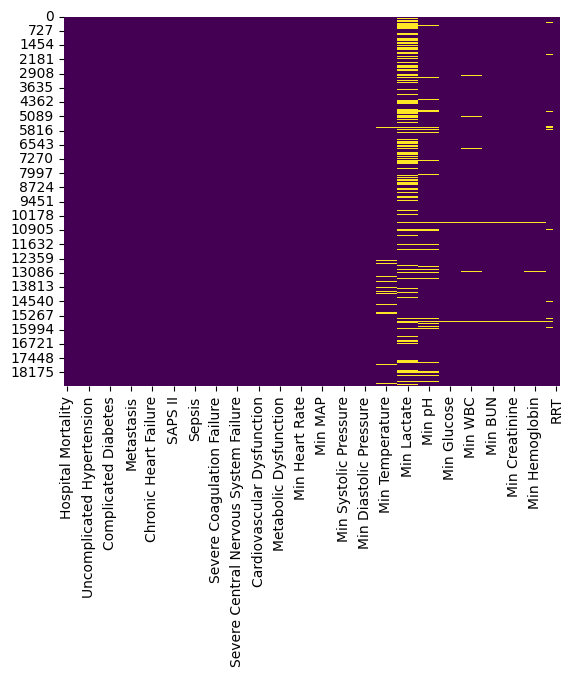

In [15]:
# heatmap
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')
plt.show()

#### Removing Missing values <a name='na_drop'>

In [16]:
before_clear_mv = df.shape
print(f'Before clean missing values, the dataset has {before_clear_mv[0]} rows and {before_clear_mv[1]} variables')

Before clean missing values, the dataset has 18883 rows and 70 variables


In [17]:
# drop the columns RRT and Ventilation Duration (h) in df
df_orig = df.copy()
df = df.drop(['RRT', 'Ventilation Duration (h)'], axis=1)

In [18]:
def calculate_missing_percentages(df):
    df_copy = df.copy()  # Create a copy of the DataFrame
    missing_percentages = df_copy.isna().sum(axis=1) / len(df.columns) * 100
    missing_percentages = missing_percentages.round(2)

    # Create a new column to store the percentage of missing values
    df_copy['missing_percentage'] = missing_percentages

    # Group the DataFrame by the 'missing_percentage' column and count the number of observations in each group
    counts = df_copy.groupby('missing_percentage').size().reset_index(name='count')

    # Sort the table by percentage from highest to lowest
    counts = counts.sort_values(by='missing_percentage', ascending=False)

    # Print the table
    print(counts)

In [19]:
dem_f = df_schema[df_schema['category'] == 'Demographic'].index
medical_f = df_schema[df_schema['category'] == 'Medical history'].index
severe_f = df_schema[df_schema['category'] == 'Disease severity'].index
diag_f = df_schema[df_schema['category'] == 'Diagnosis'].index
vital_f = df_schema[df_schema['category'] == 'Vital signs'].index
lab_f = df_schema[df_schema['category'] == 'Laboratory results'].index

dem_df = df[dem_f]
medical_df = df[medical_f]
severe_df = df[severe_f]
diag_df = df[diag_f]
vital_df = df[vital_f]
lab_df = df[lab_f]


In [20]:
print('Demographic')
print(calculate_missing_percentages(dem_df))
print('-----------------------------')
print()
print('Medical history')
print(calculate_missing_percentages(medical_df))
print('-----------------------------')
print()
print('Disease severity')
print(calculate_missing_percentages(severe_df))
print('-----------------------------')
print()
print('Diagnosis')
print(calculate_missing_percentages(diag_df))
print('-----------------------------')
print()
print('Vital signs')
print(calculate_missing_percentages(vital_df))
print('-----------------------------')
print()
print('Laboratory results')
print(calculate_missing_percentages(lab_df))

Demographic
   missing_percentage  count
0                 0.0  18883
None
-----------------------------

Medical history
   missing_percentage  count
0                 0.0  18883
None
-----------------------------

Disease severity
   missing_percentage  count
0                 0.0  18883
None
-----------------------------

Diagnosis
   missing_percentage  count
0                 0.0  18883
None
-----------------------------

Vital signs
   missing_percentage  count
4               100.0     41
3                60.0      1
2                40.0     18
1                20.0    647
0                 0.0  18176
None
-----------------------------

Laboratory results
   missing_percentage  count
7              100.00     50
6               85.71      9
5               71.43      6
4               57.14     15
3               42.86     28
2               28.57    968
1               14.29   4345
0                0.00  13462
None


In [21]:
df.dropna(subset=['Max Heart Rate', 'Min Heart Rate', 'Mean Heart Rate',
                  'Max MAP', 'Min MAP', 'Mean MAP',
                  'Max Systolic Pressure', 'Min Systolic Pressure', 'Mean Systolic Pressure',
                  'Max Diastolic Pressure', 'Min Diastolic Pressure', 'Mean Diastolic Pressure',
                  'Max Temperature', 'Min Temperature', 'Mean Temperature'],
          inplace=True)

In [22]:
df.shape

(18176, 68)

In [23]:
df.dropna(subset=['Max Lactate', 'Min Lactate', 'Mean Lactate',
                    'Max pH', 'Min pH', 'Mean pH',
                    'Max Glucose', 'Min Glucose', 'Mean Glucose',
                    'Max WBC', 'Min WBC', 'Mean WBC',
                    'Max BUN', 'Min BUN', 'Mean BUN',
                    'Max Creatinine', 'Min Creatinine', 'Mean Creatinine',
                    'Max Hemoglobin', 'Min Hemoglobin', 'Mean Hemoglobin'],
          inplace=True)

In [24]:
after_clean_missing_values = df.shape

##### After Clear up missing values

In [25]:
print(f'Before clean missing values, the dataset has {before_clear_mv[0]} rows and {before_clear_mv[1]} variables')
print(f'After clean missing values, the dataset has {after_clean_missing_values[0]} rows and {after_clean_missing_values[1]} variables')

Before clean missing values, the dataset has 18883 rows and 70 variables
After clean missing values, the dataset has 12799 rows and 68 variables


##### Viz after clear up missing value

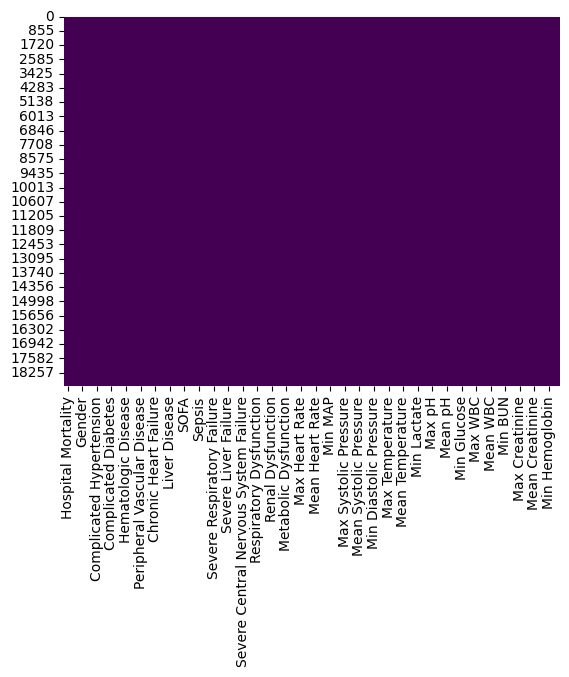

In [26]:
# heatmap
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')
plt.show()

#### Valid Range

Make sure all variables are within valid range

In [27]:
df = df.loc[
    ((df['Max Heart Rate'] >= 0) & (df['Max Heart Rate'] <= 350))
    & ((df['Min Heart Rate'] >= 0) & (df['Max Heart Rate'] <= 350))
    & ((df['Mean Heart Rate'] >= 0) & (df['Mean Heart Rate'] <= 350))
    & ((df['Max MAP']  >= 14) & (df['Max MAP'] <= 330))
    & ((df['Min MAP']  >= 14) & (df['Min MAP'] <= 330))
    & ((df['Mean MAP']  >= 14) & (df['Mean MAP'] <= 330))
    & ((df['Min Systolic Pressure'] >= 0) & (df['Min Systolic Pressure'] <= 375))
    & ((df['Max Systolic Pressure'] >= 0) & (df['Max Systolic Pressure'] <= 375))
    & ((df['Mean Systolic Pressure'] >= 0) & (df['Mean Systolic Pressure'] <= 375))
    & ((df['Min Diastolic Pressure'] >= 0) & (df['Min Diastolic Pressure'] <= 375))
    & ((df['Max Diastolic Pressure'] >= 0) & (df['Max Diastolic Pressure'] <= 375))
    & ((df['Mean Diastolic Pressure'] >= 0) & (df['Mean Diastolic Pressure'] <= 375))
    & ((df['Min Temperature'] >= 26)& (df['Min Temperature'] <= 45))
    & ((df['Max Temperature'] >= 26)& (df['Max Temperature'] <= 45))
    & ((df['Mean Temperature'] >= 26)& (df['Mean Temperature'] <= 45))
    & ((df['Min pH']  >= 0)& (df['Min pH'] <= 14))
    & ((df['Max pH']  >= 0)& (df['Max pH'] <= 14))
    & ((df['Mean pH']  >= 0)& (df['Mean pH'] <= 14))
    & ((df['Min Lactate']  >= 0.4)& (df['Min Lactate'] <= 30))
    & ((df['Max Lactate']  >= 0.4)& (df['Max Lactate'] <= 30))
    & ((df['Mean Lactate']  >= 0.4)& (df['Mean Lactate'] <= 30))
    & ((df['Min Glucose'] >= 33)& (df['Min Glucose'] <= 2000))
    & ((df['Max Glucose'] >= 33)& (df['Max Glucose'] <= 2000))
    & ((df['Mean Glucose'] >= 33)& (df['Mean Glucose'] <= 2000))
    & ((df['Min WBC'] >= 0)& (df['Min WBC'] <= 1000))
    & ((df['Max WBC'] >= 0)& (df['Max WBC'] <= 1000))
    & ((df['Mean WBC'] >= 0)& (df['Mean WBC'] <= 1000))
    & ((df['Min BUN'] >= 0)& (df['Min BUN'] <= 250))
    & ((df['Max BUN'] >= 0)& (df['Max BUN'] <= 250))
    & ((df['Mean BUN'] >= 0)& (df['Mean BUN'] <= 250))
    & ((df['Min Creatinine'] >= 0.1)& (df['Min Creatinine'] <= 60))
    & ((df['Max Creatinine'] >= 0.1)& (df['Max Creatinine'] <= 60))
    & ((df['Mean Creatinine'] >= 0.1)& (df['Mean Creatinine'] <= 60))
    & ((df['Min Hemoglobin'] >= 0) & (df['Min Hemoglobin'] <= 25))
    & ((df['Max Hemoglobin'] >= 0) & (df['Max Hemoglobin'] <= 25))
    & ((df['Mean Hemoglobin'] >= 0) & (df['Mean Hemoglobin'] <= 25))
]

In [28]:
print(df['Hospital Mortality'].value_counts())

0    10331
1     2158
Name: Hospital Mortality, dtype: int64


In [29]:
df.to_csv("/content/data_new.csv")

### Create subsets

In [30]:
cont_dem = df_schema[(df_schema['variable_type'] == 'continuous') & (df_schema['category'] == 'Demographic')].index
cont_vital = df_schema[(df_schema['variable_type'] == 'continuous') & (df_schema['category'] == 'Vital signs')].index
cont_lab = df_schema[
    (df_schema['variable_type'] == 'continuous')
    & (df_schema['category'] == 'Laboratory results')
    & df_schema.index.str.contains('Lactate|Crea|Hemog')
].index
cont_lab2 = df_schema[
    (df_schema['variable_type'] == 'continuous')
    & (df_schema['category'] == 'Laboratory results')
    & df_schema.index.str.contains('Glucose|WBC|BUN|pH')
].index
binary = df_schema[((df_schema['variable_type']=='binary') | (df_schema.index == 'Hospital Mortality')) & (df_schema.index != 'RRT')].index
ordinal = df_schema[((df_schema['variable_type'] == 'ordinal') | (df_schema.index == 'Hospital Mortality'))].index
cont_all = df_schema[((df_schema['variable_type'] == 'continuous') | (df_schema.index == 'Hospital Mortality')) & (df_schema['category'] != 'Treatment')].index

In [31]:
cont_dem_df = df[cont_dem]
cont_vital_df = df[cont_vital]
cont_lab_df = df[cont_lab]
cont_lab2_df = df[cont_lab2]
cont_all_df = df[cont_all]
binary_df = df[binary]
ordinal_df = df[ordinal]

### Categorical Variables

##### <a name='dist_cat'> Distinct Value in Categorical Variables

In [32]:
cat_feats = ['Hospital Mortality', 'Gender', 'Uncomplicated Hypertension',
       'Complicated Hypertension', 'Uncomplicated Diabetes',
       'Complicated Diabetes', 'Malignancy', 'Hematologic Disease',
       'Metastasis', 'Peripheral Vascular Disease', 'Hypothyroidism',
       'Chronic Heart Failure', 'Stroke', 'Liver Disease',
        'Sepsis', 'Any Organ Failure', 'Severe Respiratory Failure',
       'Severe Coagulation Failure', 'Severe Liver Failure',
       'Severe Cardiovascular Failure',
       'Severe Central Nervous System Failure', 'Severe Renal Failure',
       'Respiratory Dysfunction', 'Cardiovascular Dysfunction',
       'Renal Dysfunction', 'Hematologic Dysfunction', 'Metabolic Dysfunction',
       'Neurologic Dysfunction']
categorical_stats = df[cat_feats].apply(lambda x: x.nunique())
categorical_stats


Hospital Mortality                       2
Gender                                   2
Uncomplicated Hypertension               2
Complicated Hypertension                 2
Uncomplicated Diabetes                   2
Complicated Diabetes                     2
Malignancy                               2
Hematologic Disease                      2
Metastasis                               2
Peripheral Vascular Disease              2
Hypothyroidism                           2
Chronic Heart Failure                    2
Stroke                                   2
Liver Disease                            2
Sepsis                                   2
Any Organ Failure                        2
Severe Respiratory Failure               2
Severe Coagulation Failure               2
Severe Liver Failure                     2
Severe Cardiovascular Failure            2
Severe Central Nervous System Failure    2
Severe Renal Failure                     2
Respiratory Dysfunction                  2
Cardiovascu

In [33]:
print(f'There are total {len(cat_feats)} categorical variables')

There are total 28 categorical variables


##### Level of Categorical Variables <a name='cat_level'>

In [34]:
value_counts_all = df[cat_feats].apply(pd.Series.value_counts)
value_counts_all

,Hospital Mortality,Gender,Uncomplicated Hypertension,Complicated Hypertension,Uncomplicated Diabetes,Complicated Diabetes,Malignancy,Hematologic Disease,Metastasis,Peripheral Vascular Disease,Hypothyroidism,Chronic Heart Failure,Stroke,Liver Disease,Sepsis,Any Organ Failure,Severe Respiratory Failure,Severe Coagulation Failure,Severe Liver Failure,Severe Cardiovascular Failure,Severe Central Nervous System Failure,Severe Renal Failure,Respiratory Dysfunction,Cardiovascular Dysfunction,Renal Dysfunction,Hematologic Dysfunction,Metabolic Dysfunction,Neurologic Dysfunction
0,10331.0,NaN,7001.0,11427.0,10013.0,11821.0,11021.0,10430.0,11876.0,11448.0,11428.0,9504.0,11795.0,11151.0,10228.0,5462.0,11493.0,12408.0,12325.0,10650.0,11753.0,11803.0,8811.0,10485.0,8963.0,10995.0,10963.0,11245.0
1,2158.0,NaN,5488.0,1062.0,2476.0,668.0,1468.0,2059.0,613.0,1041.0,1061.0,2985.0,694.0,1338.0,2261.0,7027.0,996.0,81.0,164.0,1839.0,736.0,686.0,3678.0,2004.0,3526.0,1494.0,1526.0,1244.0
F,NaN,4891.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M,NaN,7598.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
df_cat = df[cat_feats]

# Count occurrences of 0 or 1 in each column
counts_0 = df_cat.apply(lambda x: x.isin([0]).sum())
counts_1 = df_cat.apply(lambda x: x.isin([1]).sum())

# Calculate percentage
percentages_0 = (counts_0 / len(df)) * 100
percentages_1 = (counts_1 / len(df)) * 100

perc_table = pd.DataFrame({'%0': percentages_0, '%1': percentages_1})

print(perc_table)

                                              %0         %1
Hospital Mortality                     82.720794  17.279206
Gender                                  0.000000   0.000000
Uncomplicated Hypertension             56.057330  43.942670
Complicated Hypertension               91.496517   8.503483
Uncomplicated Diabetes                 80.174554  19.825446
Complicated Diabetes                   94.651293   5.348707
Malignancy                             88.245656  11.754344
Hematologic Disease                    83.513492  16.486508
Metastasis                             95.091681   4.908319
Peripheral Vascular Disease            91.664665   8.335335
Hypothyroidism                         91.504524   8.495476
Chronic Heart Failure                  76.098967  23.901033
Stroke                                 94.443110   5.556890
Liver Disease                          89.286572  10.713428
Sepsis                                 81.896069  18.103931
Any Organ Failure                      4

##### The behavior of another variable X vary over the levels of C <a name='behavior'>

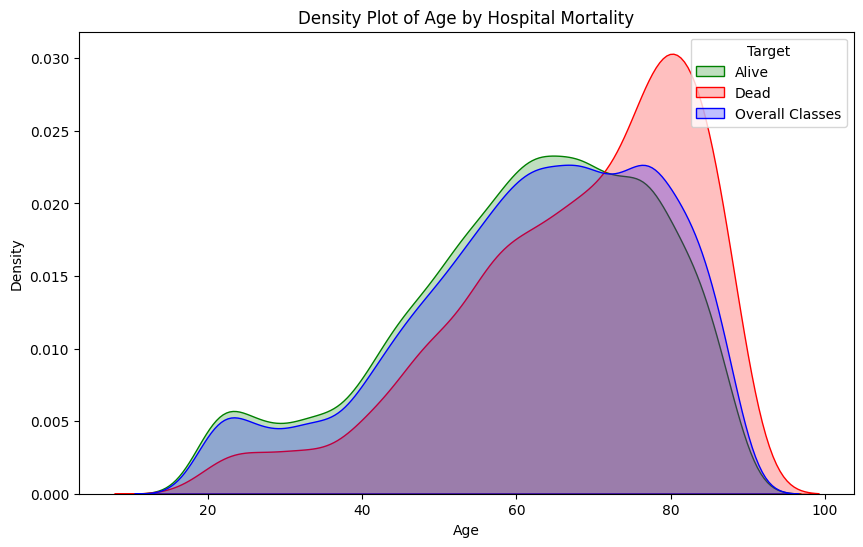

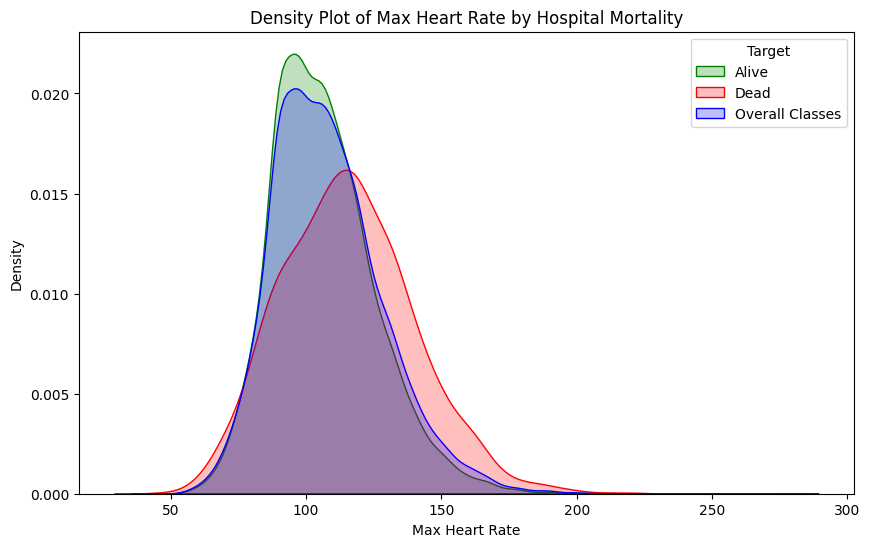

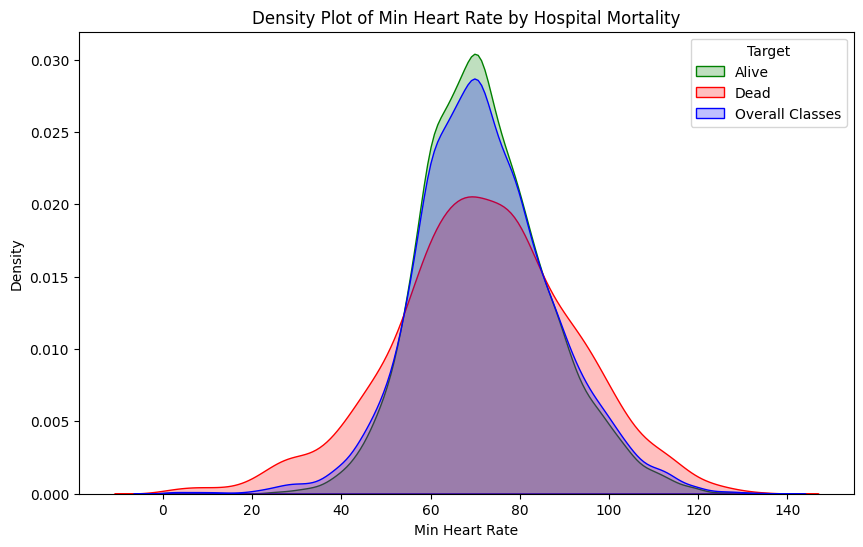

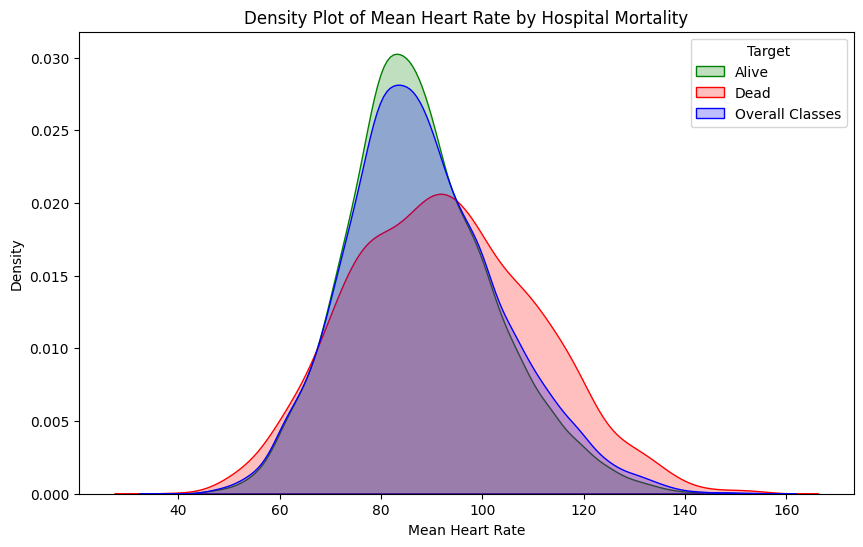

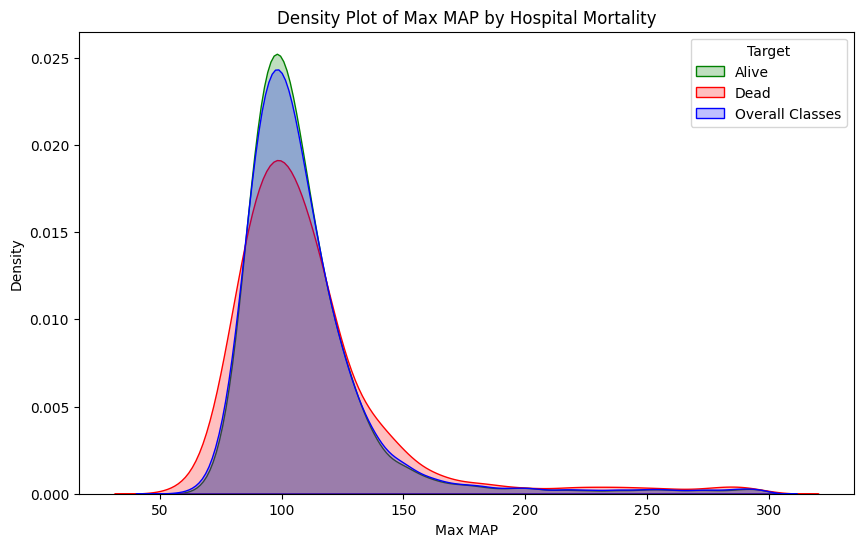

...

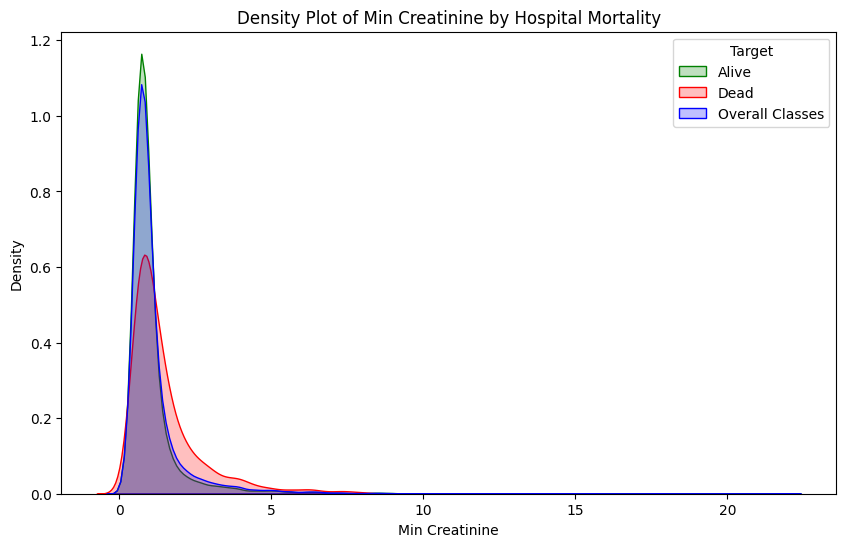

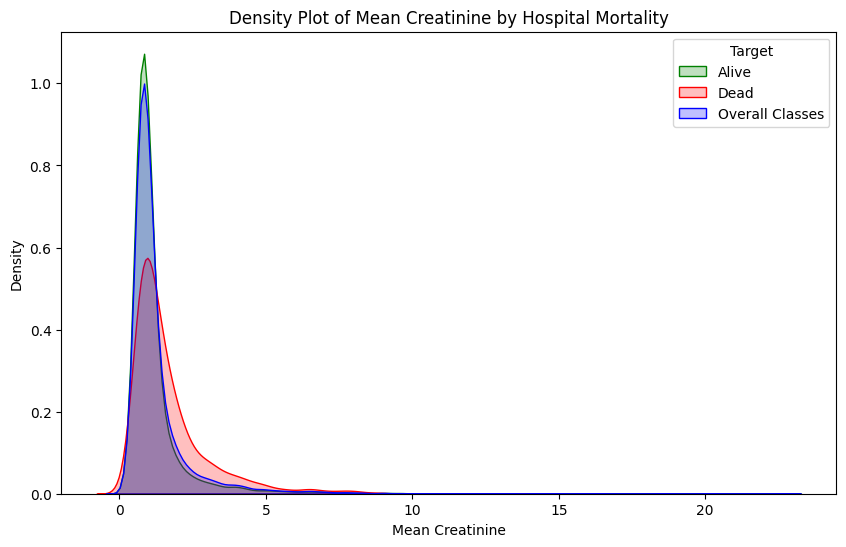

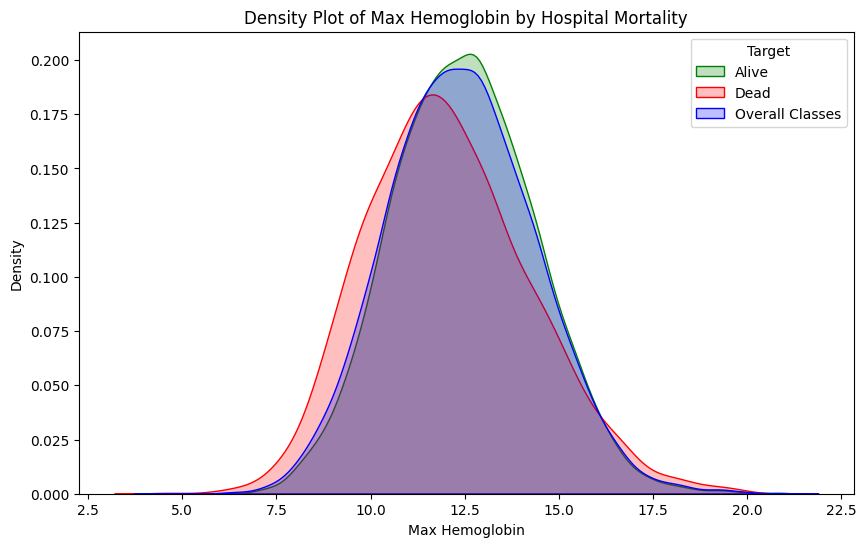

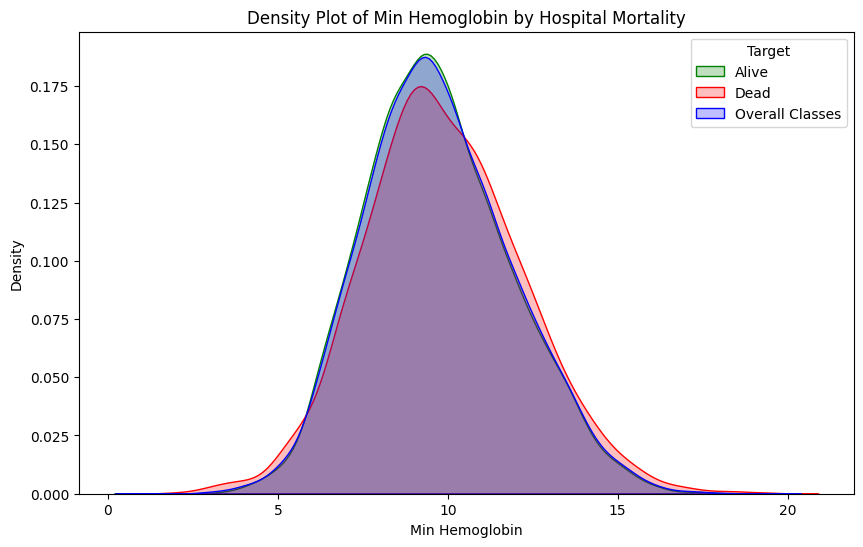

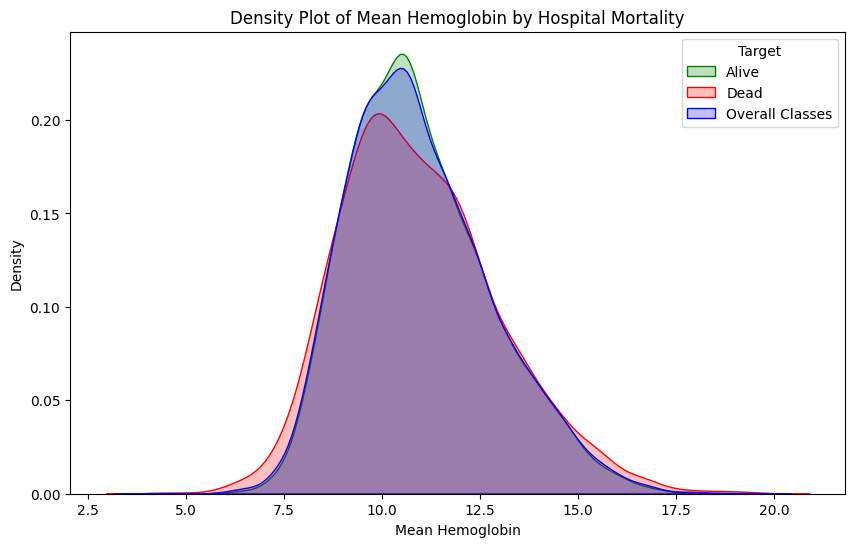

In [36]:
# First, select the columns you want to visualize
columns_to_visualize = cont_all_df # You can customize this based on your needs

# Remove the target column from the list (we don't want to plot it against itself)
# columns_to_visualize.remove('Hospital Mortality')

# Now, let's create density plots for each column against the target variable
for column in columns_to_visualize:
  if column == 'Hospital Mortality':
    pass
  else:
    fig, ax = plt.subplots(figsize=(10, 6))
    sns.kdeplot(data=df[df['Hospital Mortality'] == 0][column], ax = ax, label='Alive', fill=True, color = 'g')
    sns.kdeplot(data=df[df['Hospital Mortality'] == 1][column], ax = ax, label='Dead', fill=True, color = 'r')
    sns.kdeplot(data=df[column], label='Overall Classes',ax = ax, fill=True,color='b')

    plt.title(f'Density Plot of {column} by Hospital Mortality')
    plt.xlabel(column)
    plt.ylabel('Density')
    plt.legend(title='Target')
    plt.show()

### Numerical Variables

##### <a name='numsummary'>summary for continuous variables

In [37]:
# Separate numerical and categorical columns
numeric_features =  ['Max Heart Rate', 'Min Heart Rate',
       'Mean Heart Rate', 'Max MAP', 'Min MAP', 'Mean MAP',
       'Max Systolic Pressure', 'Min Systolic Pressure',
       'Mean Systolic Pressure', 'Max Diastolic Pressure',
       'Min Diastolic Pressure', 'Mean Diastolic Pressure', 'Max Temperature',
       'Min Temperature', 'Mean Temperature', 'Max Lactate', 'Min Lactate',
       'Mean Lactate', 'Max pH', 'Min pH', 'Mean pH', 'Max Glucose',
       'Min Glucose', 'Mean Glucose', 'Max WBC', 'Min WBC', 'Mean WBC',
       'Max BUN', 'Min BUN', 'Mean BUN', 'Max Creatinine', 'Min Creatinine',
       'Mean Creatinine', 'Max Hemoglobin', 'Min Hemoglobin',
       'Mean Hemoglobin', 'SAPS II', 'SOFA',
       'OASIS']
print(len(numeric_features))

39


In [38]:
subset_df = df[numeric_features]

# Get descriptive statistics for the selected features
statistics = subset_df.describe()

mean = statistics.loc['mean']
median = statistics.loc['50%']  # Median is the 50th percentile
std_dev = statistics.loc['std']

# Create a DataFrame to display the statistics in a table format
statistics_table = pd.DataFrame({'Mean': mean, 'Median': median, 'Standard Deviation': std_dev})

print(statistics_table)

                               Mean      Median  Standard Deviation
Max Heart Rate           107.984474  106.000000           20.573834
Min Heart Rate            71.973765   71.000000           15.531557
Mean Heart Rate           88.430129   86.862069           15.372059
Max MAP                  109.473430  103.000000           30.144985
Min MAP                   57.380068   58.000000           12.192861
Mean MAP                  78.237488   76.725000           10.222848
Max Systolic Pressure    152.713268  149.000000           24.243929
Min Systolic Pressure     87.046799   87.000000           17.442935
Mean Systolic Pressure   117.109939  114.826087           15.521249
Max Diastolic Pressure    83.701257   81.000000           18.191668
Min Diastolic Pressure    43.468572   44.000000           10.873250
Mean Diastolic Pressure   60.474160   59.657895            9.743214
Max Temperature           37.749812   37.722222            0.844661
Min Temperature           36.030913   36.111111 

##### Normality Check <a name='normality'>

Normality check for the continuous variables before normalization. Notice through visual inspection that the outliers are causing the shape to be skewed.

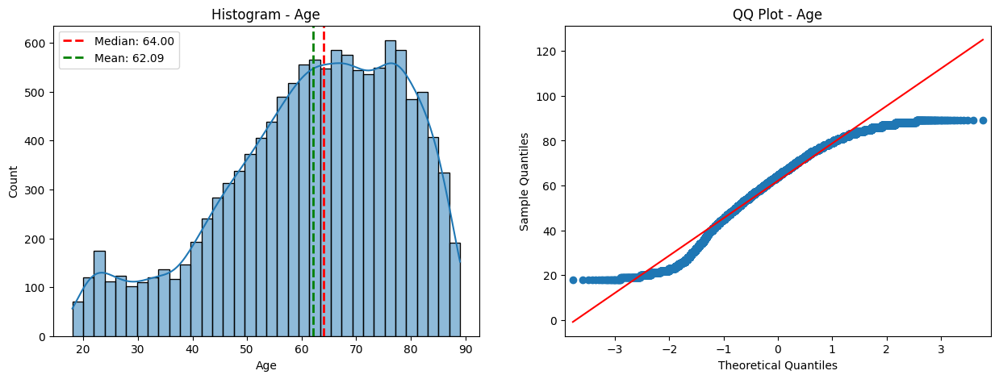

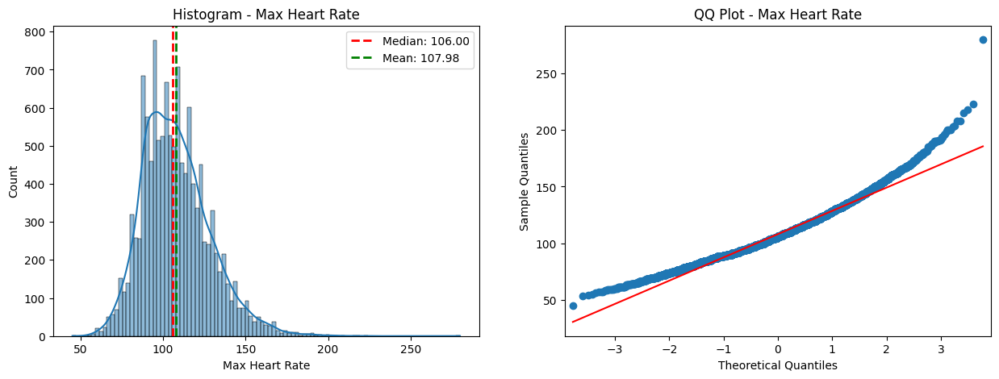

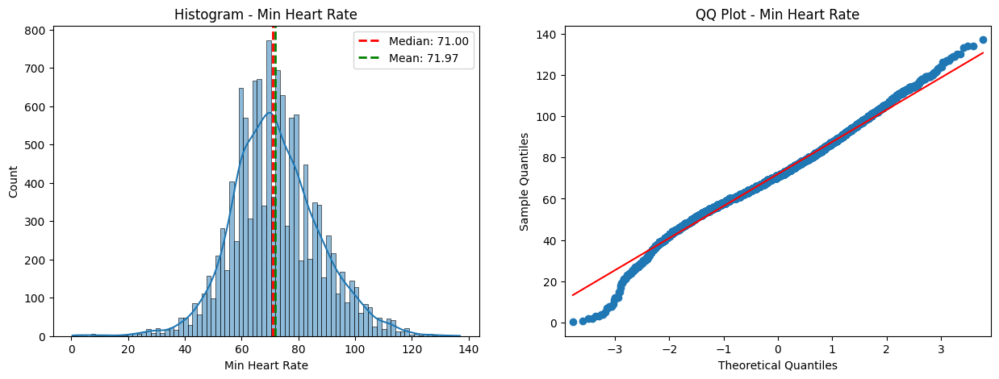

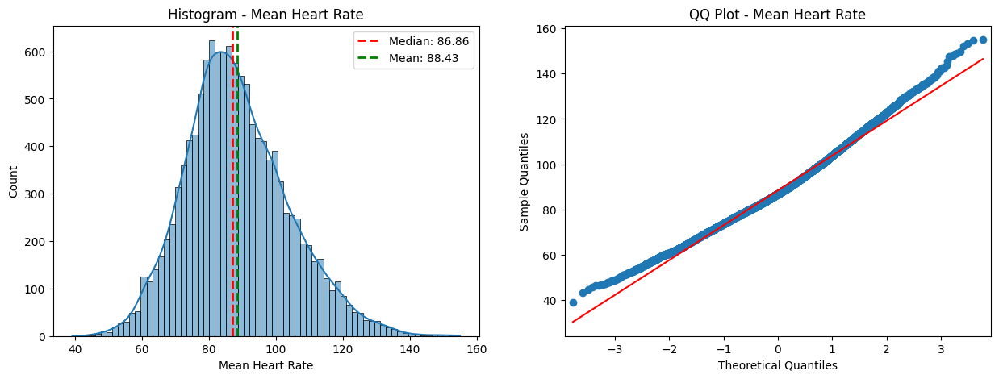

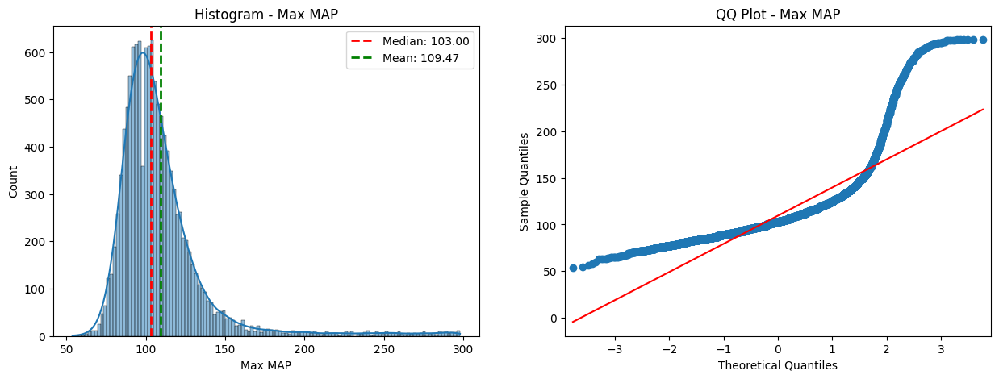

...

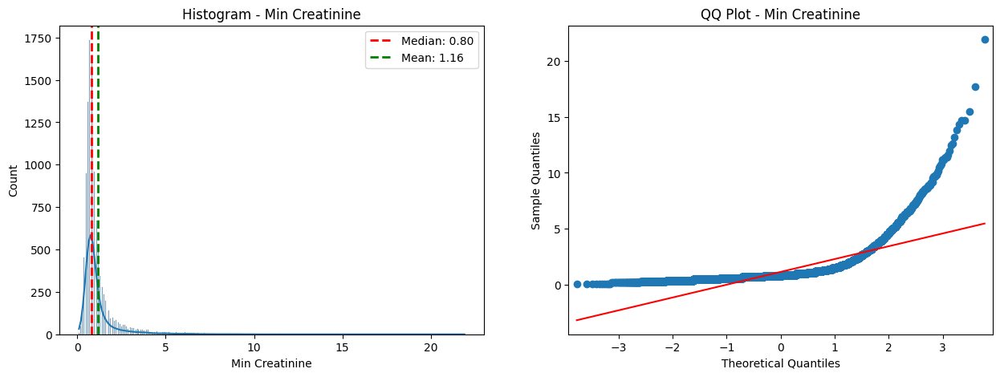

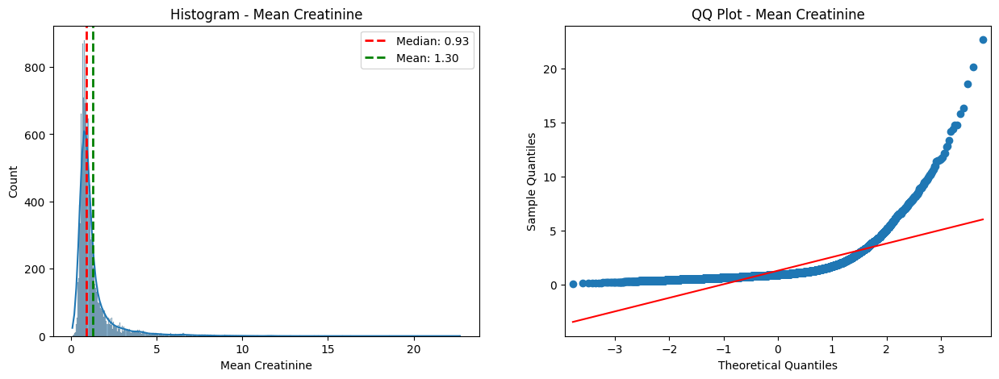

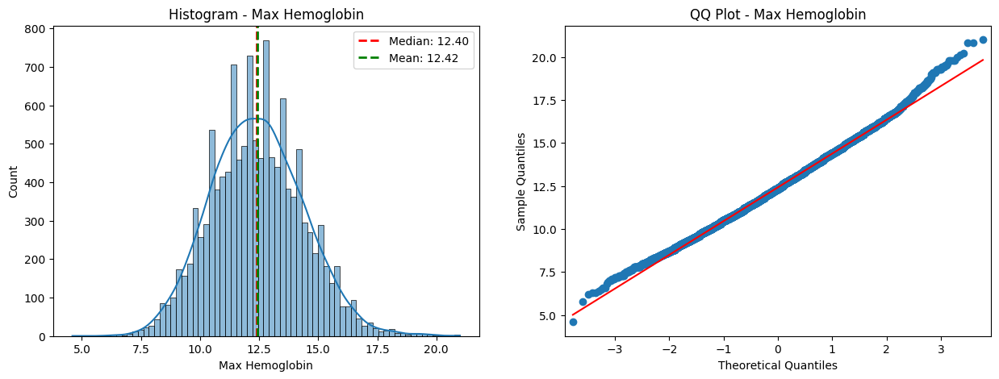

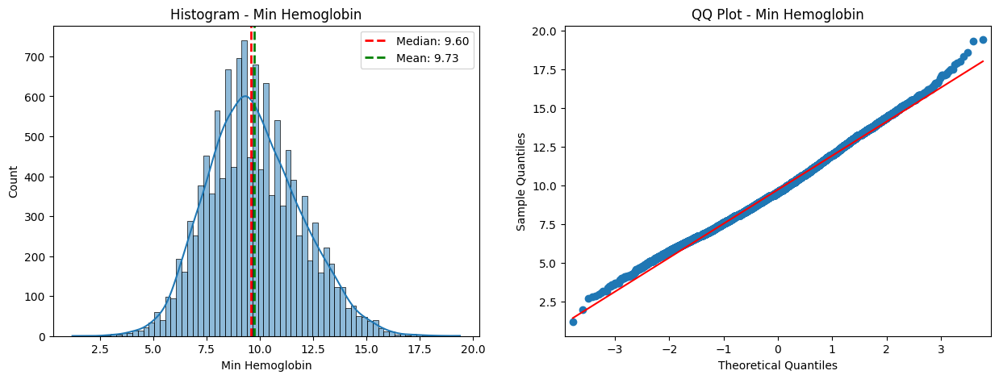

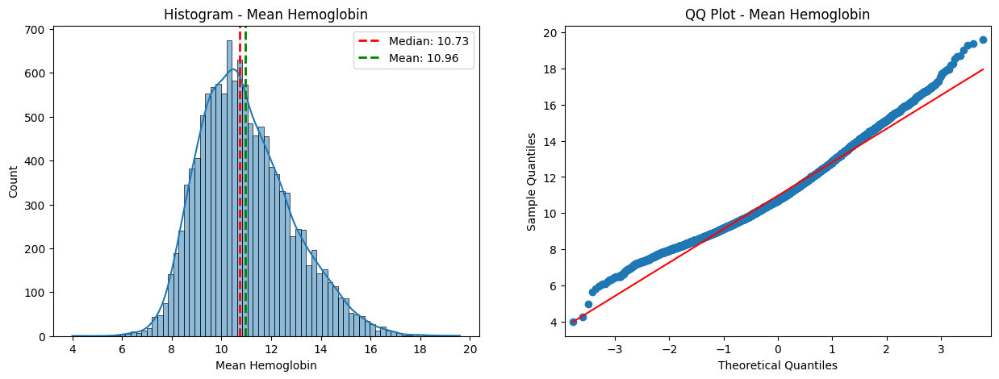

In [39]:
# histogram and QQ plot for each column
def plot_histogram_qqplot(data, column):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

    # Histogram with median and mean reference lines
    sns.histplot(data[column], kde=True, ax=axes[0])
    median_val = data[column].median()
    mean_val = data[column].mean()
    axes[0].axvline(median_val, color='r', linestyle='dashed', linewidth=2, label=f'Median: {median_val:.2f}')
    axes[0].axvline(mean_val, color='g', linestyle='dashed', linewidth=2, label=f'Mean: {mean_val:.2f}')
    axes[0].set_title(f'Histogram - {column}')
    axes[0].legend()

    # QQ Plot
    sm.qqplot(data[column], line='s', ax=axes[1])
    axes[1].set_title(f'QQ Plot - {column}')

    plt.show()

# Iterate through columns and create plots
for column in cont_all_df.columns:
    if column != 'Hospital Mortality':
        plot_histogram_qqplot(cont_all_df, column)

##### Shapiro-Wilk Test <a name='shapiro'>

Shapiro Wilk test conducted on the dataset without missing values. The result for all variables is "not normally distributed."

In [40]:
# Perform Shapiro-Wilk test on each column in cont_all_df
for column in cont_all_df.columns[1:]:
    stat, p = stats.shapiro(cont_all_df[column])
    print(f"Shapiro-Wilk test for {column}:")
    print(f"  Statistic: {stat}")
    print(f"  p-value: {p}")
    print("")

    if p < 0.05:
        print(f"The distribution of {column} is significantly different from normal.")
        print("---------------------------------------------------------------------")
    else:
        print(f"The distribution of {column} is not significantly different from normal.")
        print("---------------------------------------------------------------------")

Shapiro-Wilk test for Age:
  Statistic: 0.9579778909683228
  p-value: 0.0

The distribution of Age is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Max Heart Rate:
  Statistic: 0.9716181755065918
  p-value: 6.866362475191604e-44

The distribution of Max Heart Rate is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Min Heart Rate:
  Statistic: 0.9904375672340393
  p-value: 4.8635451107712535e-28

The distribution of Min Heart Rate is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Mean Heart Rate:
  Statistic: 0.9883667230606079
  p-value: 1.270662467504408e-30

The distribution of Mean Heart Rate is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Max MAP:
  Statisti

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


# Visualization Exploration

### Box plots <a name='boxplot'>

#### Demographics

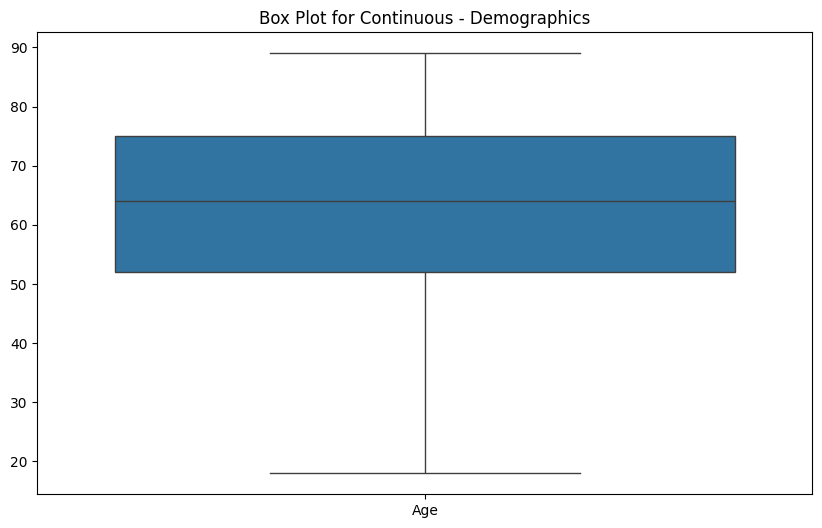

In [41]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=cont_dem_df)
plt.title("Box Plot for Continuous - Demographics")
plt.show()

#### Vital Signs

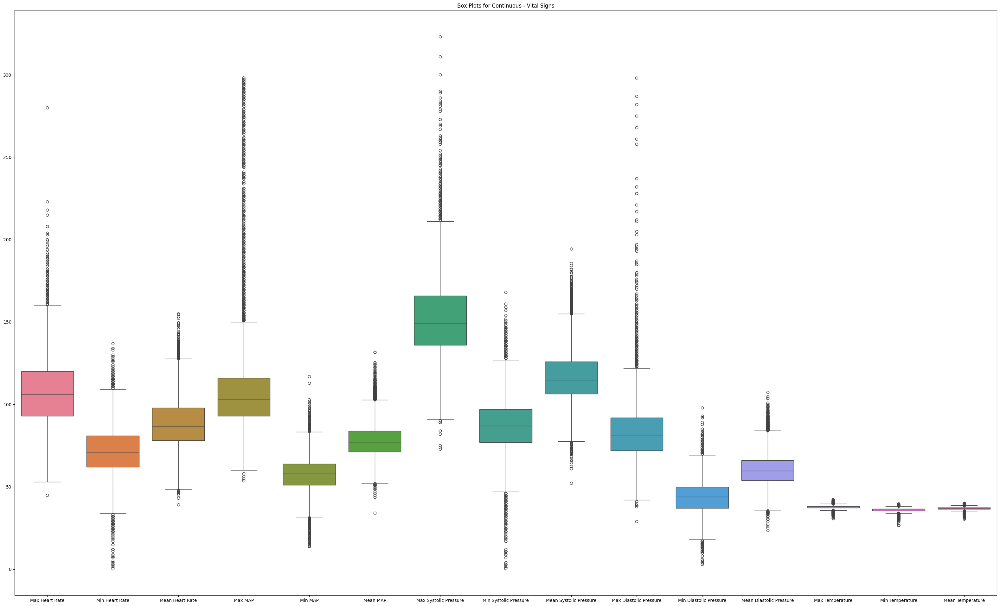

In [42]:
plt.figure(figsize=(40, 24))
sns.boxplot(data=cont_vital_df)
plt.title("Box Plots for Continuous - Vital Signs")
plt.show()

#### Laboratory Results

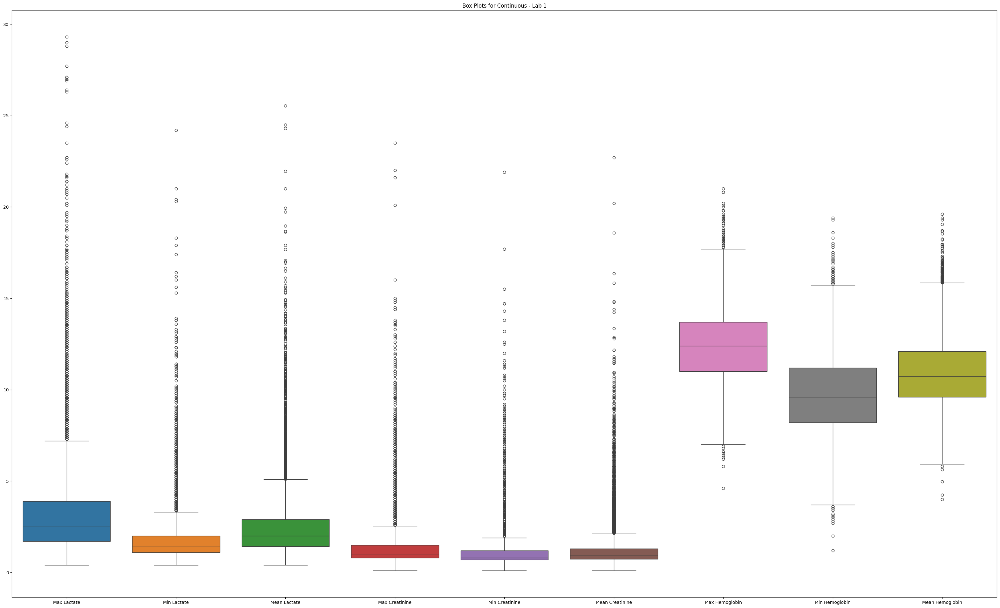

In [43]:
plt.figure(figsize=(40, 24))
sns.boxplot(data=cont_lab_df)
plt.title("Box Plots for Continuous - Lab 1")
plt.show()

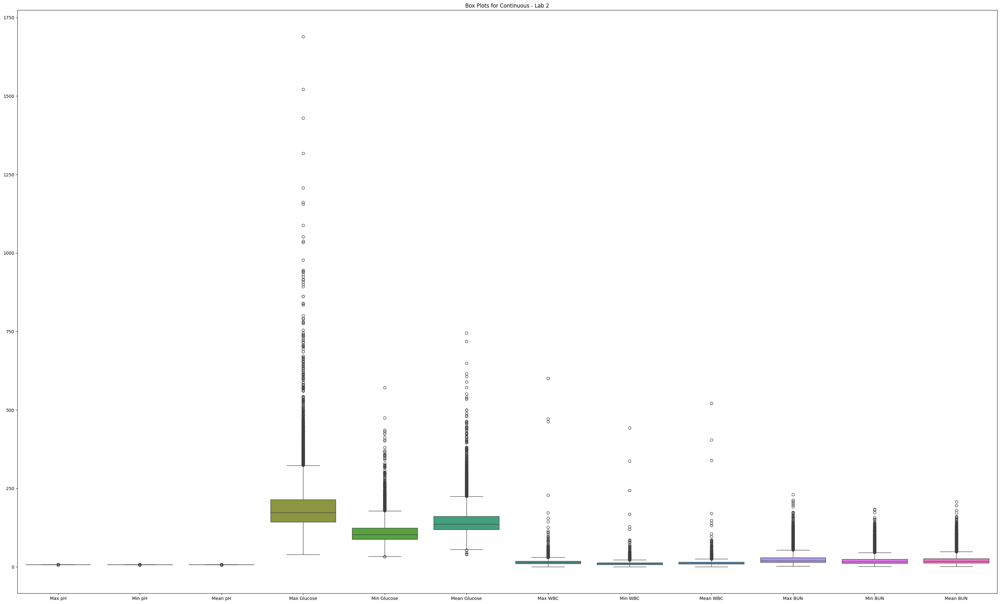

In [44]:
plt.figure(figsize=(40, 24))
sns.boxplot(data=cont_lab2_df)
plt.title("Box Plots for Continuous - Lab 2")
plt.show()

### Num of Outliers <a name='outliers'>

In [45]:
contVar = df.select_dtypes(include=['float64']).columns


In [46]:
Q1 = df[contVar.values].quantile(0.25)
Q3 = df[contVar.values].quantile(0.75)
IQR = Q3 - Q1

# Find outliers for each continuous variable
outliersCount = ((df[contVar.values] < (Q1 - 1.5 * IQR)) | (df[contVar.values] > (Q3 + 1.5 * IQR))).sum()

# Display the number of outliers for each variable
print("Number of outliers for each continuous variable:")
print(outliersCount)

Number of outliers for each continuous variable:
Max Heart Rate              205
Min Heart Rate              294
Mean Heart Rate             166
Max MAP                     724
Min MAP                     657
Mean MAP                    311
Max Systolic Pressure       273
Min Systolic Pressure       415
Mean Systolic Pressure      296
Max Diastolic Pressure      403
Min Diastolic Pressure      368
Mean Diastolic Pressure     253
Max Temperature             291
Min Temperature             390
Mean Temperature            279
Max Lactate                 992
Min Lactate                1005
Mean Lactate                919
Max pH                      258
Min pH                      477
Mean pH                     362
Max Glucose                 766
Min Glucose                 535
Mean Glucose                785
Max WBC                     456
Min WBC                     430
Mean WBC                    413
Max BUN                    1082
Min BUN                    1032
Mean BUN               

### Bar Charts <a name='barchart'>

<Figure size 800x600 with 0 Axes>

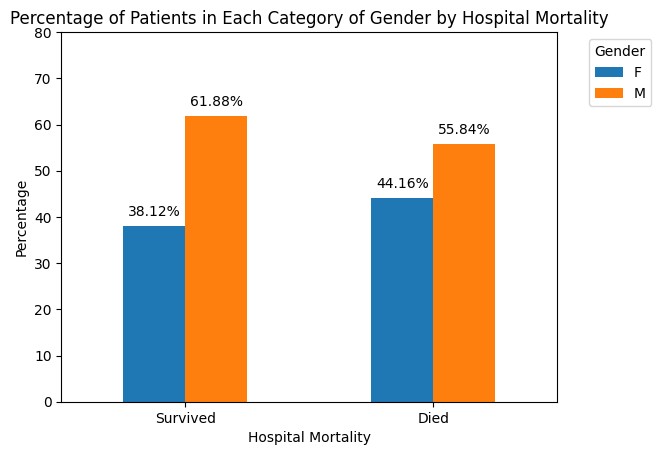

<Figure size 800x600 with 0 Axes>

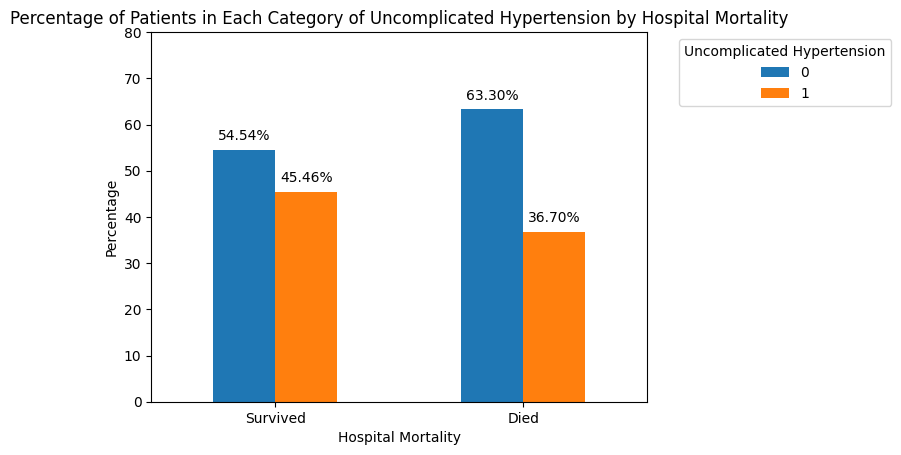

<Figure size 800x600 with 0 Axes>

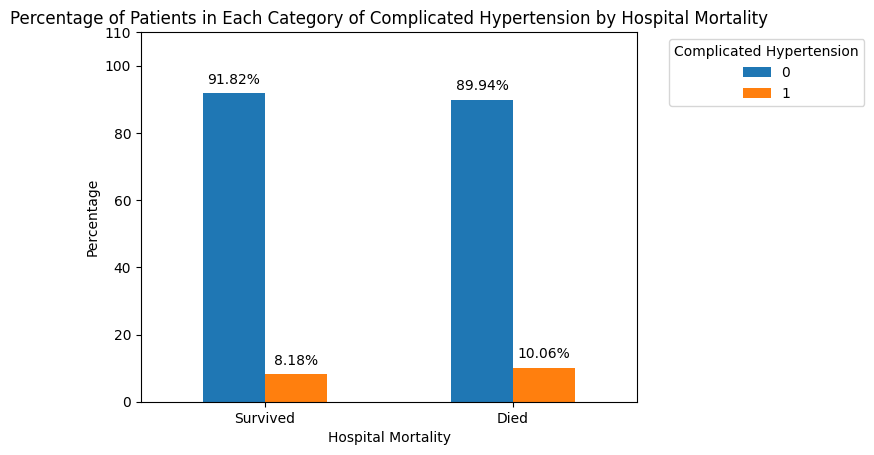

<Figure size 800x600 with 0 Axes>

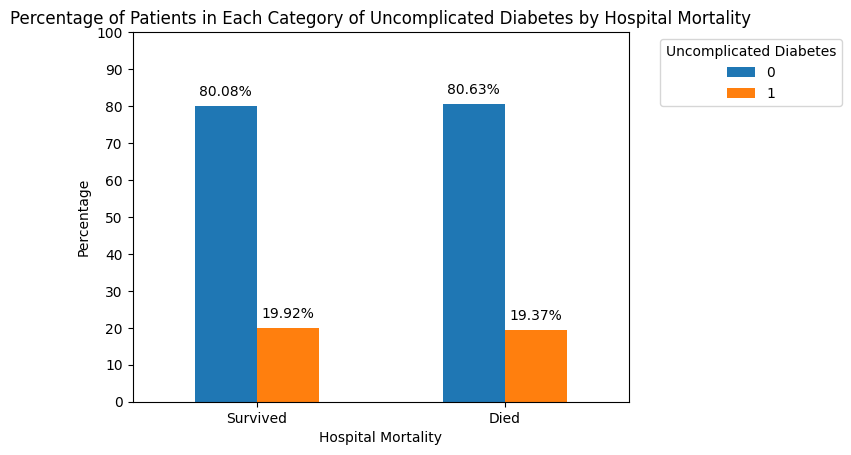

<Figure size 800x600 with 0 Axes>

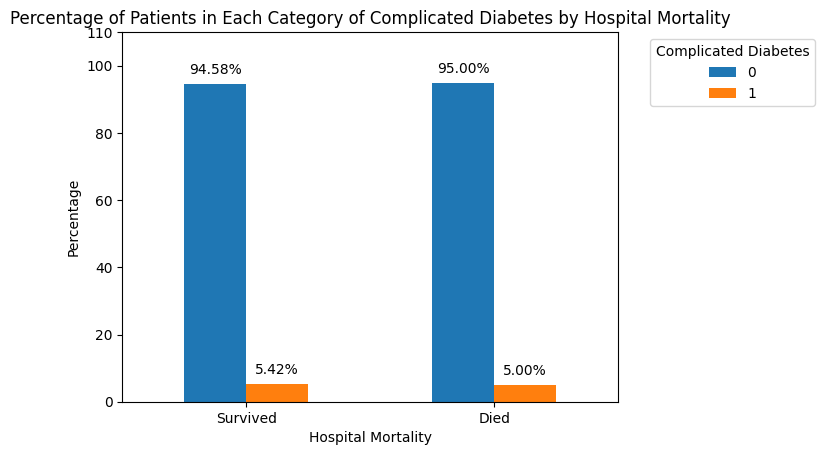

<Figure size 800x600 with 0 Axes>

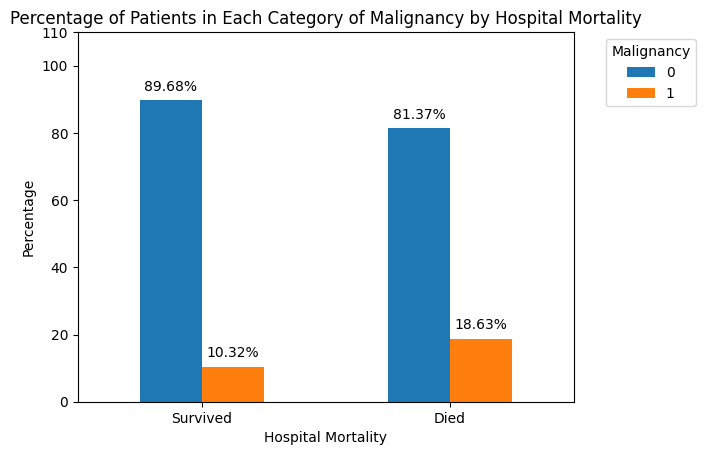

<Figure size 800x600 with 0 Axes>

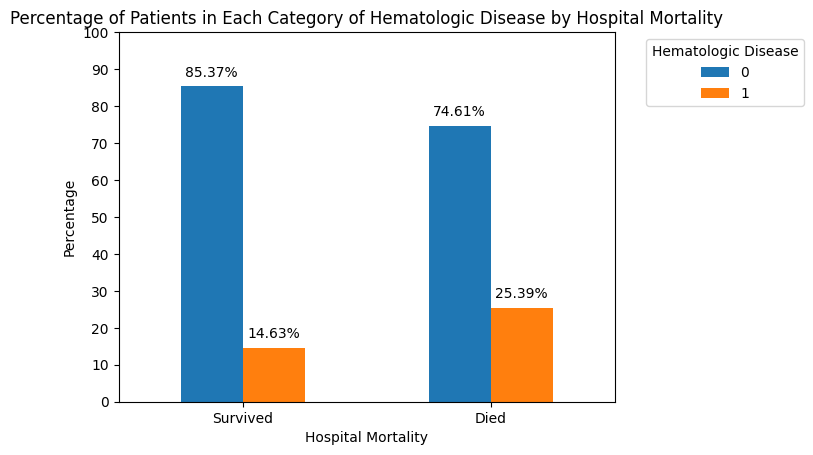

<Figure size 800x600 with 0 Axes>

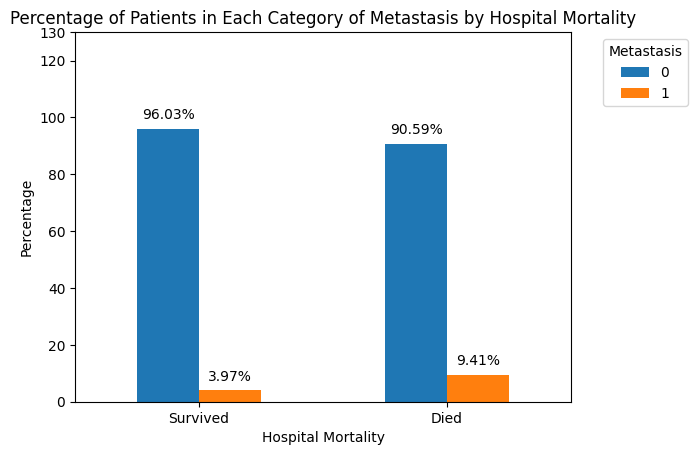

<Figure size 800x600 with 0 Axes>

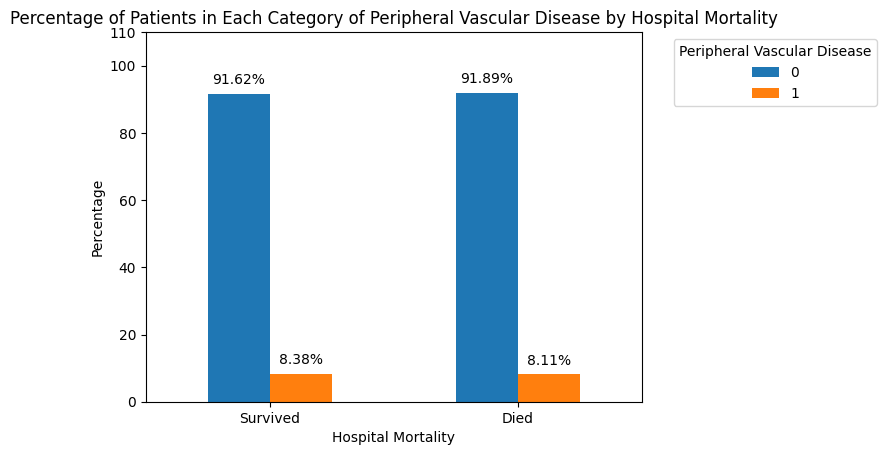

<Figure size 800x600 with 0 Axes>

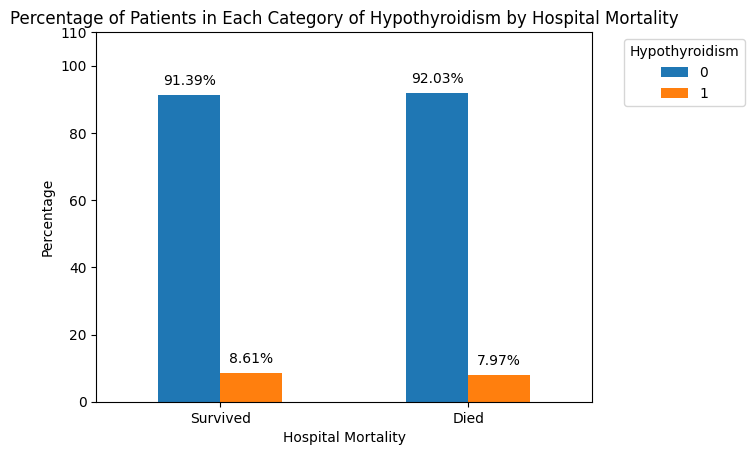

<Figure size 800x600 with 0 Axes>

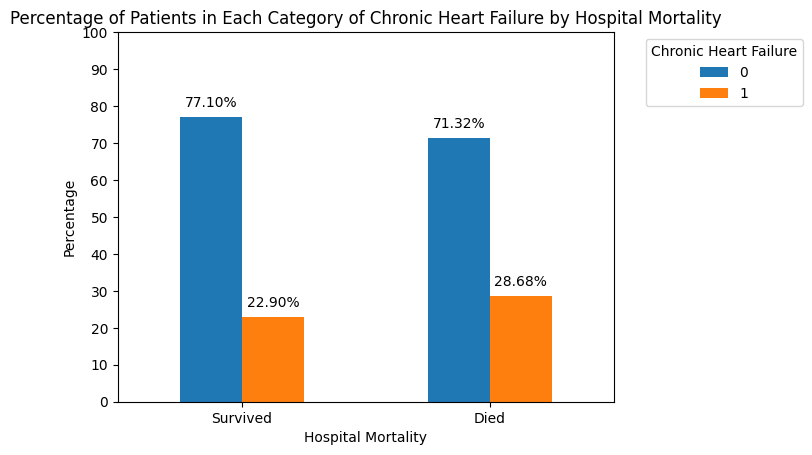

<Figure size 800x600 with 0 Axes>

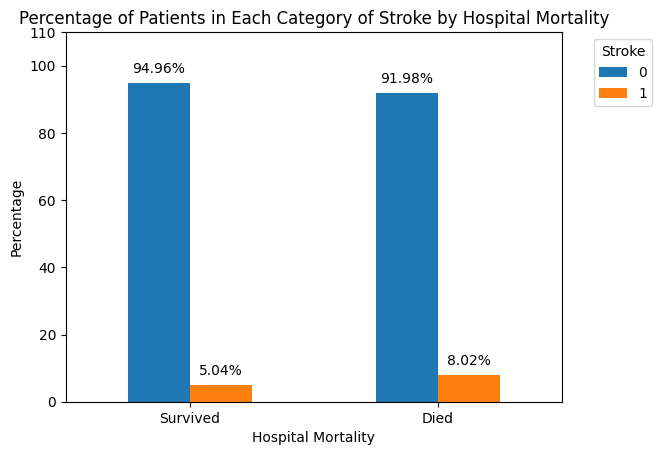

<Figure size 800x600 with 0 Axes>

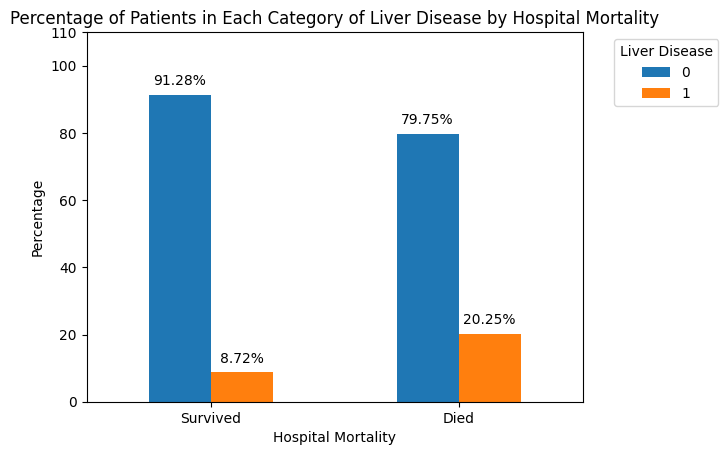

<Figure size 800x600 with 0 Axes>

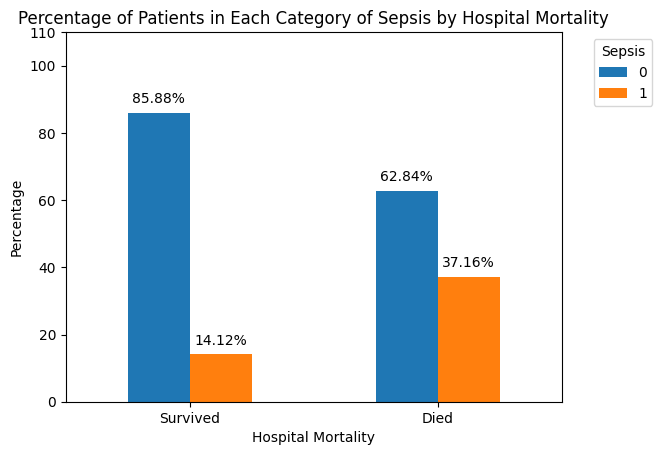

<Figure size 800x600 with 0 Axes>

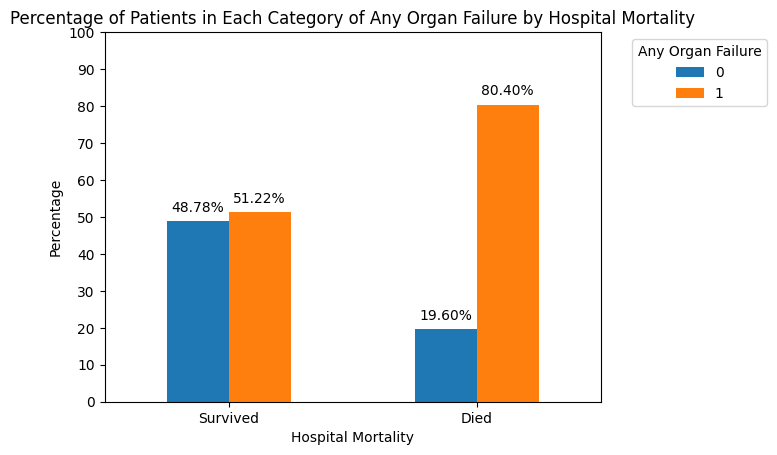

<Figure size 800x600 with 0 Axes>

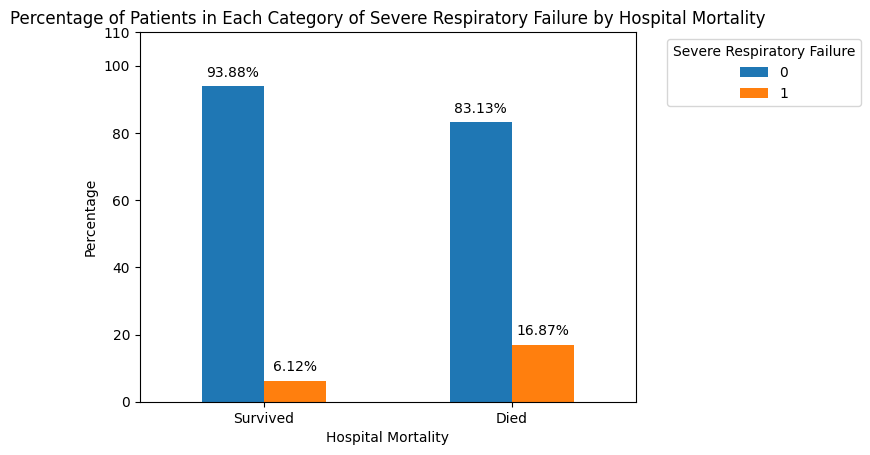

<Figure size 800x600 with 0 Axes>

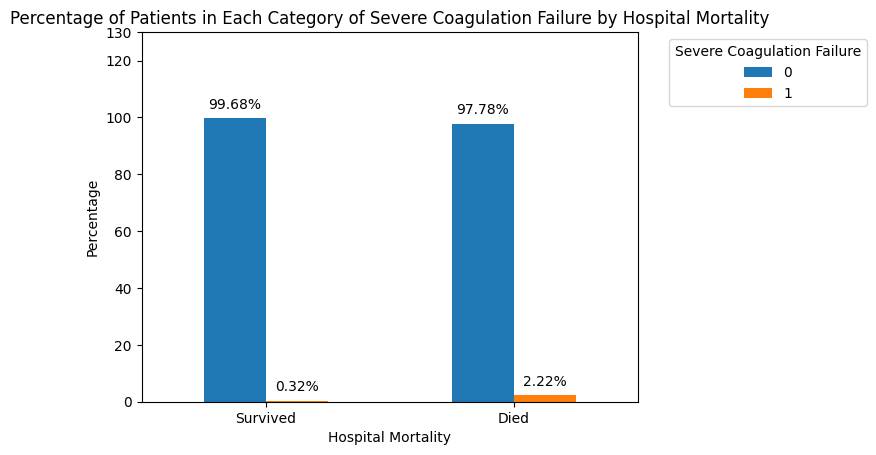

<Figure size 800x600 with 0 Axes>

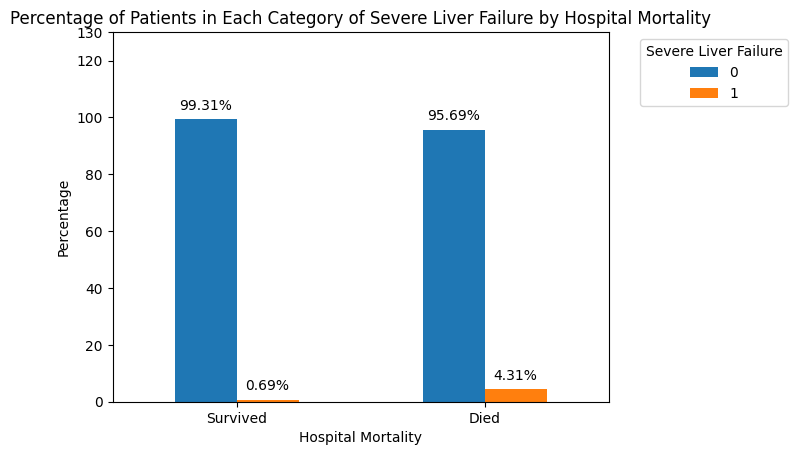

<Figure size 800x600 with 0 Axes>

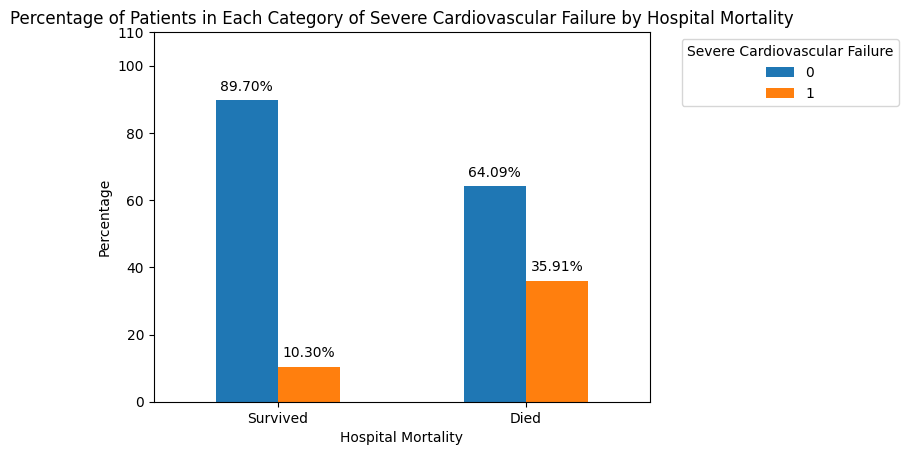

<Figure size 800x600 with 0 Axes>

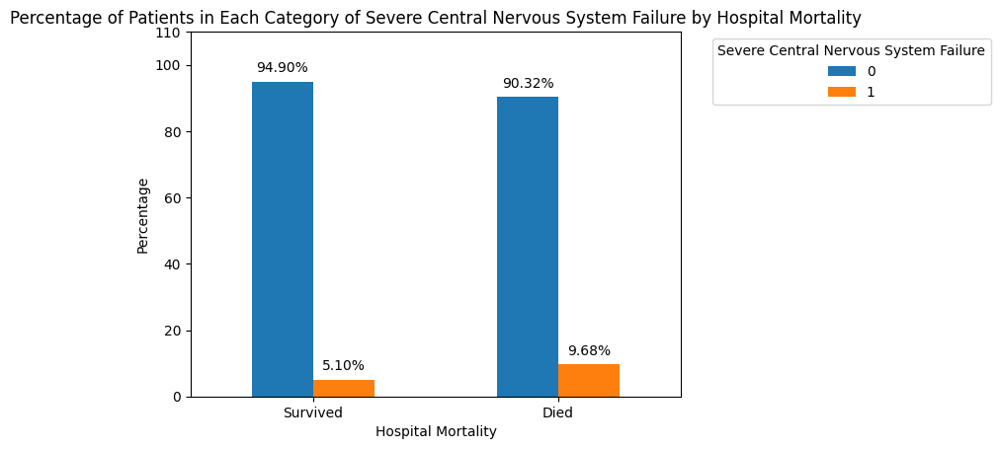

<Figure size 800x600 with 0 Axes>

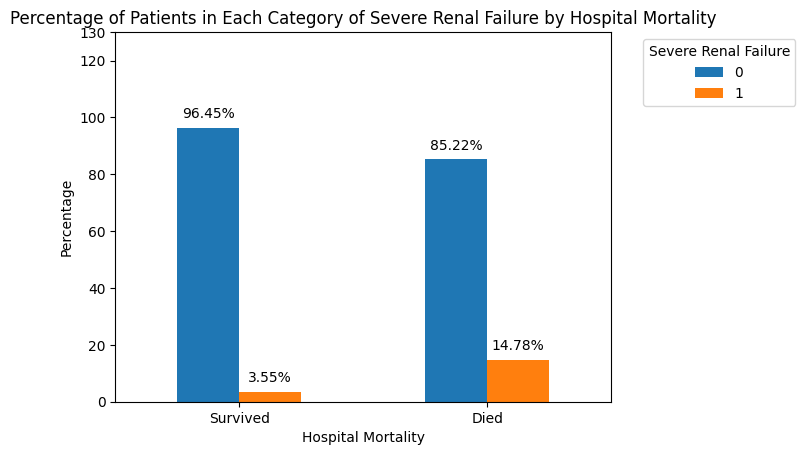

<Figure size 800x600 with 0 Axes>

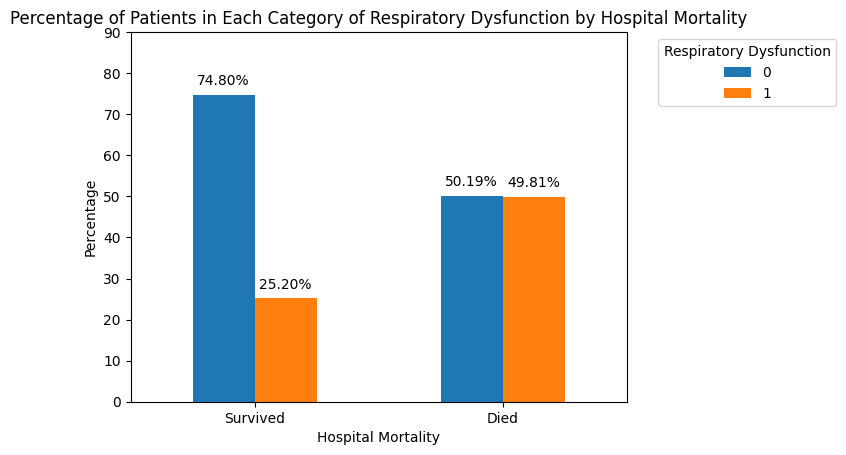

<Figure size 800x600 with 0 Axes>

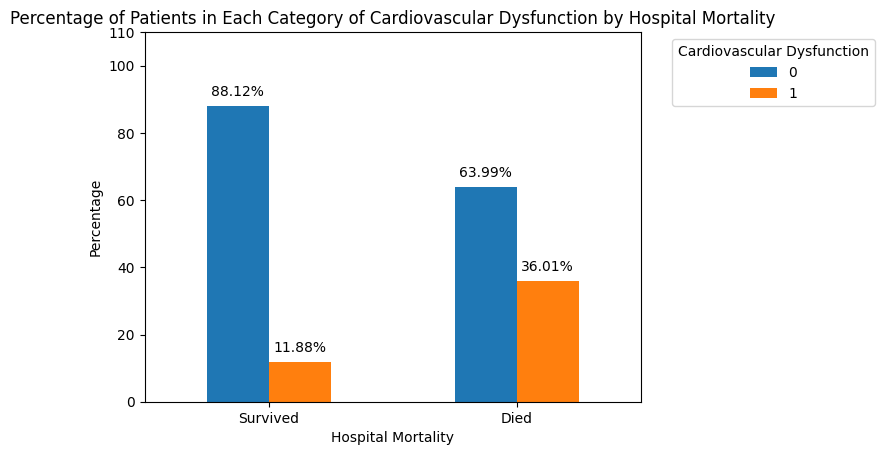

<Figure size 800x600 with 0 Axes>

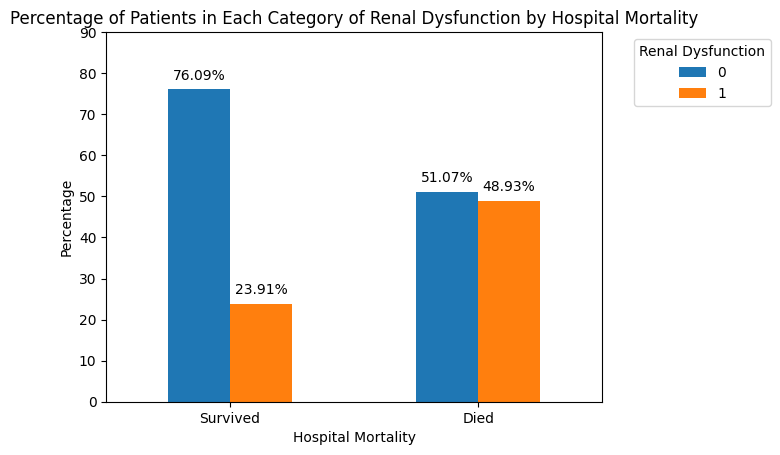

<Figure size 800x600 with 0 Axes>

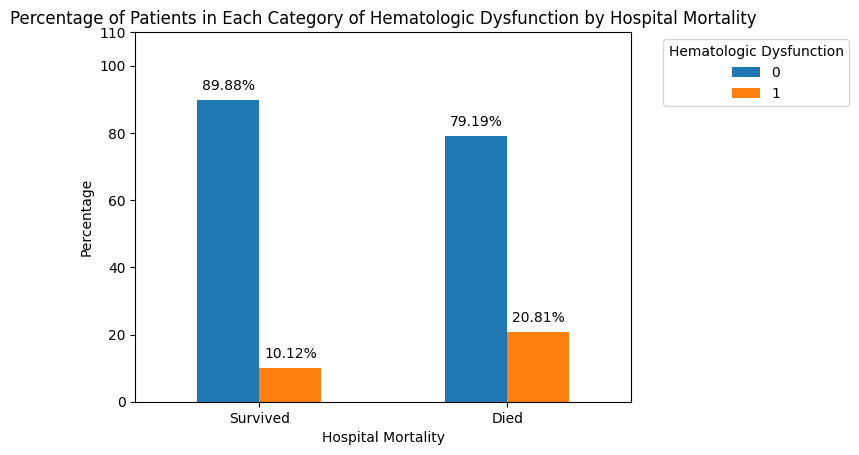

<Figure size 800x600 with 0 Axes>

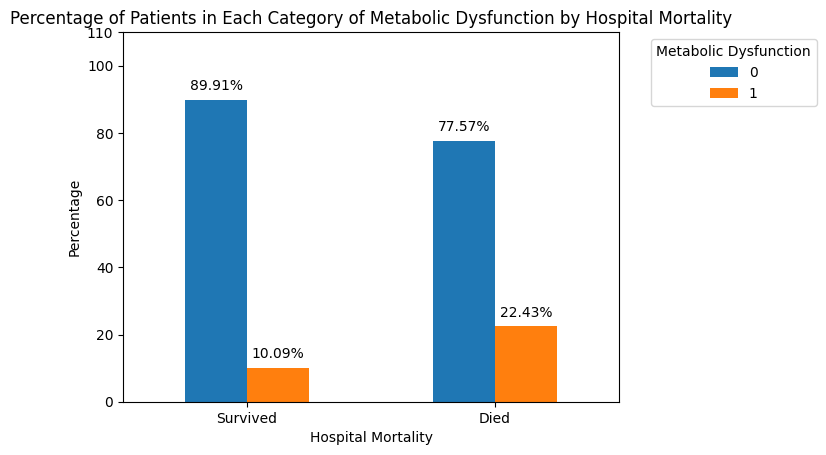

<Figure size 800x600 with 0 Axes>

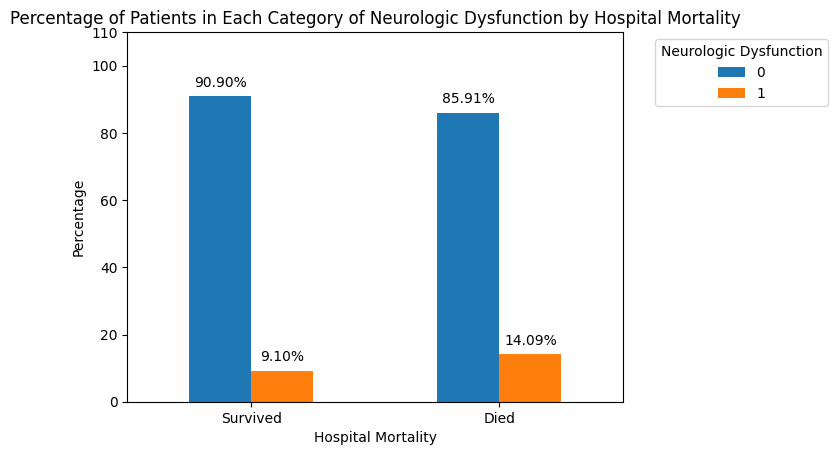

In [47]:
import matplotlib.pyplot as plt

# Set a consistent figure size for all plots
fig_size = (8, 6)

for column in binary_df.columns[1:]:
    # Calculate the percentage of patients in each category for each group
    percentages = binary_df.groupby('Hospital Mortality')[column].value_counts(normalize=True) * 100

    # Bar graph
    plt.figure(figsize=fig_size)  # Set the figure size
    ax = percentages.unstack().plot(kind='bar')

    # Add percentage labels on top of each bar
    for p in ax.patches:
        ax.annotate(f'{p.get_height():.2f}%', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points')

    plt.title(f'Percentage of Patients in Each Category of {column} by Hospital Mortality')
    plt.xlabel('Hospital Mortality')
    plt.ylabel('Percentage')
    plt.xticks(ticks=[0, 1], labels=['Survived', 'Died'], rotation=0)  # Set rotation to 0 for horizontal labels

    # legend outside the plot area
    plt.legend(title=column, bbox_to_anchor=(1.05, 1), loc='upper left')

    # Add an extra tick
    plt.yticks(list(plt.yticks()[0]) + [plt.yticks()[0][-1] + 10])

    plt.show()


### Correlation Matrix <a name='corr'>

In [48]:
# correlation_matrix = df[contVar].corr()
# plt.figure(figsize=(22, 20))
# sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=.5)
# plt.title("Heatmap of Correlation Matrix")
# plt.show()

#### Correlation Matrix without max and min variables

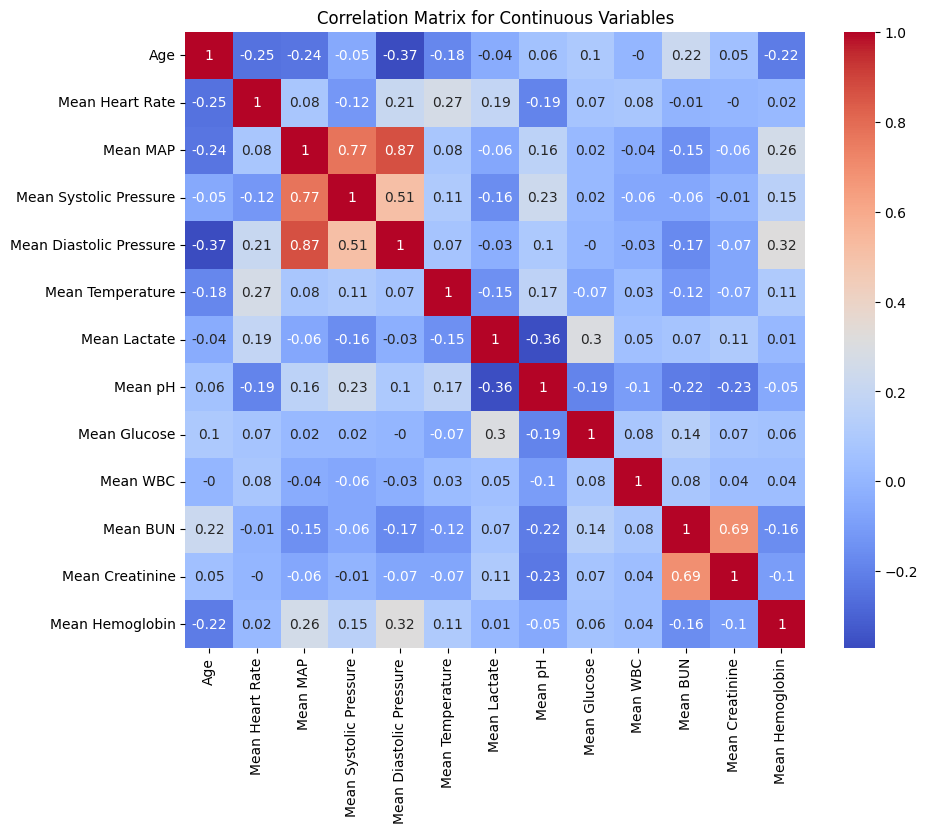

In [49]:
# Exclude 'Hospital Mortality' and columns containing 'Min' or 'Max'
cols_to_exclude = ['Hospital Mortality'] + [col for col in cont_all_df.columns if 'Min' in col or 'Max' in col]

# correlation matrix
corr_matrix = cont_all_df.drop(cols_to_exclude, axis=1).corr()

# Round the correlation values to 2 decimal places
corr_matrix = corr_matrix.round(2)

# heatmap of the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix for Continuous Variables')
plt.show()


### Point plots <a name='pointplot'>

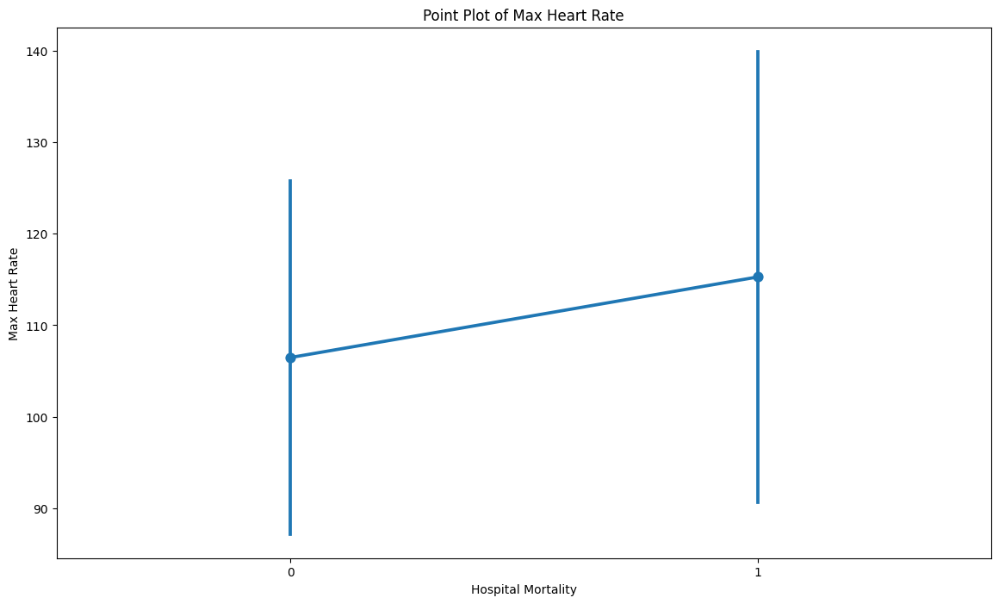

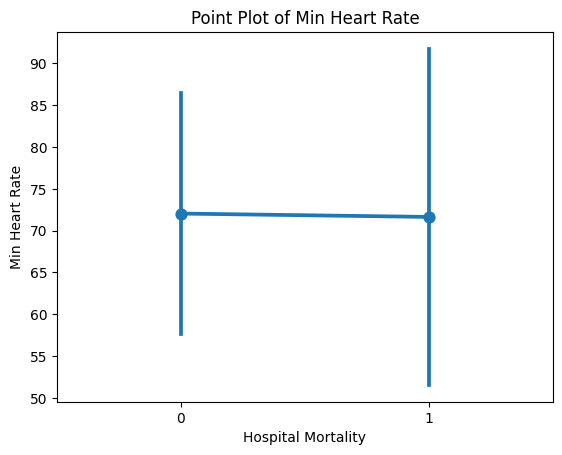

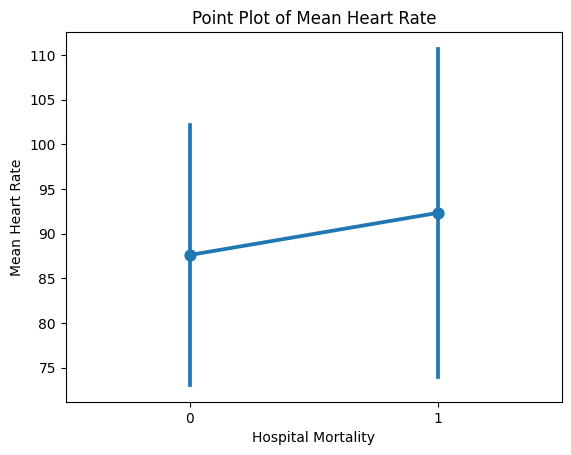

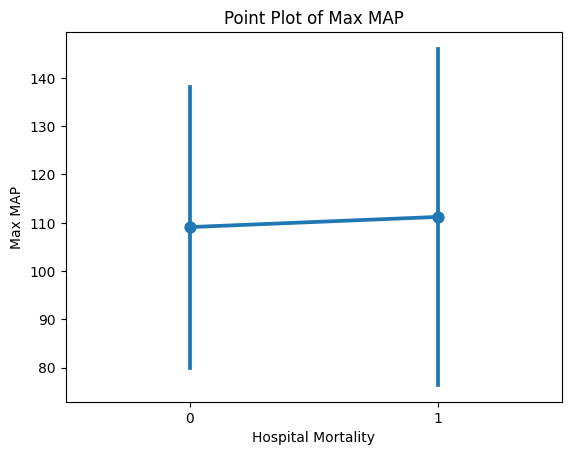

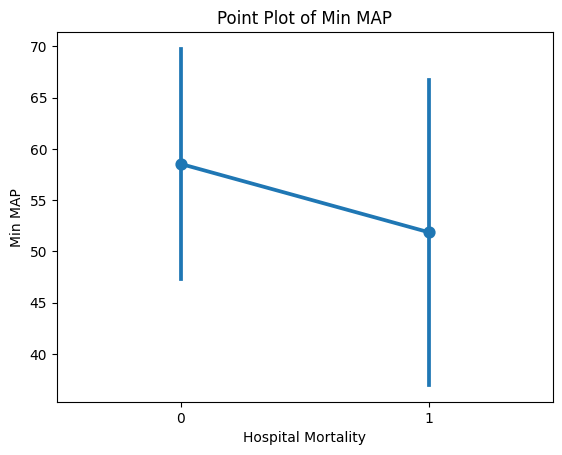

...

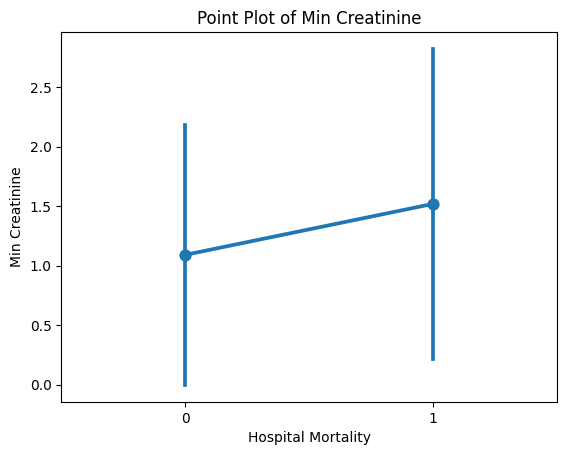

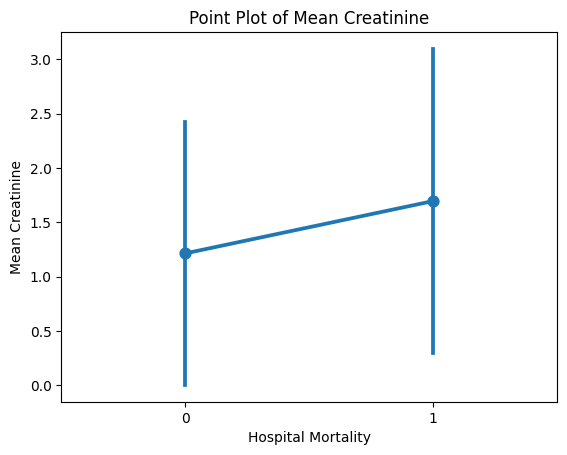

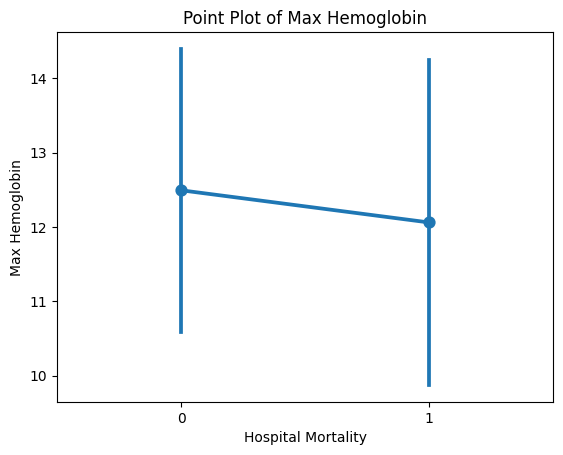

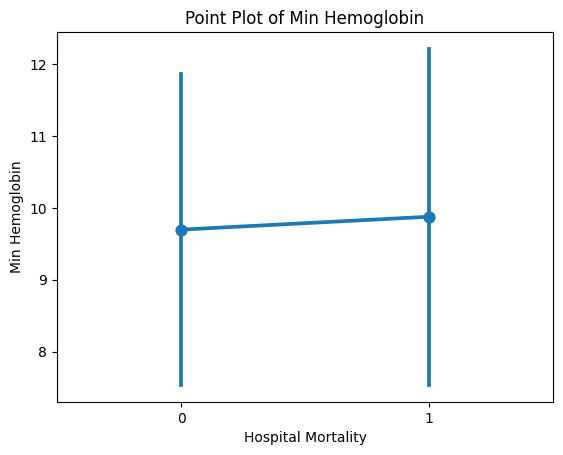

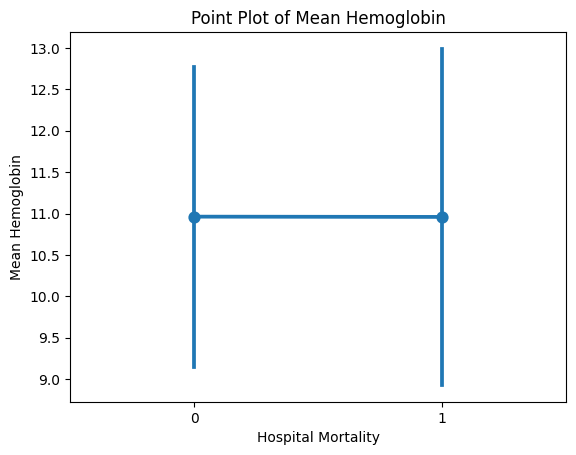

In [50]:
plt.figure(figsize=(14, 8))
for variable in contVar:
    sns.pointplot(x='Hospital Mortality', y=variable, data=df, errorbar='sd', dodge=True)
    plt.title(f'Point Plot of {variable}')
    plt.xlabel('Hospital Mortality')
    plt.ylabel(f'{variable}')
    plt.show()

# Data Nomalization on Continues variables  <a name='norm'>

### Log Transformation Method <a name='log_trans'>

In [51]:
log_transformed_data = cont_all_df.copy()

for column in cont_all_df.columns:
    if column != 'Hospital Mortality':
        log_transformed_data[column] = np.log(cont_all_df[column] + 1)


print(log_transformed_data.head())

    Hospital Mortality       Age  Max Heart Rate  Min Heart Rate  \
0                    0  4.356709        5.129899        4.330733   
1                    1  3.761200        4.718499        4.418841   
2                    1  4.290459        4.663439        4.276666   
9                    1  4.290459        4.007333        3.891820   
13                   0  4.343805        4.867534        4.521789   

    Mean Heart Rate   Max MAP   Min MAP  Mean MAP  Max Systolic Pressure  \
0          4.725490  5.560682  3.713572  4.339808               5.384495   
1          4.537961  4.890349  4.219508  4.603669               5.384495   
2          4.463936  4.709530  4.304065  4.490881               5.111988   
9          3.955672  4.605170  4.158883  4.393499               4.990433   
13         4.668946  4.488636  3.995137  4.304065               4.744932   

    Min Systolic Pressure  Mean Systolic Pressure  Max Diastolic Pressure  \
0                4.174387                4.644006        

Data Distribution after normalization. There is an improvement in terms of normality for some variables but the rest are still skewed so we will be using Mann-WHitney test for most of the continuous variables.

#### Visualization after log tranformation method

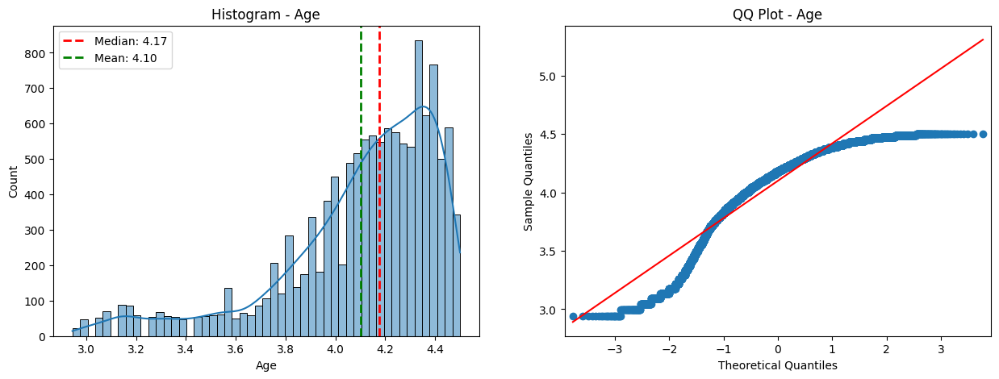

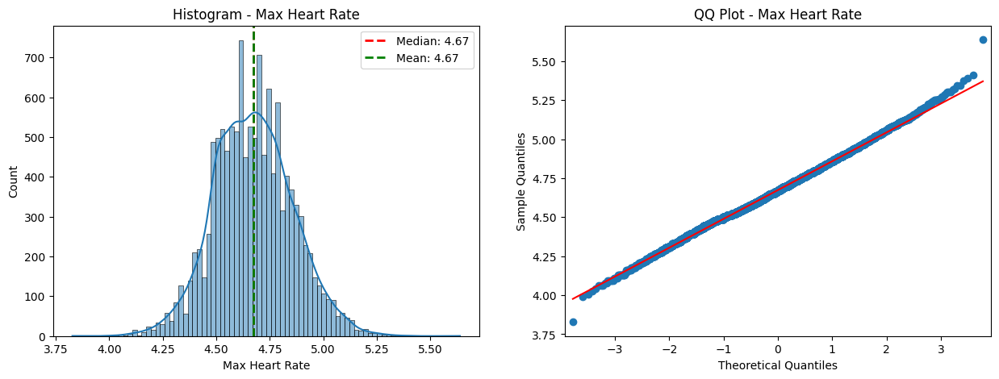

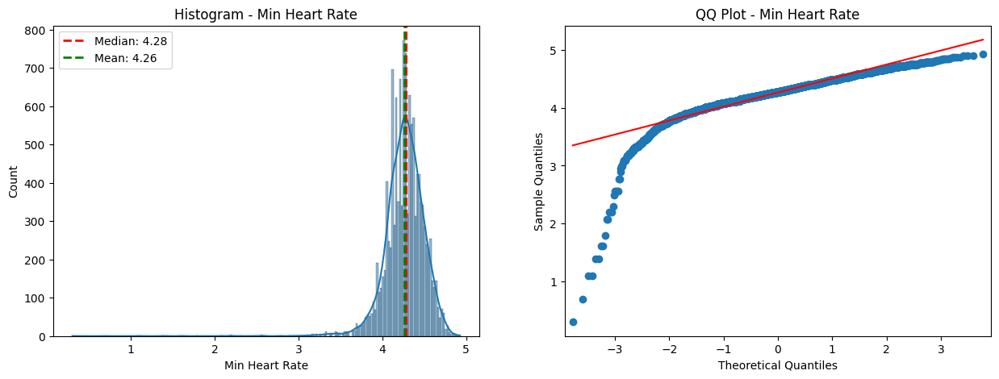

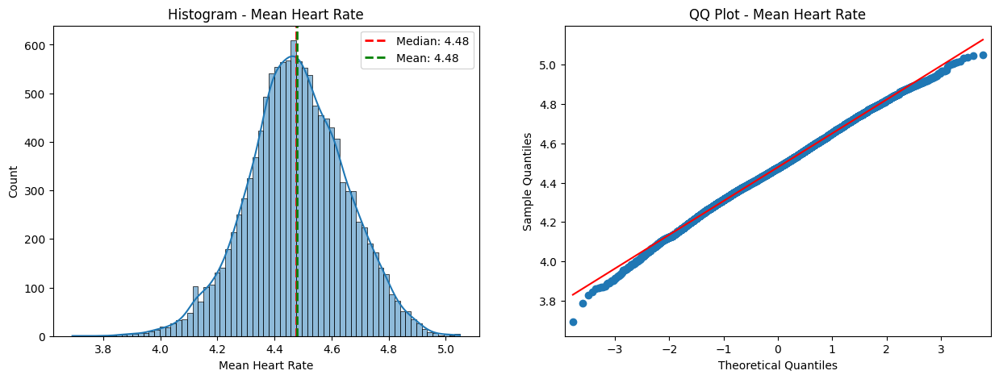

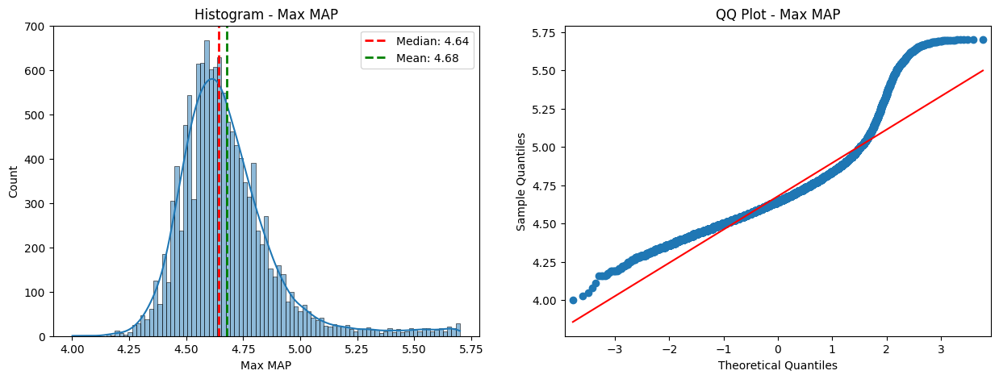

...

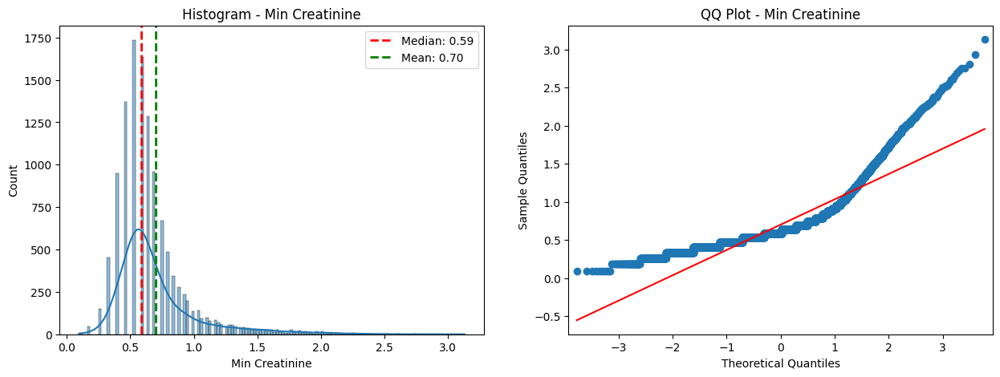

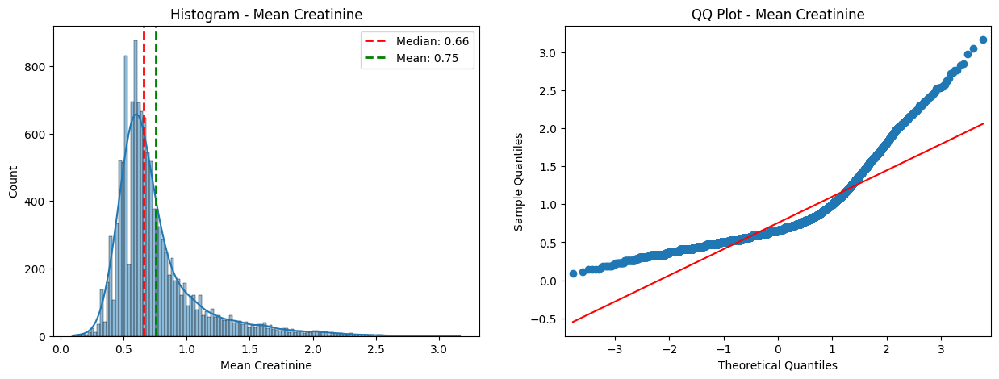

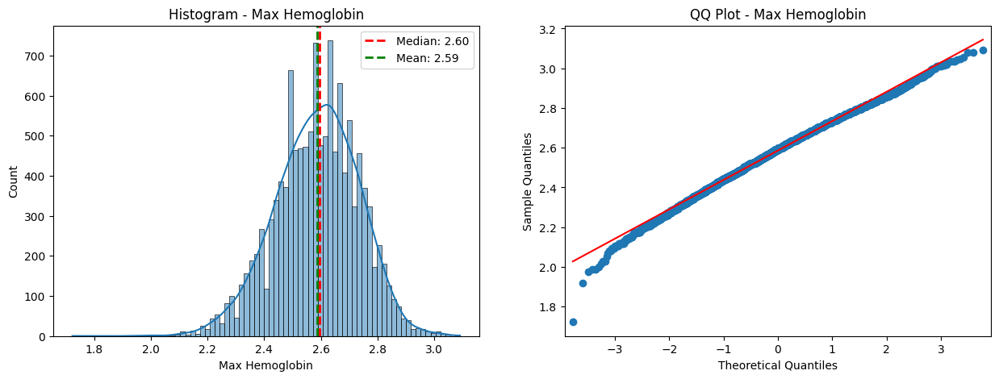

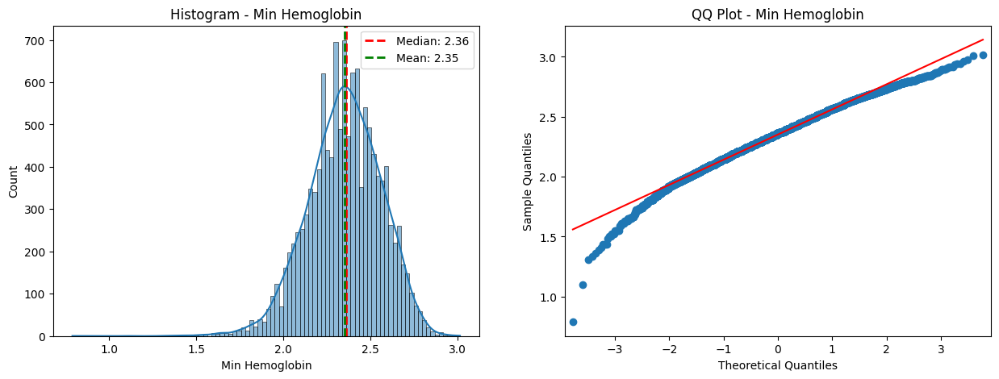

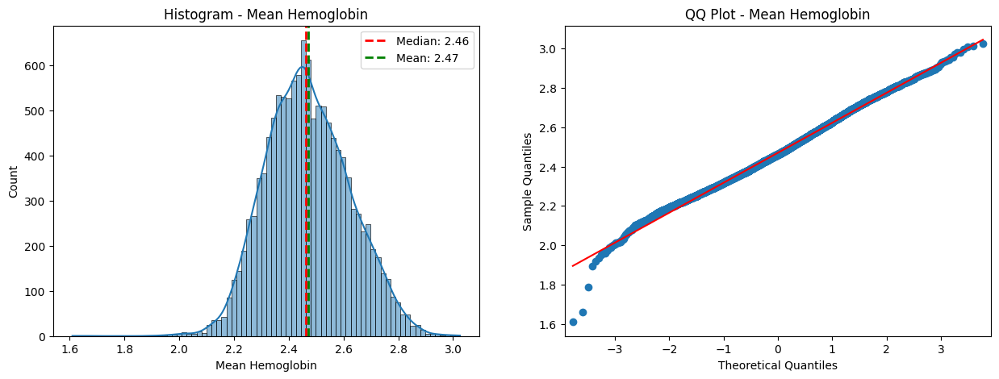

In [52]:
for column in log_transformed_data.columns:
    if column != 'Hospital Mortality':
        plot_histogram_qqplot(log_transformed_data, column)

#### Shapiro Wilk Test After Log Transformation

Applied Shapiro Wilk test on the normalized data using log transformation. The result still shows that the data are not normally distruted however visual inspection tells us otherwise.

In [53]:
# Perform Shapiro-Wilk test on each column in log_transformed_data
for column in log_transformed_data.columns[1:]:
    stat, p = stats.shapiro(log_transformed_data[column])
    print(f"Shapiro-Wilk test for {column}:")
    print(f"  Statistic: {stat}")
    print(f"  p-value: {p}")
    print("")

    if p < 0.05:
        print(f"The distribution of {column} is significantly different from normal.")
        print("---------------------------------------------------------------------")
    else:
        print(f"The distribution of {column} is not significantly different from normal.")
        print("---------------------------------------------------------------------")

Shapiro-Wilk test for Age:
  Statistic: 0.8753691911697388
  p-value: 0.0

The distribution of Age is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Max Heart Rate:
  Statistic: 0.9981642365455627
  p-value: 4.8528583929119407e-11

The distribution of Max Heart Rate is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Min Heart Rate:
  Statistic: 0.8807404041290283
  p-value: 0.0

The distribution of Min Heart Rate is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Mean Heart Rate:
  Statistic: 0.9987273216247559
  p-value: 2.0667322075951233e-08

The distribution of Mean Heart Rate is significantly different from normal.
---------------------------------------------------------------------
Shapiro-Wilk test for Max MAP:
  Statistic: 0.882729649543

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


### L2 Normalization <a name='l2'>

L2 Normalization cannot normalize the data for statistical tests.

In [54]:
X = cont_all_df.to_numpy()
norms = np.linalg.norm(X, axis=0)
normalized_data = X / norms
normalized_df = pd.DataFrame(normalized_data, columns=cont_all_df.columns)


In [55]:
normalized_df.head()

,Hospital Mortality,Age,Max Heart Rate,Min Heart Rate,Mean Heart Rate,Max MAP,Min MAP,Mean MAP,Max Systolic Pressure,Min Systolic Pressure,Mean Systolic Pressure,Max Diastolic Pressure,Min Diastolic Pressure,Mean Diastolic Pressure,Max Temperature,Min Temperature,Mean Temperature,Max Lactate,Min Lactate,Mean Lactate,Max pH,Min pH,Mean pH,Max Glucose,Min Glucose,Mean Glucose,Max WBC,Min WBC,Mean WBC,Max BUN,Min BUN,Mean BUN,Max Creatinine,Min Creatinine,Mean Creatinine,Max Hemoglobin,Min Hemoglobin,Mean Hemoglobin
0,0.000000,0.010717,0.013675,0.009115,0.011144,0.020411,0.006102,0.008584,0.012558,0.006451,0.007799,0.007731,0.005592,0.008140,0.008910,0.008987,0.008956,0.018049,0.008220,0.013812,0.009139,0.008911,0.008942,0.012649,0.007068,0.013003,0.011270,0.007406,0.009490,0.014316,0.013204,0.013219,0.014234,0.013160,0.013121,0.009110,0.006999,0.008081
1,0.021527,0.005846,0.009036,0.009965,0.009222,0.010402,0.010220,0.011210,0.012558,0.010684,0.012072,0.011178,0.010584,0.011617,0.008979,0.008813,0.008967,0.005538,0.007437,0.006608,0.008946,0.009071,0.009003,0.007530,0.010019,0.008889,0.006328,0.004916,0.005828,0.004592,0.005153,0.004874,0.006227,0.006580,0.006437,0.010960,0.011576,0.011349
2,0.021527,0.010021,0.008547,0.008629,0.008557,0.008669,0.011135,0.010003,0.009549,0.009878,0.009713,0.008253,0.010984,0.009479,0.008926,0.008813,0.008863,0.030971,0.007828,0.027312,0.008850,0.008617,0.008748,0.008080,0.006835,0.009713,0.003880,0.005112,0.004453,0.010535,0.009017,0.009896,0.007562,0.007128,0.007427,0.009466,0.006999,0.008234
3,0.021527,0.010021,0.004396,0.005833,0.005107,0.007802,0.009610,0.009064,0.008449,0.008567,0.008647,0.007731,0.009586,0.008754,0.008781,0.009144,0.008945,0.003077,0.005480,0.004112,0.008995,0.009157,0.009076,0.004907,0.007844,0.006302,0.003187,0.004522,0.003794,0.003512,0.003542,0.003545,0.004003,0.003838,0.003961,0.007544,0.009512,0.008532
4,0.000000,0.010578,0.010501,0.011059,0.010526,0.006935,0.008136,0.008279,0.006597,0.006753,0.007143,0.007940,0.007589,0.009108,0.008979,0.008592,0.008840,0.005743,0.010959,0.007941,0.008814,0.008985,0.008893,0.005796,0.007301,0.006678,0.008406,0.011929,0.010006,0.014857,0.013526,0.014326,0.011565,0.009870,0.010893,0.008896,0.011217,0.010061


#### Visualization after L2 Normalization

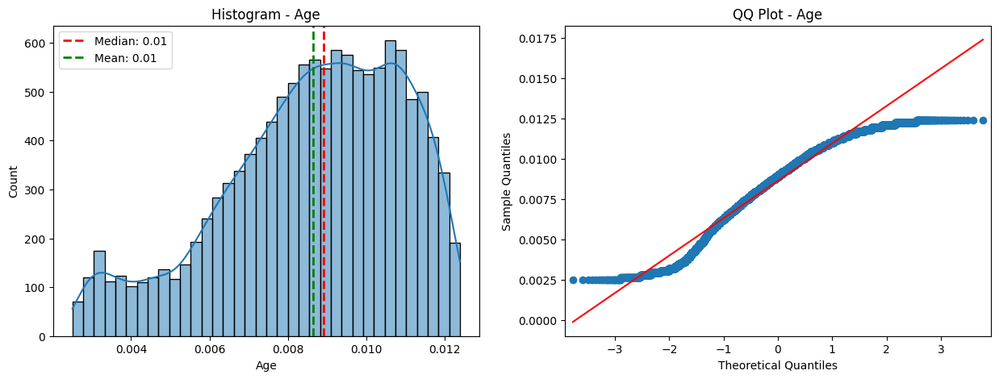

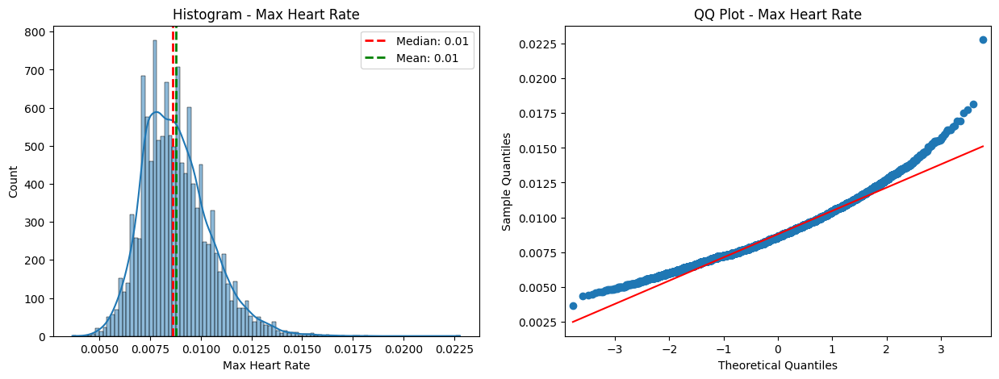

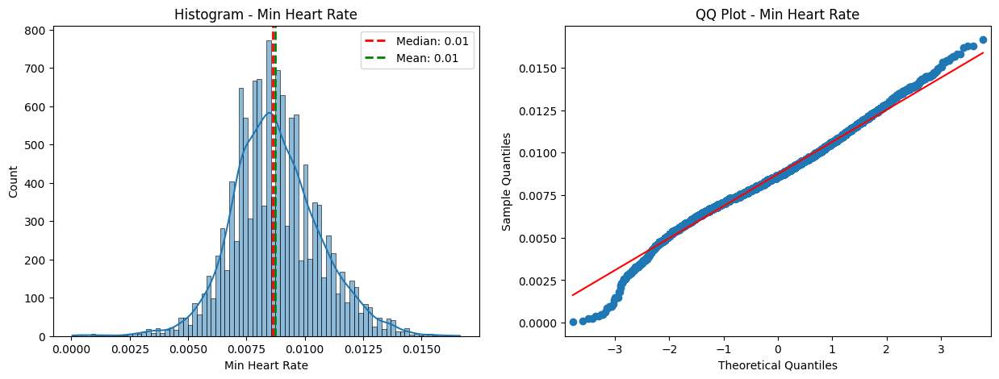

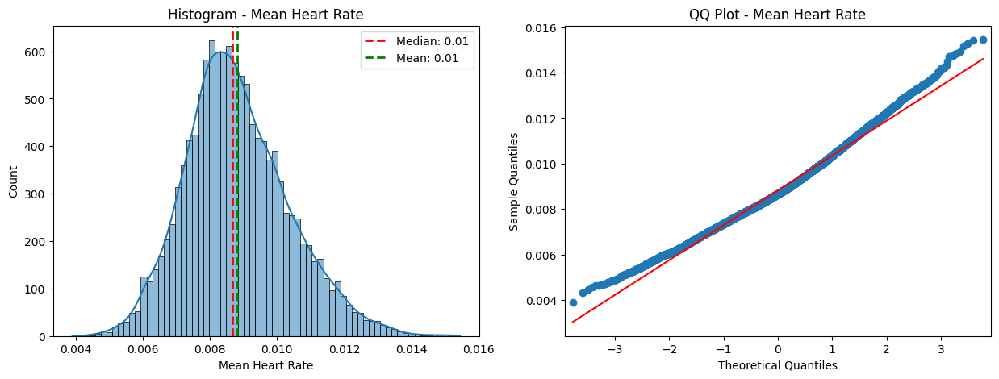

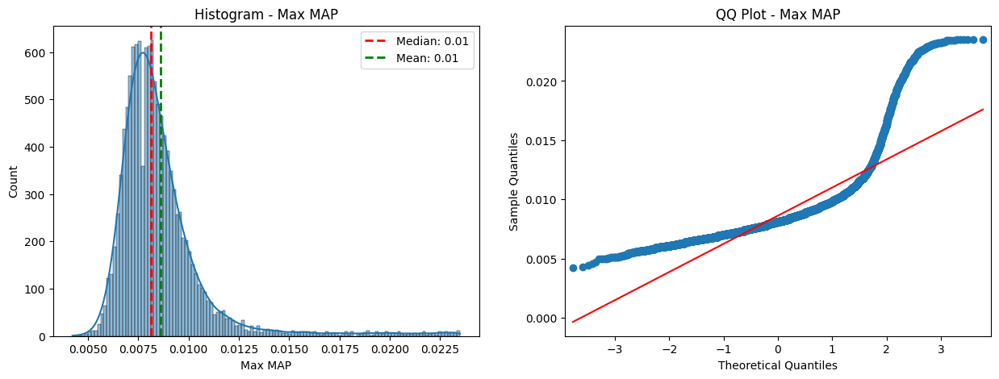

...

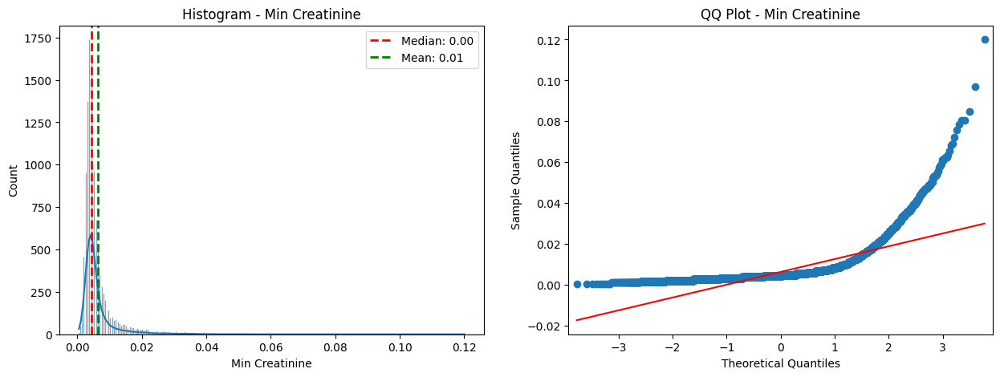

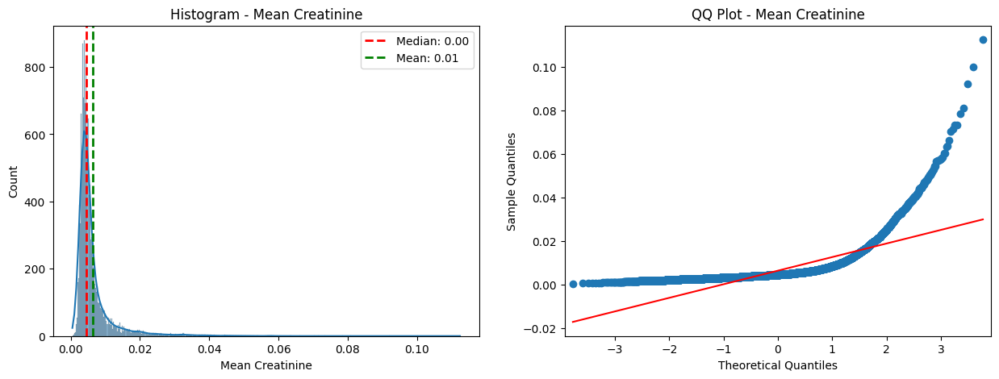

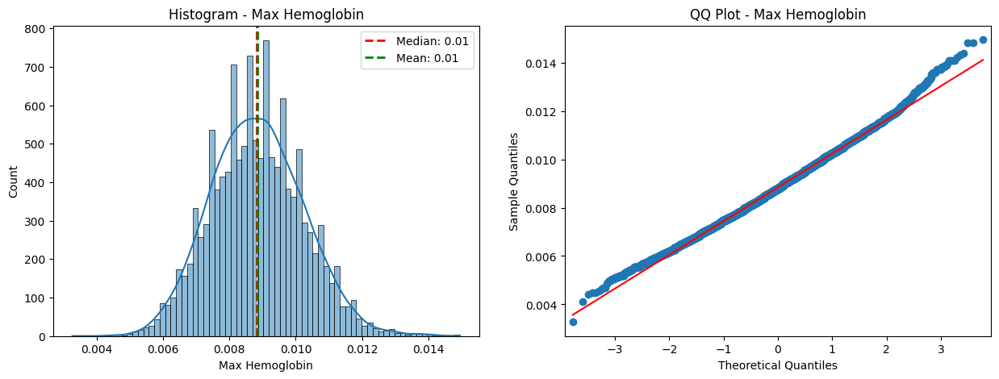

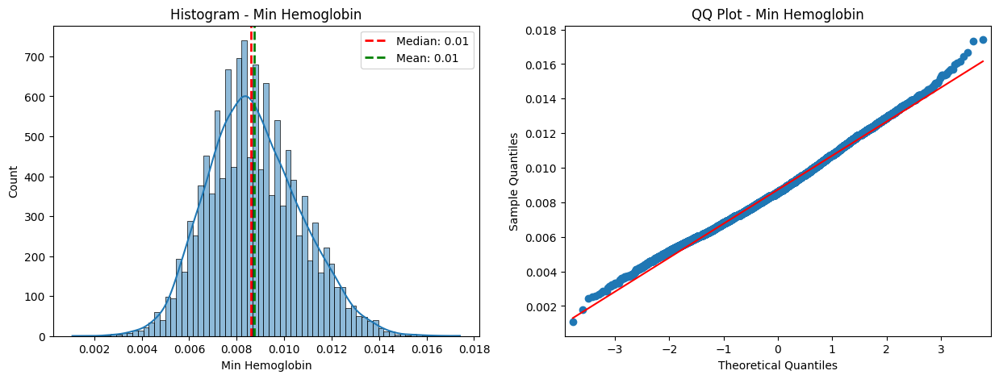

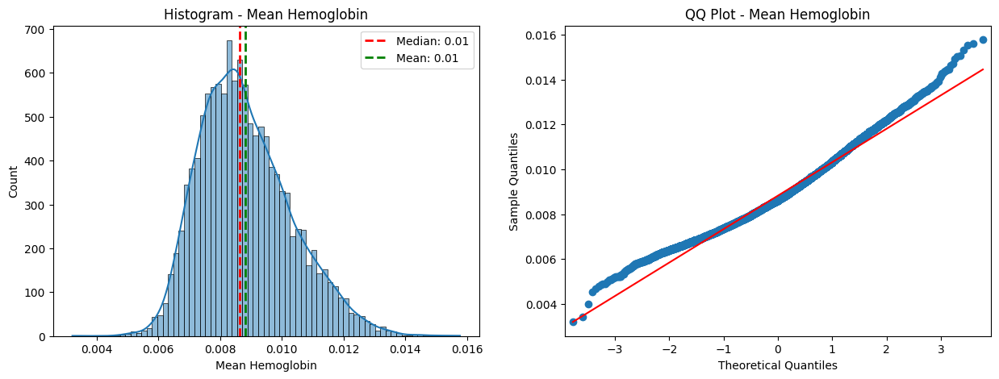

In [56]:
for column in normalized_df.columns:
    if column != 'Hospital Mortality':
        plot_histogram_qqplot(normalized_df, column)

## BoxCox Method <a name='boxcox'>

In [57]:
# Apply Box-Cox transformation to all numeric columns
box_cox_data = cont_all_df.copy()  # Create a copy of the original DataFrame

# Define a function to apply Box-Cox transformation
def apply_boxcox(x):
    # Skip non-numeric columns
    if not pd.api.types.is_numeric_dtype(x):
        return x

    # Check if the column contains any zero or negative values
    if (x <= 0).any():
        # Add a small constant to ensure all values are strictly positive
        x += np.abs(x.min()) + 1e-6

    # Apply Box-Cox transformation
    transformed_data, _ = boxcox(x)
    return transformed_data

# Apply the function to all columns using applymap
box_cox_df = box_cox_data.applymap(apply_boxcox)

# Now transformed_df contains Box-Cox transformed values for all numeric columns

#### Visualization After BoxCox Method

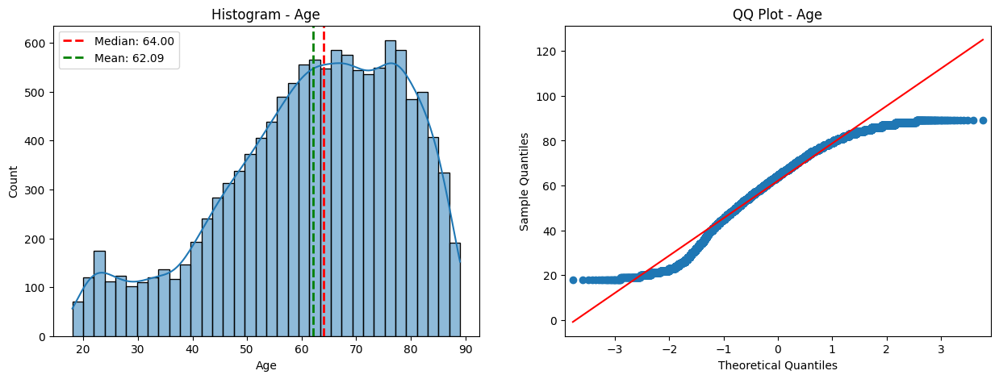

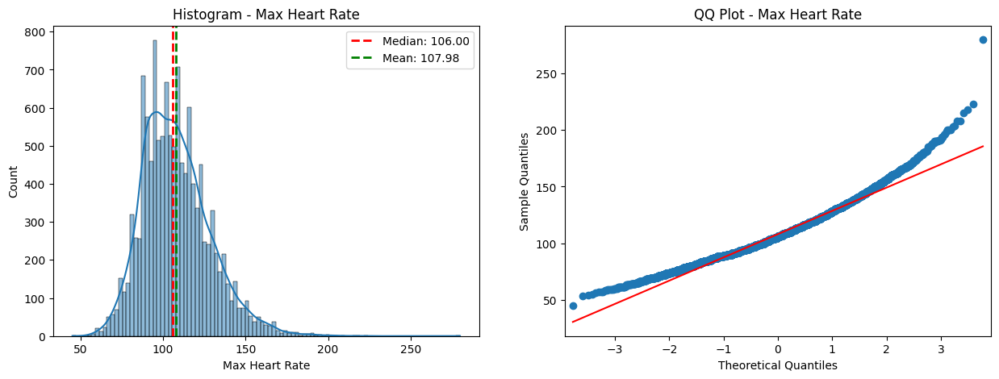

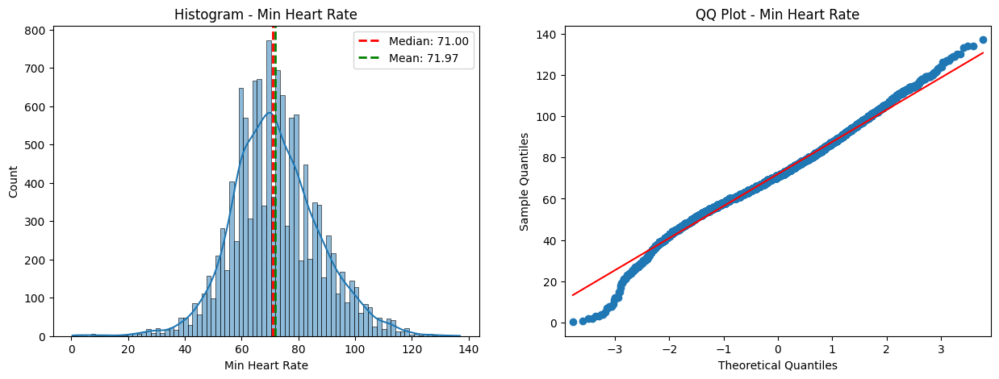

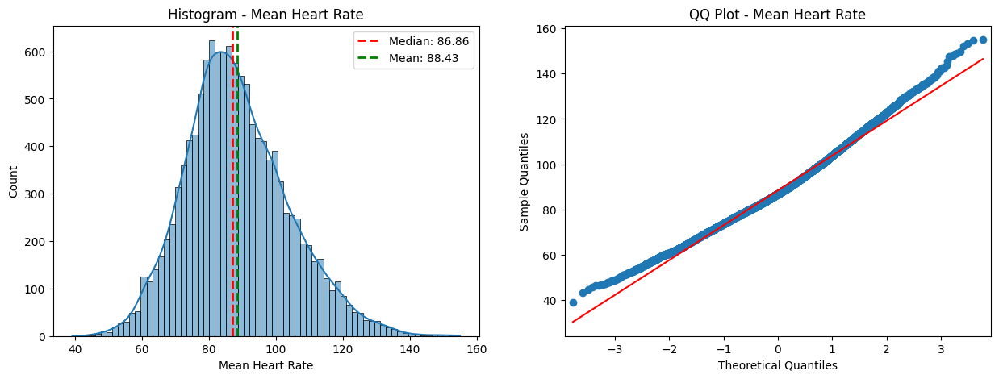

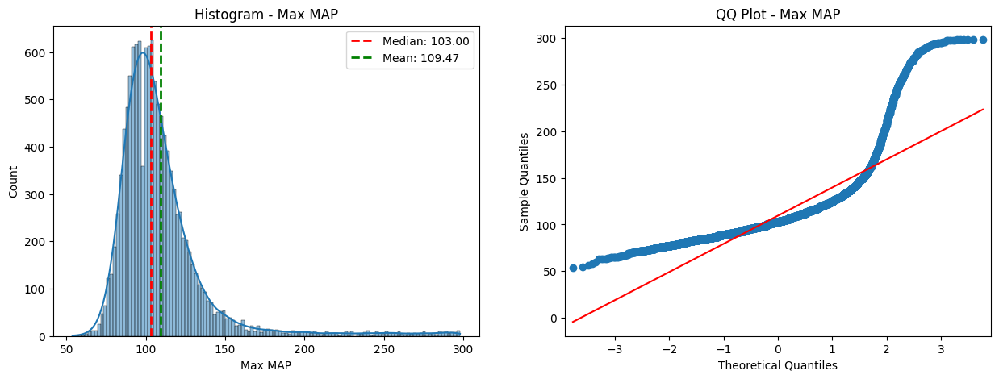

...

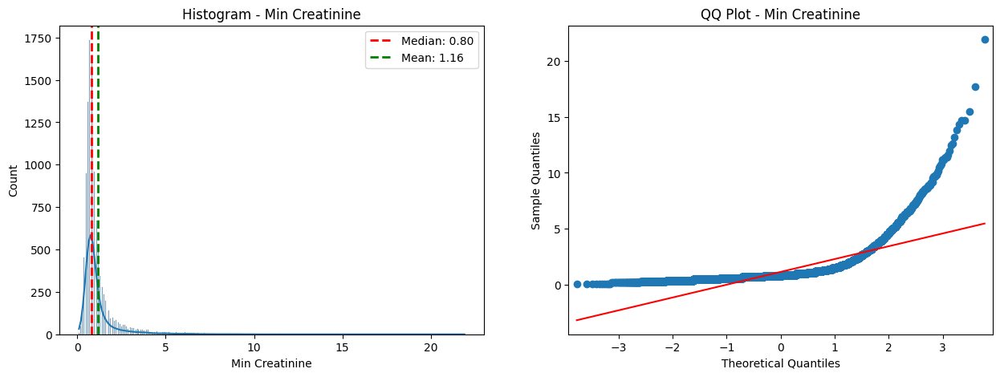

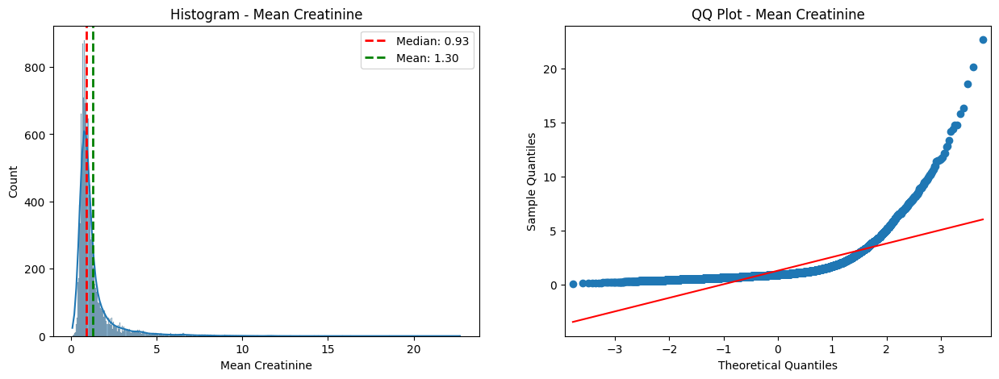

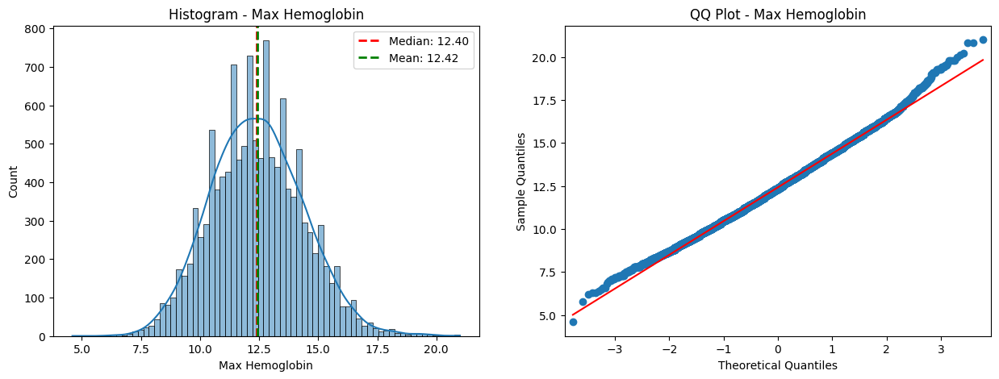

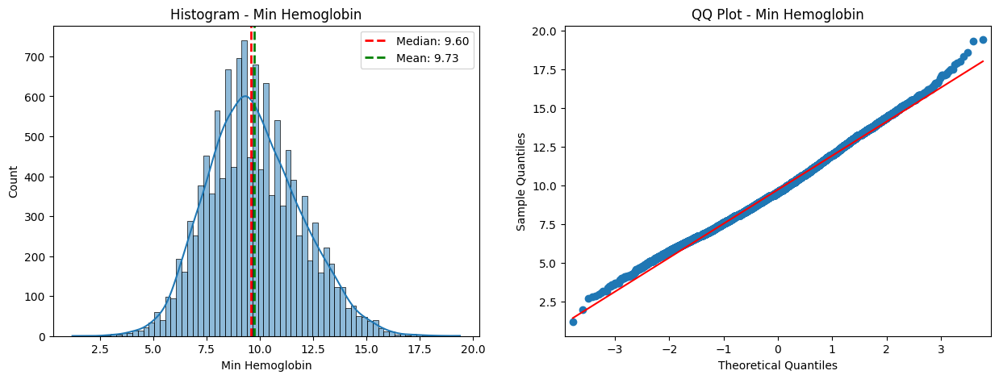

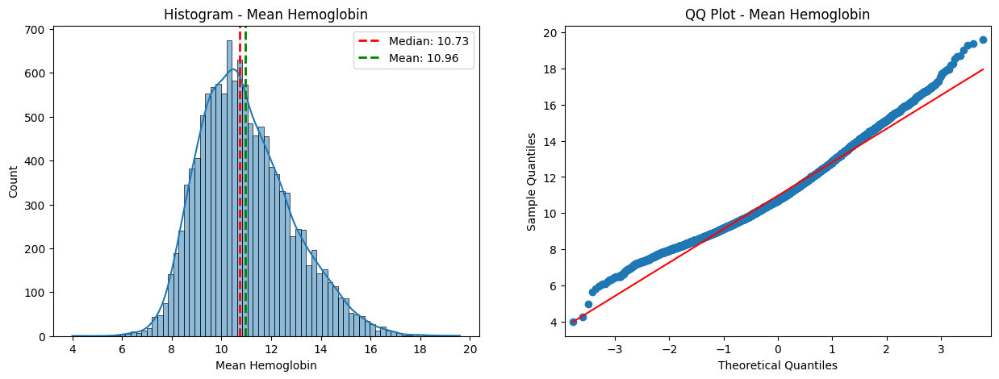

In [58]:
for column in normalized_df.columns:
    if column != 'Hospital Mortality':
        plot_histogram_qqplot(box_cox_df, column)

## Min-Max Method <a name='minmax'>

In [59]:
scaler = MinMaxScaler()

# Apply Min-Max scaling to all columns
scaled_data = scaler.fit_transform(cont_all_df)

# Convert the scaled data array back to a DataFrame
scaled_df = pd.DataFrame(scaled_data, columns=cont_all_df.columns)

### Visualization After Min-Max Method

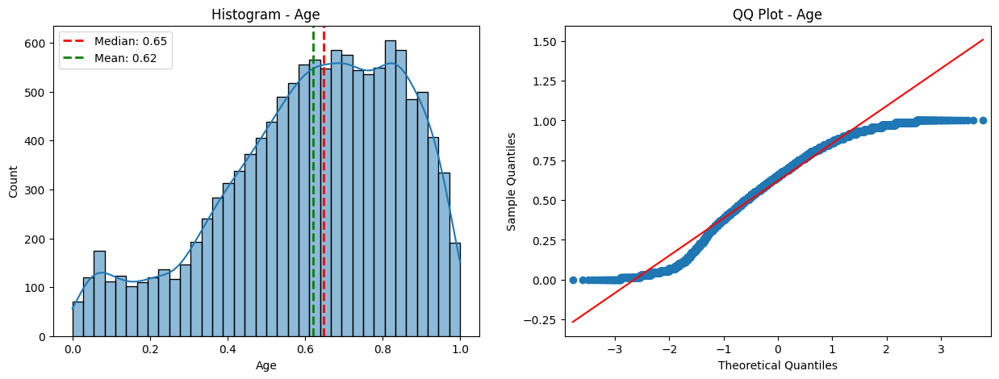

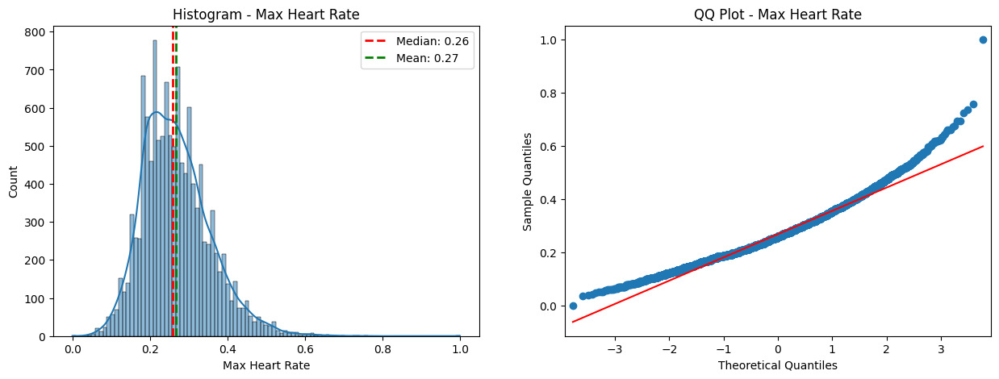

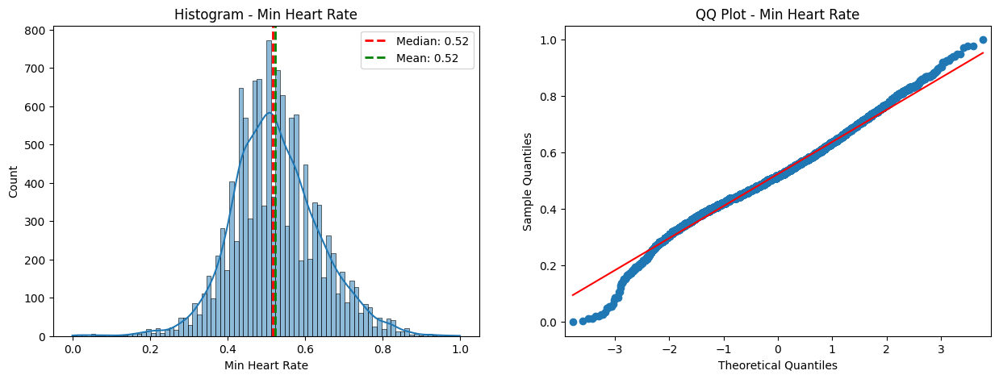

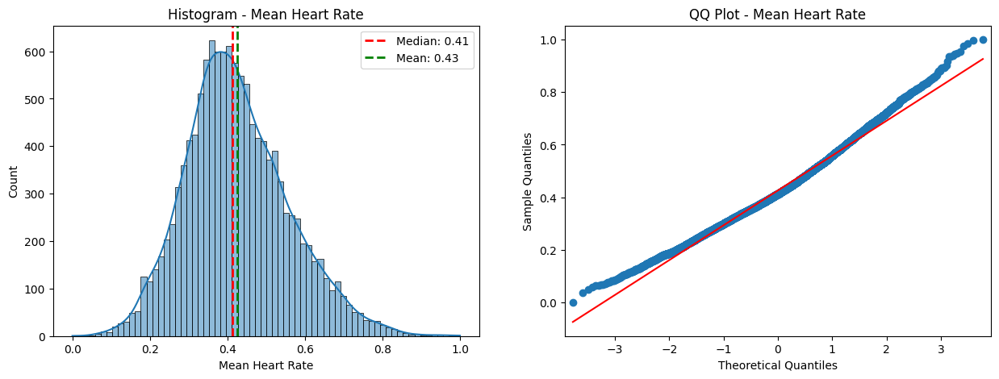

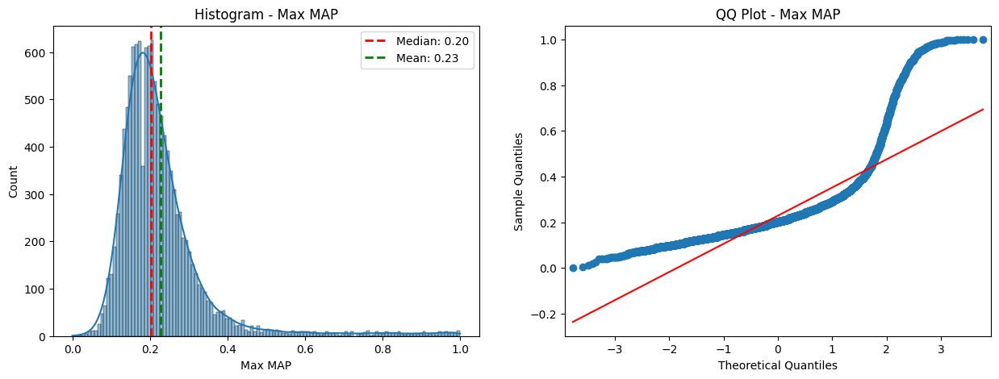

...

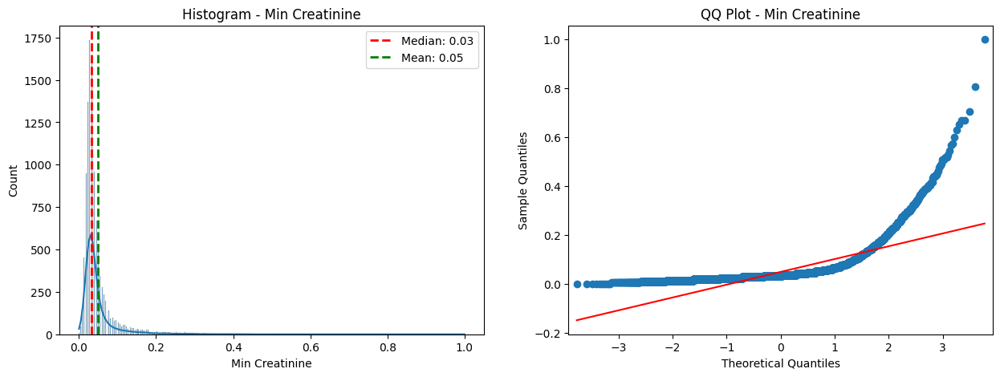

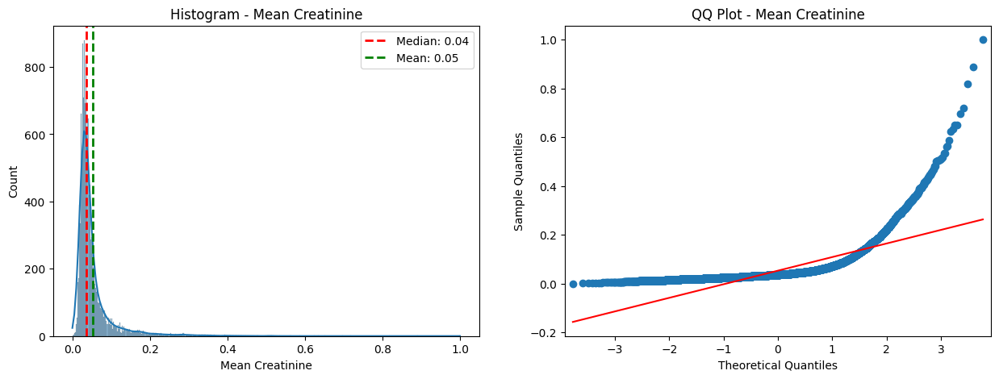

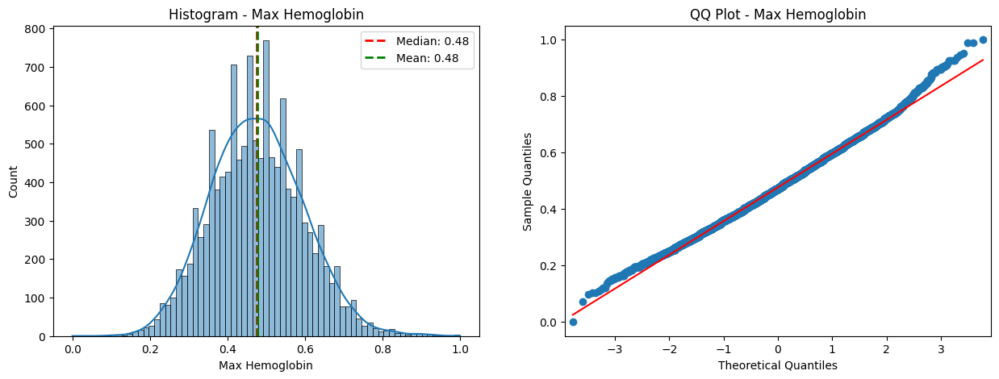

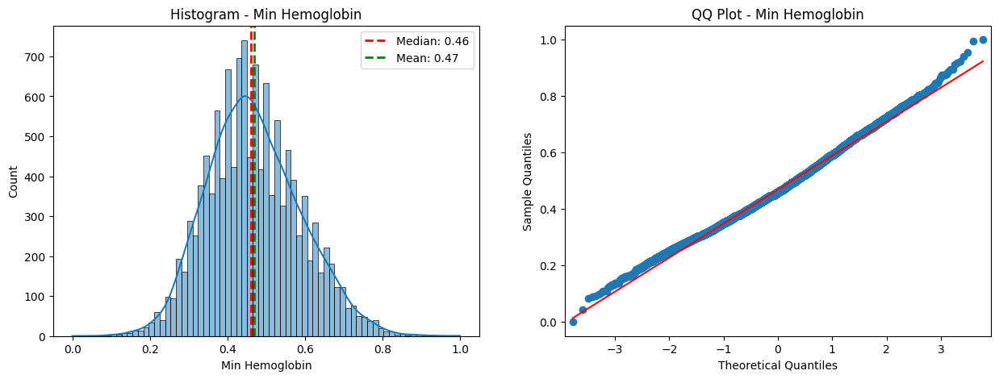

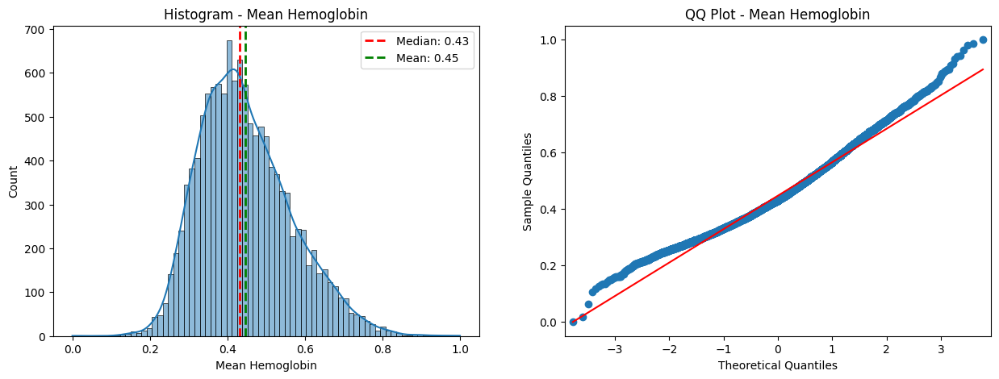

In [60]:
# Iterate through columns and create plots
for column in scaled_df.columns:
    if column != 'Hospital Mortality':  # Skip the target column
        plot_histogram_qqplot(scaled_df, column)

# Statistical Tests

In [61]:
# Create an empty dictionary to store results assuming not normal distribution
result_dict = {'Variable': [], 'Data_Type': [], 'Type_of_Test': [], 'P-value': []}

# Create an empty dictionary to store results assuming normal distribution
# result_dict_n = {'Variable': [], 'Data_Type': [], 'Type_of_Test': [], 'P-value': []}

## Continuous Variables<a name='contvar'>

### Independant t-Test <a name='ttest'>

If we use the dataset without the missing values, majority of results for the ttest are statistically significant. However, since the data are not normally distributed, we will use a nonpametric test.

---
**Assumptions of independent t-test**
- [x] Independence of the observations. Each subject should belong to only one group. There is no relationship between the observations in each group.
- [ ] No significant outliers in the two groups
- [ ] Normality. the data for each group should be approximately normally distributed. (Central Limit Theorem)
- [ ] Homogeneity of variances. the variance of the outcome variable should be equal in each group. Recall that, the Welch t-test does not make this assumptions.

#### Levene Test for homogeneity



*   H0: the variances of groups are equal
*   H1: the variances of groups are NOT equal

All columns return p value less than 0.05. This mean the variances of groups are NOT equal.

In [62]:
# Conduct a levene test on cont_all_df to test homogeneity of variances.

# Extract the numeric columns
numeric_cols = cont_all_df.select_dtypes(include=['int64', 'float64']).columns

# Initialize empty lists to store results
levene_results = []

# Loop through each numeric column
for col in numeric_cols:
    # Perform Levene's test
    levene_statistic, levene_pvalue = stats.levene(cont_all_df[col][cont_all_df['Hospital Mortality'] == 0], cont_all_df[col][cont_all_df['Hospital Mortality'] == 1])

    # Store the results
    if levene_pvalue > 0.05:
      levene_results.append({'Variable': col, 'Levene Statistic': levene_statistic, 'Levene p-value': levene_pvalue, 'Homogeneity': 'Yes'})
    else:
      levene_results.append({'Variable': col, 'Levene Statistic': levene_statistic, 'Levene p-value': levene_pvalue, 'Homogeneity': 'No'})

# Create a DataFrame to display the results
levene_df = pd.DataFrame(levene_results)

# Print the DataFrame
print(levene_df.to_string())


                   Variable  Levene Statistic  Levene p-value Homogeneity
0        Hospital Mortality               NaN             NaN          No
1                       Age          9.766476    1.781301e-03          No
2            Max Heart Rate        228.954740    2.867679e-51          No
3            Min Heart Rate        381.172645    1.214381e-83          No
4           Mean Heart Rate        242.538863    3.550201e-54          No
5                   Max MAP         51.127977    9.135754e-13          No
6                   Min MAP        280.885248    2.308827e-62          No
7                  Mean MAP        128.331355    1.324610e-29          No
8     Max Systolic Pressure        151.111596    1.568772e-34          No
9     Min Systolic Pressure        309.132049    2.244147e-68          No
10   Mean Systolic Pressure        225.880693    1.306078e-50          No
11   Max Diastolic Pressure         67.658065    2.136216e-16          No
12   Min Diastolic Pressure        167

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:3189: RuntimeWarning: invalid value encountered in scalar divide
  W = numer / denom


#### Welch's t-test

In [63]:
tranformed_log = log_transformed_data.copy()
welch_data = tranformed_log[['Hospital Mortality', 'Max Heart Rate', 'Mean Heart Rate', 'Mean MAP', 'Mean Systolic Pressure', 'Mean Diastolic Pressure', 'Mean BUN', 'Max Hemoglobin', 'Mean Hemoglobin']]


In [64]:
tranformed_log['Hospital Mortality'].value_counts()

0    10331
1     2158
Name: Hospital Mortality, dtype: int64

In [65]:
# prompt: perform a welch's t-test on cont_all_df ['Hospital Mortality'] == 0 and cont_all_df ['Hospital Mortality'] == 1

for column in welch_data.columns[1:]:
    t_statistic, p_value = stats.ttest_ind(welch_data[column][welch_data['Hospital Mortality'] == 0], welch_data[column][welch_data['Hospital Mortality'] == 1], equal_var=False)
    print(column)
    # Print or use the results as needed
    print(f"Welch's T-test for {column}:")
    print(f"  T-statistic: {t_statistic}")
    print(f"  P-value: {p_value}")
    print("")

    if p_value < 0.05:
        print(f"The difference in {column} between survivors and non-survivors is statistically significant.")
        print("---------------------------------------------------------------------")
    else:
        print(f"There is no significant difference in {column} between survivors and non-survivors.")
        print("---------------------------------------------------------------------")

    result_dict['Variable'].append(column)
    result_dict['Data_Type'].append('Continuous')
    result_dict['Type_of_Test'].append('Welch\'s T-test')
    result_dict['P-value'].append(p_value)



Max Heart Rate
Welch's T-test for Max Heart Rate:
  T-statistic: -14.425352999038484
  P-value: 1.5137029803818268e-45

The difference in Max Heart Rate between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Mean Heart Rate
Welch's T-test for Mean Heart Rate:
  T-statistic: -9.820534110448351
  P-value: 2.1132933705136722e-22

The difference in Mean Heart Rate between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Mean MAP
Welch's T-test for Mean MAP:
  T-statistic: 9.963466996165206
  P-value: 5.409360708044105e-23

The difference in Mean MAP between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Mean Systolic Pressure
Welch's T-test for Mean Systolic Pressure:
  T-statistic: 11.317210031572678
  P-value: 4.935026168815372e-29

The difference in 

### Mann-Whitney U test

In [66]:
columns_to_exclude = ['Mean Heart Rate', 'Max Heart Rate','Mean MAP', 'Mean Systolic Pressure', 'Mean Diastolic Pressure', 'Mean BUN', 'Max Hemoglobin', 'Mean Hemoglobin']

# Dropping the specified columns
mann_cont_data = cont_all_df.drop(columns=columns_to_exclude)

In [67]:
# Separate data into two groups based on target
survivors = mann_cont_data[mann_cont_data['Hospital Mortality'] == 0]
non_survivors = mann_cont_data[mann_cont_data['Hospital Mortality'] == 1]

# Perform Mann-Whitney U test for each numerical column
for column in mann_cont_data.columns[1:]:
    stat, p = stats.mannwhitneyu(survivors[column], non_survivors[column])
    print(column)
    # Print or use the results as needed
    print(f"Mann-Whitney U test for {column}:")
    print(f"  Statistic: {stat}")
    print(f"  P-value: {p}")
    print("")

    if p < 0.05:
        print(f"The difference in {column} between survivors and non-survivors is statistically significant.")
        print("---------------------------------------------------------------------")
    else:
        print(f"There is no significant difference in {column} between survivors and non-survivors.")
        print("---------------------------------------------------------------------")

    # Append results to the dictionary
    result_dict['Variable'].append(column)
    result_dict['Data_Type'].append('Continuous')
    result_dict['Type_of_Test'].append('Mann-Whitney U')
    result_dict['P-value'].append(p)


Age
Mann-Whitney U test for Age:
  Statistic: 8525675.5
  P-value: 2.1525320528626538e-66

The difference in Age between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Min Heart Rate
Mann-Whitney U test for Min Heart Rate:
  Statistic: 11076044.0
  P-value: 0.6405817553911917

There is no significant difference in Min Heart Rate between survivors and non-survivors.
---------------------------------------------------------------------
Max MAP
Mann-Whitney U test for Max MAP:
  Statistic: 11096635.5
  P-value: 0.7401547602044709

There is no significant difference in Max MAP between survivors and non-survivors.
---------------------------------------------------------------------
Min MAP
Mann-Whitney U test for Min MAP:
  Statistic: 14278470.0
  P-value: 5.902742296218549e-94

The difference in Min MAP between survivors and non-survivors is statistically significant.
-----------------------------------------

The following Mann-Whitney test is conducted for the variables that became normally dristributed after doing the log transformation. We created this subset to compare the result with the Welch T-Test results.

In [68]:
subset_welch = cont_all_df.copy()
MW_comparison = subset_welch[['Hospital Mortality', 'Max Heart Rate', 'Mean Heart Rate', 'Mean MAP', 'Mean Systolic Pressure', 'Mean Diastolic Pressure', 'Mean BUN', 'Max Hemoglobin', 'Mean Hemoglobin']]

# Separate data into two groups based on target
survivors = MW_comparison[MW_comparison['Hospital Mortality'] == 0]
non_survivors = MW_comparison[MW_comparison['Hospital Mortality'] == 1]

# Perform Mann-Whitney U test for each numerical column
for column in MW_comparison.columns[1:]:
    stat, p = stats.mannwhitneyu(survivors[column], non_survivors[column])
    print(column)
    # Print or use the results as needed
    print(f"Mann-Whitney U test for {column}:")
    print(f"  Statistic: {stat}")
    print(f"  P-value: {p}")
    print("")

    if p < 0.05:
        print(f"The difference in {column} between survivors and non-survivors is statistically significant.")
        print("---------------------------------------------------------------------")
    else:
        print(f"There is no significant difference in {column} between survivors and non-survivors.")
        print("---------------------------------------------------------------------")

Max Heart Rate
Mann-Whitney U test for Max Heart Rate:
  Statistic: 8640638.5
  P-value: 7.524132792815273e-61

The difference in Max Heart Rate between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Mean Heart Rate
Mann-Whitney U test for Mean Heart Rate:
  Statistic: 9409815.0
  P-value: 3.947274866302104e-30

The difference in Mean Heart Rate between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Mean MAP
Mann-Whitney U test for Mean MAP:
  Statistic: 12733640.5
  P-value: 2.1228661641088843e-25

The difference in Mean MAP between survivors and non-survivors is statistically significant.
---------------------------------------------------------------------
Mean Systolic Pressure
Mann-Whitney U test for Mean Systolic Pressure:
  Statistic: 13073048.5
  P-value: 1.224837336030013e-36

The difference in Mean Systolic Pressure 

### Spearman Correlation

In [69]:
# # Create an empty dictionary to store the correlation results
# corr_results_cont = {'Variable_1': [], 'Variable_2': [], 'Correlation': [], 'Group': []}
# cols_to_exclude_s = [col for col in cont_all_df.columns if 'Min_x' in col or 'Max_x' in col]
# spearman_matrix = cont_all_df.drop(cols_to_exclude_s, axis=1)

# # Iterate over the ordinal variables, excluding 'Hospital Mortality'
# for col1 in spearman_matrix.columns[1:-1]:
#     for col2 in spearman_matrix.columns[2:]:
#         if col1 != col2:
#             # Separate data into two groups based on target
#             survivors = spearman_matrix[spearman_matrix['Hospital Mortality'] == 0]
#             non_survivors = spearman_matrix[spearman_matrix['Hospital Mortality'] == 1]

#             # Calculate Spearman's correlation coefficient for each group
#             corr_survivors, _ = stats.spearmanr(survivors[col1], survivors[col2])
#             corr_non_survivors, _ = stats.spearmanr(non_survivors[col1], non_survivors[col2])

#             # Store the results
#             corr_results_cont['Variable_1'].append(col1)
#             corr_results_cont['Variable_2'].append(col2)
#             corr_results_cont['Correlation'].append(corr_survivors)
#             corr_results_cont['Group'].append('Survivors')

#             corr_results_cont['Variable_1'].append(col1)
#             corr_results_cont['Variable_2'].append(col2)
#             corr_results_cont['Correlation'].append(corr_non_survivors)
#             corr_results_cont['Group'].append('Non-Survivors')

# # Create a DataFrame from the results
# corr_df_cont = pd.DataFrame(corr_results_cont)

# # Print the DataFrame
# # print(corr_df_cont)

# import pandas as pd
# from scipy import stats

# Create an empty dictionary to store the correlation results
corr_results_cont = {'Variable_1': [], 'Variable_2': [], 'Test': [],'Correlation': [], 'P_Value': [], 'Group': []}
cols_to_exclude_s = [col for col in cont_all_df.columns if 'Min_x' in col or 'Max_x' in col]
spearman_matrix = cont_all_df.drop(cols_to_exclude_s, axis=1)

# Iterate over the ordinal variables, excluding 'Hospital Mortality'
for col1 in spearman_matrix.columns[1:-1]:
    for col2 in spearman_matrix.columns[2:]:
        if col1 != col2:
            # Separate data into two groups based on target
            survivors = spearman_matrix[spearman_matrix['Hospital Mortality'] == 0]
            non_survivors = spearman_matrix[spearman_matrix['Hospital Mortality'] == 1]

            # Calculate Spearman's correlation coefficient and p-value for each group
            corr_survivors, p_survivors = stats.spearmanr(survivors[col1], survivors[col2])
            corr_non_survivors, p_non_survivors = stats.spearmanr(non_survivors[col1], non_survivors[col2])

            # Store the results
            corr_results_cont['Variable_1'].append(col1)
            corr_results_cont['Variable_2'].append(col2)
            corr_results_cont['Correlation'].append(corr_survivors)
            corr_results_cont['P_Value'].append(p_survivors)
            corr_results_cont['Group'].append('Survivors')
            corr_results_cont['Test'].append('Spearman')

            corr_results_cont['Variable_1'].append(col1)
            corr_results_cont['Variable_2'].append(col2)
            corr_results_cont['Correlation'].append(corr_non_survivors)
            corr_results_cont['P_Value'].append(p_non_survivors)
            corr_results_cont['Group'].append('Non-Survivors')
            corr_results_cont['Test'].append('Spearman')

# Create a DataFrame from the results
corr_df_cont = pd.DataFrame(corr_results_cont)




In [70]:
# filter by -1 to -.5 and .5 to 1

# Filter the correlation values
filtered_corr = corr_df_cont[(corr_df_cont['Correlation'] <= -0.5) | (corr_df_cont['Correlation'] >= 0.5)]
print(filtered_corr.shape)

# Sort the filtered results by Correlation in descending order
sorted_corr = filtered_corr.sort_values(by='Correlation', ascending=False)

sorted_corr['Correlation'] = sorted_corr['Correlation'].round(4)

sorted_corr['Second_Word_Variable_1'] = sorted_corr['Variable_1'].str.split().str[1]
sorted_corr['Second_Word_Variable_2'] = sorted_corr['Variable_2'].str.split().str[1]

sorted_corr = sorted_corr[sorted_corr['Second_Word_Variable_1'] != sorted_corr['Second_Word_Variable_2']]
print(sorted_corr.shape)

# Drop the helper column 'Second_Word_Variable_2'
sorted_corr = sorted_corr.drop(['Second_Word_Variable_2','Second_Word_Variable_1'], axis=1)

sorted_corr.reset_index(drop=True, inplace=True)

sorted_corr = sorted_corr[sorted_corr.index % 2 != 0]

print(sorted_corr.shape)

print(sorted_corr)



(204, 6)
(90, 8)
(45, 6)
                 Variable_1               Variable_2      Test  Correlation  \
1                  Mean MAP  Mean Diastolic Pressure  Spearman       0.8582   
3                  Mean MAP  Mean Diastolic Pressure  Spearman       0.8569   
5    Min Diastolic Pressure                  Min MAP  Spearman       0.8189   
7    Min Diastolic Pressure                  Min MAP  Spearman       0.8148   
9     Min Systolic Pressure                  Min MAP  Spearman       0.7987   
11                 Mean MAP   Mean Systolic Pressure  Spearman       0.7556   
13                  Max MAP   Max Diastolic Pressure  Spearman       0.7452   
15   Max Diastolic Pressure                  Max MAP  Spearman       0.7362   
17          Mean Creatinine                  Max BUN  Spearman       0.7351   
19          Mean Creatinine                 Mean BUN  Spearman       0.7328   
21           Min Creatinine                  Min BUN  Spearman       0.7320   
23                 Mean BUN

In [71]:

cont_spear_df = cont_all_df[["Hospital Mortality","Mean Diastolic Pressure", "Mean Systolic Pressure", "Mean BUN", "Mean Creatinine", "Mean MAP","Max Lactate","Min pH"]]

cont_spear_df.head(5)

,Hospital Mortality,Mean Diastolic Pressure,Mean Systolic Pressure,Mean BUN,Mean Creatinine,Mean MAP,Max Lactate,Min pH
0,0,55.720000,102.960000,44.75,2.65,75.692812,8.8,7.26
1,1,79.525000,159.375000,16.50,1.30,98.850000,2.7,7.39
2,1,64.885714,128.228571,33.50,1.50,88.200000,15.1,7.02
9,1,59.923077,114.153846,12.00,0.80,79.923077,1.5,7.46
13,0,62.350000,94.300000,48.50,2.20,73.000005,2.8,7.32


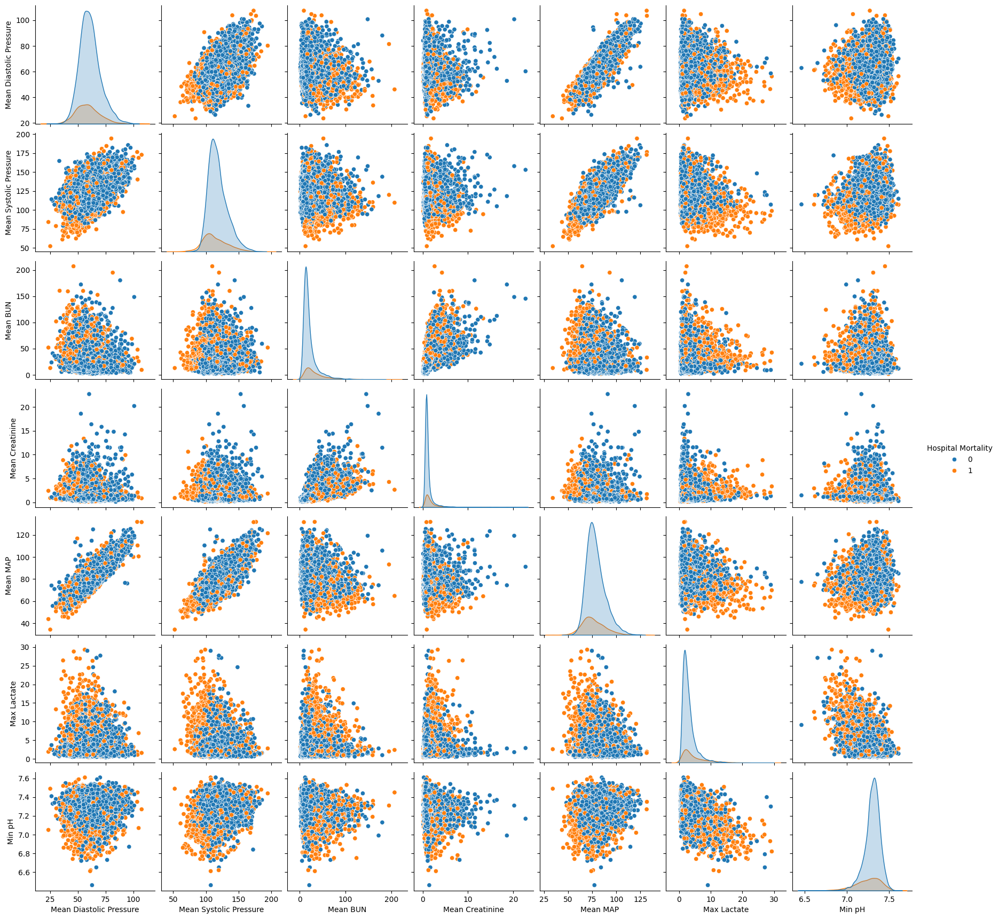

In [72]:

import seaborn as sns

sns.pairplot(data=cont_spear_df, hue="Hospital Mortality")
plt.show()


### Density plot of continuous variables

[Click here](#behavior)

## Ordinal Variables <a name='ordinal'>

### Mann-Whitney U test

In [73]:
for column in ordinal_df.columns:
    if column != 'Hospital Mortality':
        stat, p = stats.mannwhitneyu(ordinal_df[column][ordinal_df['Hospital Mortality'] == 0],
                                     ordinal_df[column][ordinal_df['Hospital Mortality'] == 1])
        print(f"Mann-Whitney U test for {column}:")
        print(f"  Statistic: {stat}")
        print(f"  p-value: {p}")
        print("---------------------------------------------------------------------")

            # Append results to the dictionary
        result_dict['Variable'].append(column)
        result_dict['Data_Type'].append('Ordinal')
        result_dict['Type_of_Test'].append('Mann-Whitney U')
        result_dict['P-value'].append(p)

        # result_dict_n['Variable'].append(column)
        # result_dict_n['Data_Type'].append('Ordinal')
        # result_dict_n['Type_of_Test'].append('Mann-Whitney U')
        # result_dict_n['P-value'].append(p)

Mann-Whitney U test for SAPS II:
  Statistic: 5016710.5
  p-value: 0.0
---------------------------------------------------------------------
Mann-Whitney U test for SOFA:
  Statistic: 6833386.5
  p-value: 3.564756196880308e-178
---------------------------------------------------------------------
Mann-Whitney U test for OASIS:
  Statistic: 5437509.0
  p-value: 6.727799650542416e-308
---------------------------------------------------------------------


### Spearman Correlation

Performed Spearman Correlation for the ordinal variables as supplementary

In [74]:


# Create an empty dictionary to store the correlation results
corr_results = {'Variable_1': [], 'Variable_2': [], 'Test': [], 'Correlation': [], 'P_value': [], 'Group': []}

# Iterate over the ordinal variables, excluding 'Hospital Mortality'
for col1 in ordinal_df.columns[1:-1]:
    for col2 in ordinal_df.columns[2:]:
        if col1 != col2:
            # Separate data into two groups based on target
            survivors = ordinal_df[ordinal_df['Hospital Mortality'] == 0]
            non_survivors = ordinal_df[ordinal_df['Hospital Mortality'] == 1]

            # Calculate Spearman's correlation coefficient and p-value for each group
            corr_survivors, p_value_survivors = stats.spearmanr(survivors[col1], survivors[col2])
            corr_non_survivors, p_value_non_survivors = stats.spearmanr(non_survivors[col1], non_survivors[col2])

            # Store the results
            corr_results['Variable_1'].extend([col1, col1])
            corr_results['Variable_2'].extend([col2, col2])
            corr_results['Correlation'].extend([corr_survivors, corr_non_survivors])
            corr_results['P_value'].extend([p_value_survivors, p_value_non_survivors])
            corr_results['Group'].extend(['Survivors', 'Non-Survivors'])
            corr_results['Test'].extend(['Spearman', 'Spearman'])

# Create a DataFrame from the results
corr_df = pd.DataFrame(corr_results)

# Print the DataFrame
print(corr_df)


  Variable_1 Variable_2      Test  Correlation        P_value          Group
0    SAPS II       SOFA  Spearman     0.596778   0.000000e+00      Survivors
1    SAPS II       SOFA  Spearman     0.675700  7.755076e-288  Non-Survivors
2    SAPS II      OASIS  Spearman     0.598171   0.000000e+00      Survivors
3    SAPS II      OASIS  Spearman     0.674522  1.814579e-286  Non-Survivors
4       SOFA      OASIS  Spearman     0.360364   0.000000e+00      Survivors
5       SOFA      OASIS  Spearman     0.453597  5.383949e-110  Non-Survivors


### Density plot of ordinal variables

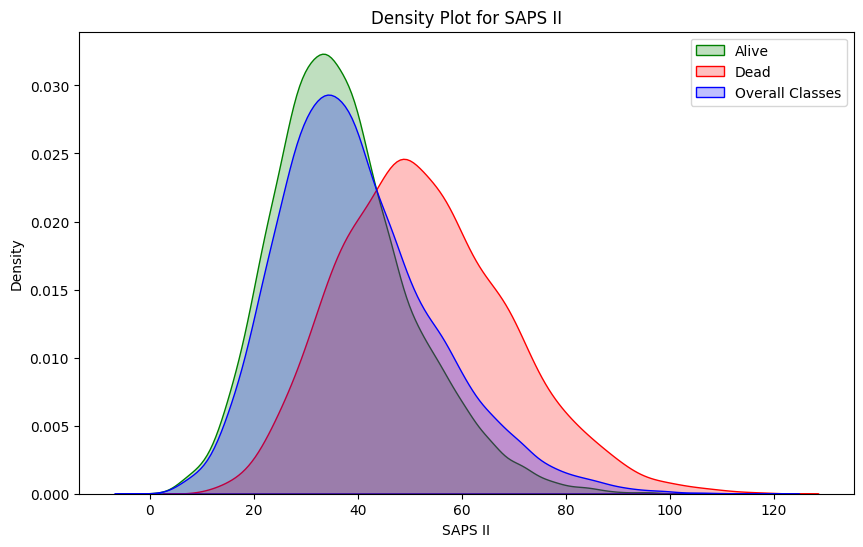

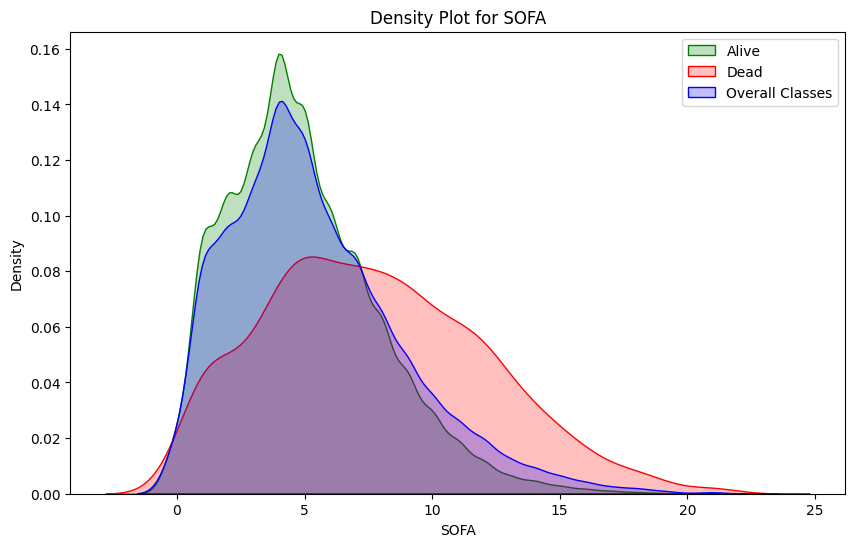

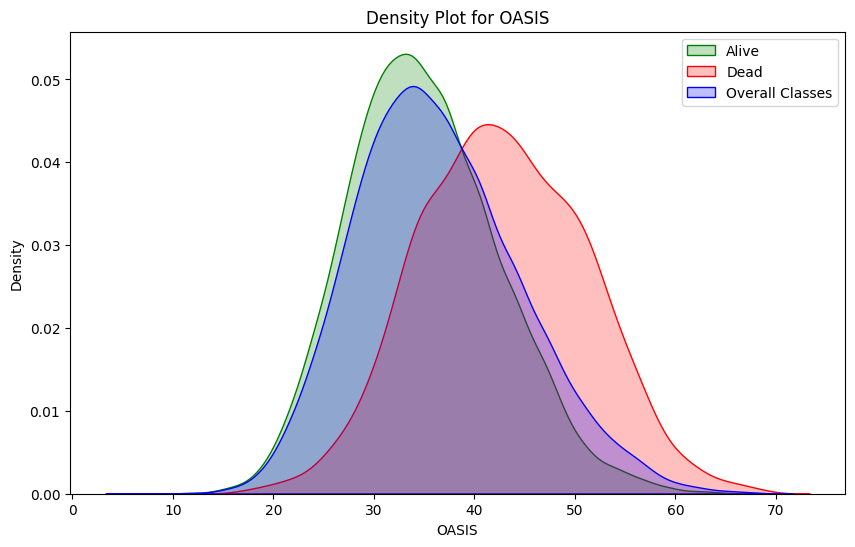

In [75]:
for column in ordinal_df.columns:
    if column != 'Hospital Mortality':
        # Create a figure and axes
        fig, ax = plt.subplots(figsize=(10, 6))

        # density plot for each group
        sns.kdeplot(data=df[df['Hospital Mortality'] == 0][column], ax = ax, label='Alive', fill=True, color = 'g')
        sns.kdeplot(data=df[df['Hospital Mortality'] == 1][column], ax = ax, label='Dead', fill=True, color = 'r')
        sns.kdeplot(data=df[column], label='Overall Classes',ax = ax, fill=True,color='b')


        plt.title(f'Density Plot for {column}')
        plt.xlabel(column)
        plt.ylabel('Density')

        plt.legend()


        plt.show()

### Scatter Plot

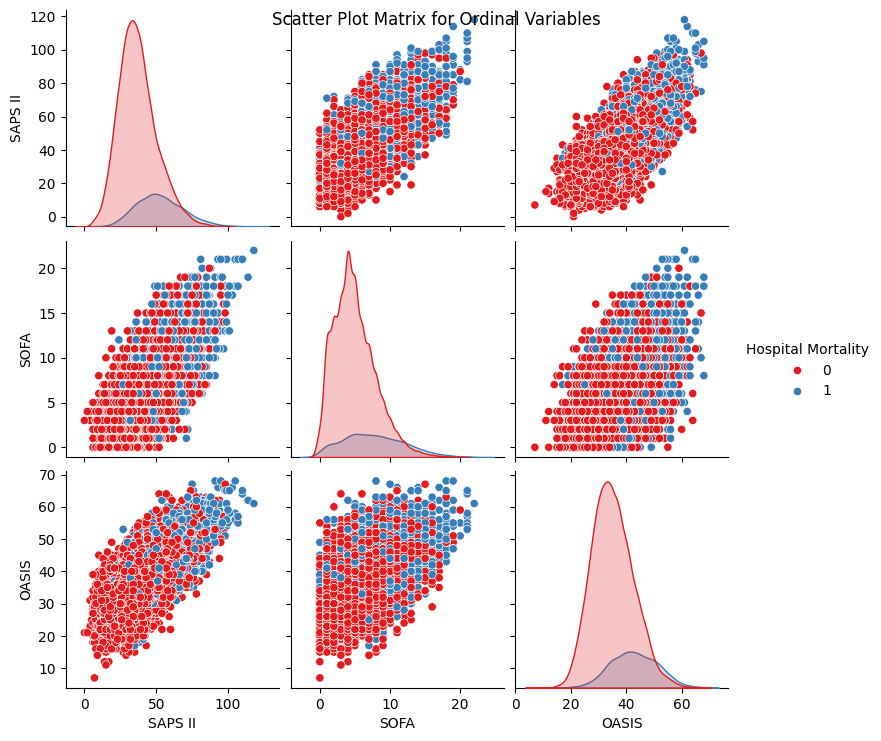

In [76]:


# Create a scatter plot matrix for ordinal_df
sns.pairplot(ordinal_df, hue='Hospital Mortality', palette='Set1')

# Set the title of the plot
plt.suptitle('Scatter Plot Matrix for Ordinal Variables')

# Display the plot
plt.show()


## Binary Variables <a name='binary'>

### Chi-Square test

In [77]:
for column in binary_df.columns[1:]:
    contingency_table = pd.crosstab(df['Hospital Mortality'], df[column])
    chi2, p, _, _ = chi2_contingency(contingency_table)
    print()
    print(contingency_table)
    print()
    print(f"Chi-square test between Hospital Mortality and {column}:")
    print(f"Chi2 value: {chi2}")
    print(f"P-value: {p}")
    print("--------------------------------------------------------")

    # Append results to the dictionary
    result_dict['Variable'].append(column)
    result_dict['Data_Type'].append('Categorical')
    result_dict['Type_of_Test'].append('Chi-Square')
    result_dict['P-value'].append(p)

    # result_dict_n['Variable'].append(column)
    # result_dict_n['Data_Type'].append('Categorical')
    # result_dict_n['Type_of_Test'].append('Chi-Square')
    # result_dict_n['P-value'].append(p)



Gender                 F     M
Hospital Mortality            
0                   3938  6393
1                    953  1205

Chi-square test between Hospital Mortality and Gender:
Chi2 value: 27.10758978619394
P-value: 1.9244091683381194e-07
--------------------------------------------------------

Uncomplicated Hypertension     0     1
Hospital Mortality                    
0                           5635  4696
1                           1366   792

Chi-square test between Hospital Mortality and Uncomplicated Hypertension:
Chi2 value: 55.189196979179414
P-value: 1.0946874261933157e-13
--------------------------------------------------------

Complicated Hypertension     0    1
Hospital Mortality                 
0                         9486  845
1                         1941  217

Chi-square test between Hospital Mortality and Complicated Hypertension:
Chi2 value: 7.838345176804054
P-value: 0.005114940941223975
--------------------------------------------------------

Uncomplica

#### Box Plot of binary variables

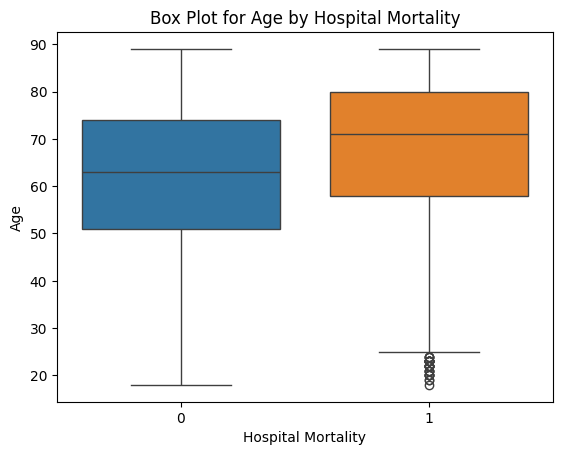

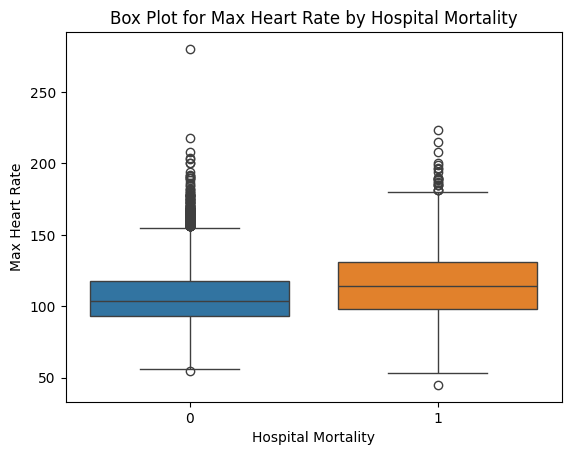

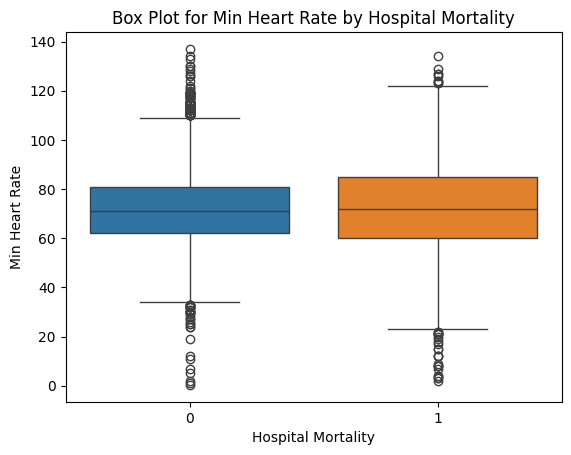

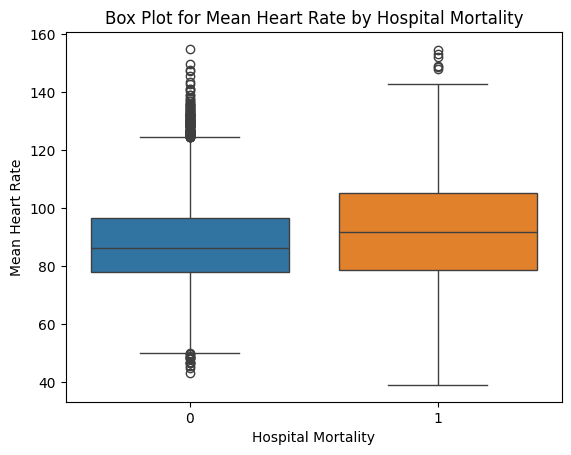

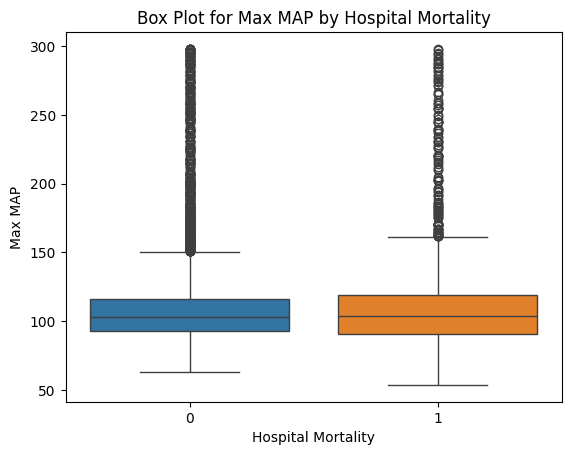

...

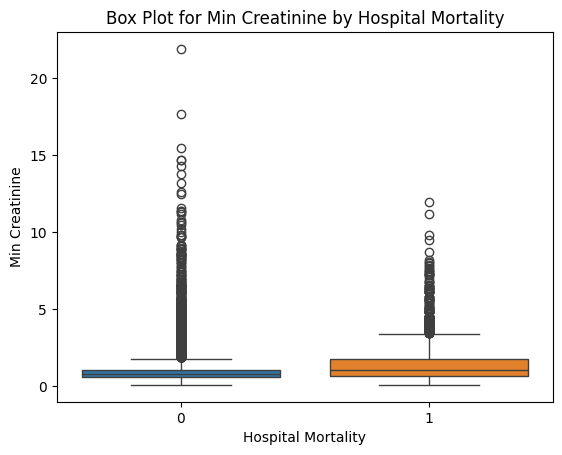

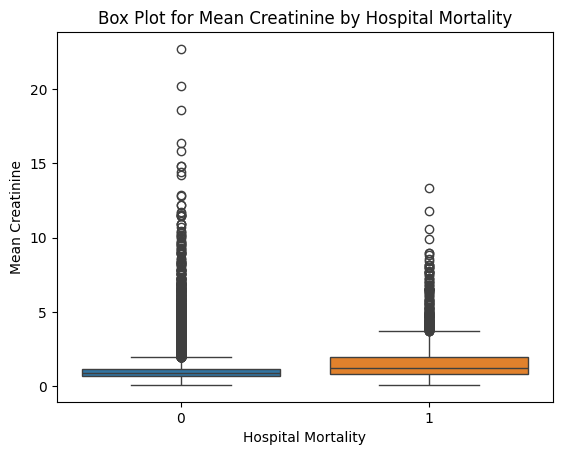

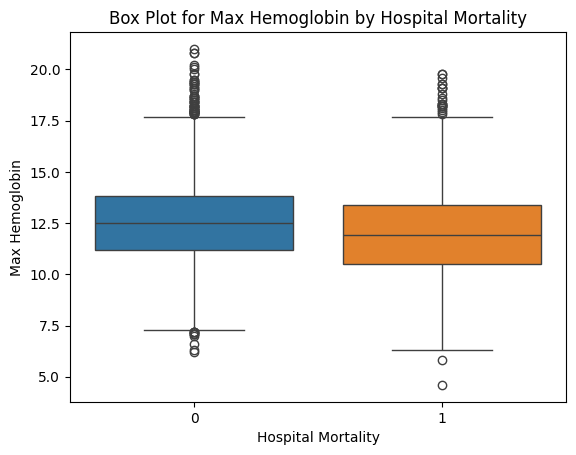

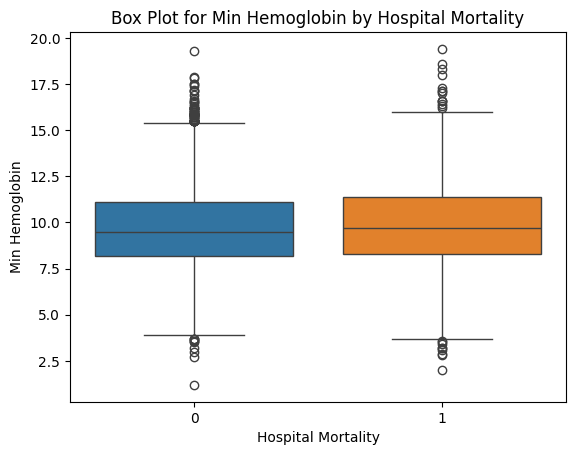

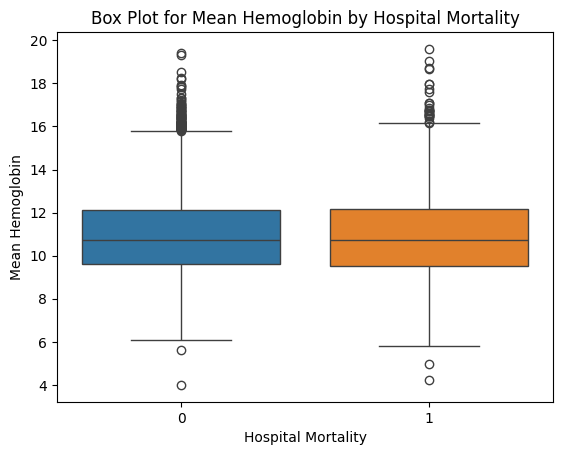

In [78]:
for column in cont_all_df.columns:
    if column != 'Hospital Mortality':
        sns.boxplot(x='Hospital Mortality', y=column, data=cont_all_df, hue='Hospital Mortality', legend=False)
        plt.title(f'Box Plot for {column} by Hospital Mortality')
        plt.show()

## Summary Table <a name='summary'>

### Summary Table for Statistical tests conducted

In [79]:
vital_signs = ['Max Heart Rate', 'Min Heart Rate', 'Mean Heart Rate', 'Max MAP', 'Min MAP', 'Mean MAP', 'Max Systolic Pressure', 'Min Systolic Pressure', 'Mean Systolic Pressure', 'Max Diastolic Pressure', 'Min Diastolic Pressure', 'Mean Diastolic Pressure', 'Max Temperature', 'Min Temperature', 'Mean Temperature']
demographic = ['Age', 'Gender']
diagnosis = ['Sepsis', 'Any Organ Failure', 'Severe Respiratory Failure', 'Severe Coagulation Failure', 'Severe Liver Failure', 'Severe Cardiovascular Failure', 'Severe Central Nervous System Failure', 'Severe Renal Failure', 'Respiratory Dysfunction', 'Cardiovascular Dysfunction', 'Renal Dysfunction', 'Hematologic Dysfunction', 'Metabolic Dysfunction', 'Neurologic Dysfunction']
severity = ['SAPS II', 'SOFA', 'OASIS']
lab = ['Max Lactate', 'Min Lactate', 'Mean Lactate', 'Max pH', 'Min pH', 'Mean pH', 'Max Glucose', 'Min Glucose', 'Mean Glucose', 'Max WBC', 'Min WBC', 'Mean WBC', 'Max BUN', 'Min BUN', 'Mean BUN', 'Max Creatinine', 'Min Creatinine', 'Mean Creatinine', 'Max Hemoglobin', 'Min Hemoglobin', 'Mean Hemoglobin']
history = ['Uncomplicated Hypertension', 'Complicated Hypertension', 'Uncomplicated Diabetes', 'Complicated Diabetes', 'Malignancy', 'Hematologic Disease', 'Metastasis', 'Peripheral Vascular Disease', 'Hypothyroidism', 'Chronic Heart Failure', 'Stroke', 'Liver Disease']
summary_of_tests = pd.DataFrame(result_dict)

def categorize_variable(variable):
    if variable in vital_signs:
        return 'Vital signs'
    elif variable in demographic:
        return 'Demographic'
    elif variable in diagnosis:
        return 'Diagnosis'
    elif variable in severity:
        return 'Severity'
    elif variable in lab:
        return 'Laboratory results'
    elif variable in history:
        return 'Medical history'
    else:
        return 'Other'

# Apply the function
summary_of_tests['Category'] = summary_of_tests['Variable'].apply(categorize_variable)
summary_of_tests.insert(1, 'Category', summary_of_tests.pop('Category'))
summary_of_tests.sort_values(by='Category', inplace=True)
# summary_of_tests['P-value'] = round(summary_of_tests['P-value'], 5)
print(summary_of_tests)
# print(type(summary_of_tests['P-value']))

                                 Variable            Category    Data_Type  \
40                                 Gender         Demographic  Categorical   
8                                     Age         Demographic   Continuous   
66                 Neurologic Dysfunction           Diagnosis  Categorical   
65                  Metabolic Dysfunction           Diagnosis  Categorical   
53                                 Sepsis           Diagnosis  Categorical   
55             Severe Respiratory Failure           Diagnosis  Categorical   
56             Severe Coagulation Failure           Diagnosis  Categorical   
57                   Severe Liver Failure           Diagnosis  Categorical   
54                      Any Organ Failure           Diagnosis  Categorical   
59  Severe Central Nervous System Failure           Diagnosis  Categorical   
60                   Severe Renal Failure           Diagnosis  Categorical   
61                Respiratory Dysfunction           Diagnosis  C

In [80]:
summary_of_tests['Category'].value_counts()

Laboratory results    21
Vital signs           15
Diagnosis             14
Medical history       12
Severity               3
Demographic            2
Name: Category, dtype: int64

In [81]:


# Export the DataFrame to an Excel file
summary_of_tests.to_excel('summary_of_tests.xlsx', index=False)
